<a href="https://colab.research.google.com/github/tomorn112/ZC-DINO-ER/blob/part3/CLIPzeroHen.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Griding 50x50 pixels to find crack patterns
# Paths to the test directories on Google Drive
test_crack_dir = "/content/drive/My Drive/IEEE_Access/Egg/test_ref1/test/crack/"
test_intact_dir = "/content/drive/My Drive/IEEE_Access/Egg/test_ref1/test/intact_aug/"

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
!nvidia-smi

Wed Mar 26 02:57:40 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   32C    P0             47W /  400W |       0MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

## Load images

In [ ]:
!pip install git+https://github.com/openai/CLIP.git
!pip install torch torchvision


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-m3d_8dgr
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-m3d_8dgr
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 96.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 87.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 39.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━

#Measure Model paramete count, inference time , latency, FPS , memory usage , cpu gpu usage

100%|████████████████████████████████████████| 335M/335M [00:02<00:00, 155MiB/s]


Total Model Parameters: 149,620,737


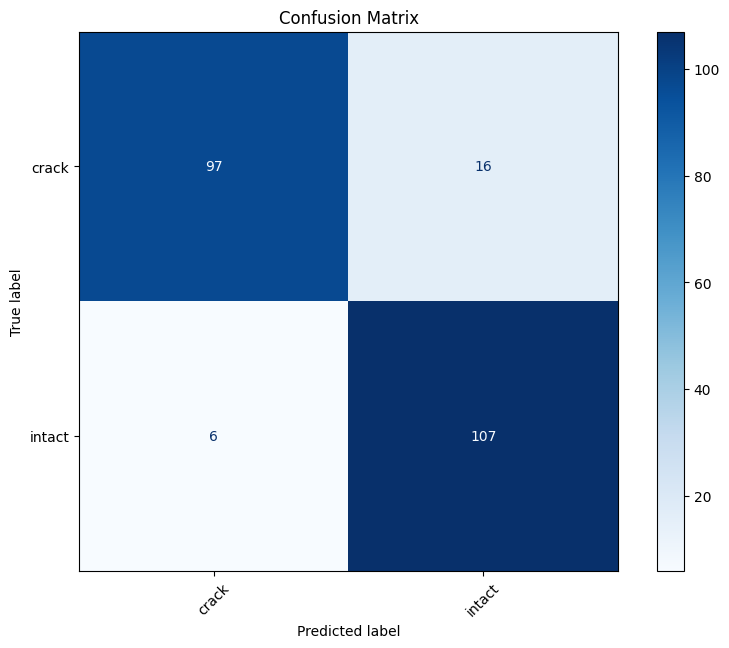


Classification Report:

              precision    recall  f1-score   support

       crack       0.94      0.86      0.90       113
      intact       0.87      0.95      0.91       113

    accuracy                           0.90       226
   macro avg       0.91      0.90      0.90       226
weighted avg       0.91      0.90      0.90       226


--- Performance Metrics ---
Total Model Parameters: 149,620,737
Inference Time: 15.2896 seconds
Frames Per Second (FPS): 14.78
CPU Usage Before: 7.20%, After: 7.00%
RAM Usage Increase: 0.0588 GB
GPU Memory Increase: 0.0086 GB
GPU Utilization Increase: 0.00%

--- Model Evaluation ---
Accuracy: 0.9027
Precision: 0.9058
Recall: 0.9027
F1 Score: 0.9025


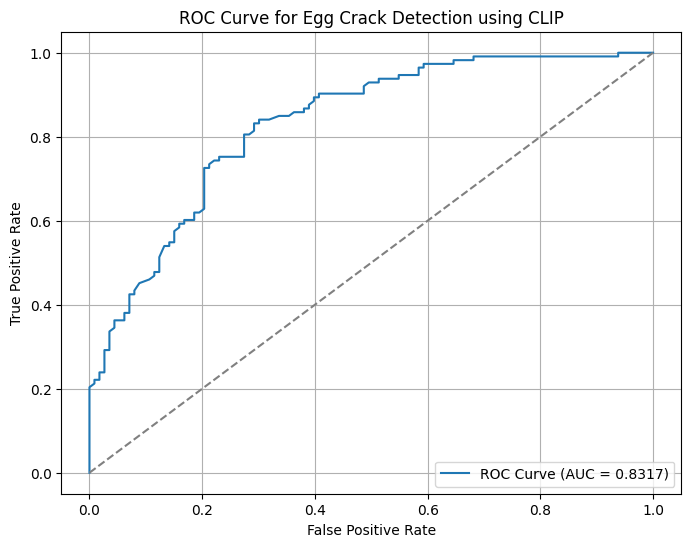

In [ ]:
import os
import torch
import clip
import time
import psutil
import pynvml  # NVIDIA GPU tracking
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score,
    precision_score, recall_score, f1_score, roc_auc_score, roc_curve
)

# Check if CUDA is available and use it, otherwise use CPU
device = "cuda" if torch.cuda.is_available() else "cpu"

# Load the CLIP model
clip_model, preprocess = clip.load("ViT-B/16", device=device)

# Count the number of parameters in the CLIP model
total_params = sum(p.numel() for p in clip_model.parameters())
print(f"Total Model Parameters: {total_params:,}")

# Define text descriptions
text_descriptions_crack = [
    "an egg that has a visible crack like a thin line",
    "an egg with a clearly cracked shell that looks like a thin line",
    "an egg that is visibly cracked with a thin line",
    "an egg with an obvious thin line crack in its shell",
    "an egg that has a hole",
    "an egg with many edge cracks on its skin",
    "an egg with a broken shell",
    "an egg that is damaged with cracks"
]

text_descriptions_intact = [
    "an egg that is completely intact with no cracks",
    "an egg with a perfect, uncracked shell",
    "an egg without any visible cracks",
    "an egg that is fully intact with no cracks",
    "an egg with a smooth and undamaged shell",
    "an egg that is in perfect condition",
    "an egg without any damage",
    "an egg with a flawless shell"
]

text_descriptions = text_descriptions_crack + text_descriptions_intact

# Encode text descriptions
text_inputs = clip.tokenize(text_descriptions).to(device)

# Define test directories
test_dirs = {
    "crack": "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/",
    "intact": "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/intact/"
}

# Lists to store true labels, predicted labels, and scores for ROC
true_labels = []
predicted_labels = []
predicted_scores = []

# Performance Tracking: Start
cpu_usage_before = psutil.cpu_percent(interval=1)
ram_usage_before = psutil.virtual_memory().used / (1024 ** 3)  # Convert bytes to GB

if torch.cuda.is_available():
    pynvml.nvmlInit()
    handle = pynvml.nvmlDeviceGetHandleByIndex(0)
    gpu_mem_before = torch.cuda.memory_allocated(device) / (1024 ** 3)
    gpu_util_before = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
else:
    gpu_mem_before, gpu_util_before = 0, 0

# Start Timing
start_time = time.time()

# Function to preprocess an image
def preprocess_image(image_path):
    image = preprocess(Image.open(image_path)).unsqueeze(0).to(device)
    return image

# Iterate through all images in both directories
for label, directory in test_dirs.items():
    for filename in os.listdir(directory):
        if filename.endswith((".png", ".jpg", ".jpeg")):
            image_path = os.path.join(directory, filename)

            # Load and preprocess the test image
            test_image = preprocess_image(image_path)

            # Encode the image and text descriptions
            with torch.no_grad():
                image_features = clip_model.encode_image(test_image)
                text_features = clip_model.encode_text(text_inputs)

            # Compute similarity scores
            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)
            similarity = (image_features @ text_features.T).cpu().numpy()

            # Determine the text description with the highest similarity score
            best_match_idx = similarity.argmax()
            best_match_text = text_descriptions[best_match_idx]

            # Append true and predicted labels
            true_labels.append(label)
            predicted_labels.append("crack" if best_match_text in text_descriptions_crack else "intact")

            # Save crack similarity score for ROC
            crack_score = similarity[0, :len(text_descriptions_crack)].max()
            predicted_scores.append(crack_score)

# End Timing
end_time = time.time()
inference_time = end_time - start_time
num_images = len(true_labels)
fps = num_images / inference_time if inference_time > 0 else float('inf')

# Performance Tracking: End
cpu_usage_after = psutil.cpu_percent(interval=1)
ram_usage_after = psutil.virtual_memory().used / (1024 ** 3)
ram_usage_diff = ram_usage_after - ram_usage_before

if torch.cuda.is_available():
    gpu_mem_after = torch.cuda.memory_allocated(device) / (1024 ** 3)
    gpu_util_after = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
    gpu_mem_diff = gpu_mem_after - gpu_mem_before
    gpu_util_diff = gpu_util_after - gpu_util_before
else:
    gpu_mem_diff, gpu_util_diff = 0, 0

# Compute confusion matrix
cm = confusion_matrix(true_labels, predicted_labels, labels=["crack", "intact"])
cm_display = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["crack", "intact"])

# Plot confusion matrix
fig, ax = plt.subplots(figsize=(10, 7))
cm_display.plot(ax=ax, cmap="Blues", xticks_rotation=45)
plt.title("Confusion Matrix")
plt.show()

# Print classification report
print("\nClassification Report:\n")
print(classification_report(true_labels, predicted_labels, target_names=["crack", "intact"], zero_division=0))

# Calculate and print additional metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='weighted', zero_division=0)
recall = recall_score(true_labels, predicted_labels, average='weighted')
f1 = f1_score(true_labels, predicted_labels, average='weighted')

print("\n--- Performance Metrics ---")
print(f"Total Model Parameters: {total_params:,}")
print(f"Inference Time: {inference_time:.4f} seconds")
print(f"Frames Per Second (FPS): {fps:.2f}")
print(f"CPU Usage Before: {cpu_usage_before:.2f}%, After: {cpu_usage_after:.2f}%")
print(f"RAM Usage Increase: {ram_usage_diff:.4f} GB")
print(f"GPU Memory Increase: {gpu_mem_diff:.4f} GB")
print(f"GPU Utilization Increase: {gpu_util_diff:.2f}%")

print("\n--- Model Evaluation ---")
print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

# ROC-AUC Calculation
true_binary = [1 if label == "crack" else 0 for label in true_labels]
roc_auc = roc_auc_score(true_binary, predicted_scores)
fpr, tpr, thresholds = roc_curve(true_binary, predicted_scores)

# Plot ROC Curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {roc_auc:.4f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Egg Crack Detection using CLIP')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

# Cleanup GPU tracking
if torch.cuda.is_available():
    pynvml.nvmlShutdown()


100%|███████████████████████████████████████| 335M/335M [00:08<00:00, 42.3MiB/s]


Total Model Parameters: 149,620,737

===== Testing Split: 30% =====


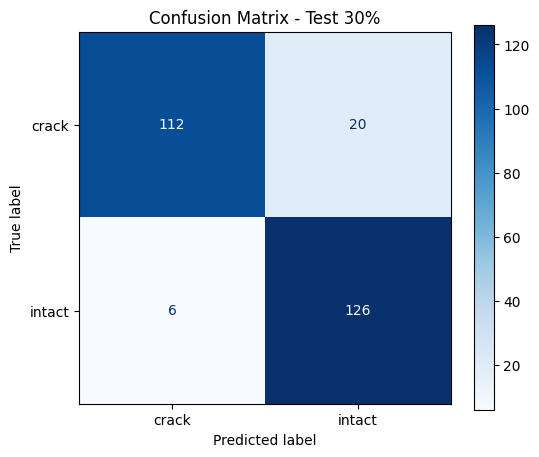


Classification Report:
              precision    recall  f1-score   support

       crack       0.95      0.85      0.90       132
      intact       0.86      0.95      0.91       132

    accuracy                           0.90       264
   macro avg       0.91      0.90      0.90       264
weighted avg       0.91      0.90      0.90       264


--- Performance ---
Accuracy:  0.9015
Precision: 0.9061
Recall:    0.9015
F1 Score:  0.9012
Inference Time: 127.38s | FPS: 2.07
CPU Usage: Before 9.5% -> After 0.3%
RAM Usage Increase: 0.167 GB
GPU Mem Increase: 0.009 GB | GPU Util: +0.0%

===== Testing Split: 50% =====


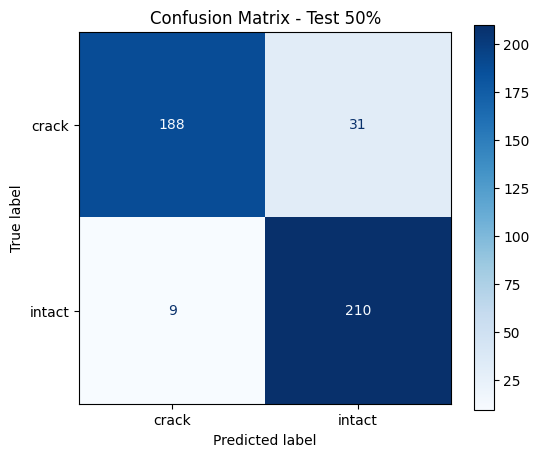


Classification Report:
              precision    recall  f1-score   support

       crack       0.95      0.86      0.90       219
      intact       0.87      0.96      0.91       219

    accuracy                           0.91       438
   macro avg       0.91      0.91      0.91       438
weighted avg       0.91      0.91      0.91       438


--- Performance ---
Accuracy:  0.9087
Precision: 0.9128
Recall:    0.9087
F1 Score:  0.9084
Inference Time: 84.61s | FPS: 5.18
CPU Usage: Before 0.3% -> After 9.3%
RAM Usage Increase: 0.009 GB
GPU Mem Increase: 0.000 GB | GPU Util: +0.0%

===== Testing Split: 70% =====


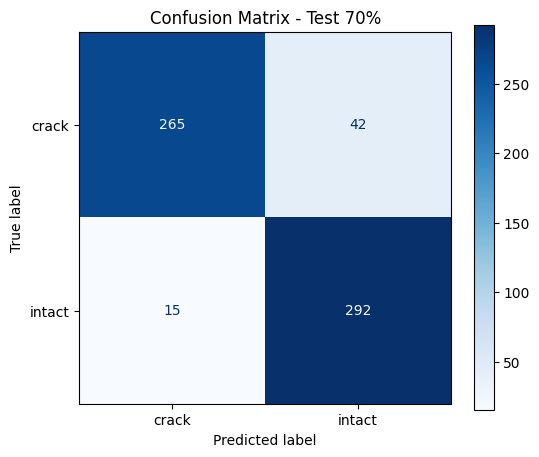


Classification Report:
              precision    recall  f1-score   support

       crack       0.95      0.86      0.90       307
      intact       0.87      0.95      0.91       307

    accuracy                           0.91       614
   macro avg       0.91      0.91      0.91       614
weighted avg       0.91      0.91      0.91       614


--- Performance ---
Accuracy:  0.9072
Precision: 0.9103
Recall:    0.9072
F1 Score:  0.9070
Inference Time: 94.96s | FPS: 6.47
CPU Usage: Before 6.8% -> After 9.7%
RAM Usage Increase: -0.007 GB
GPU Mem Increase: 0.000 GB | GPU Util: +0.0%

===== Testing Split: 80% =====


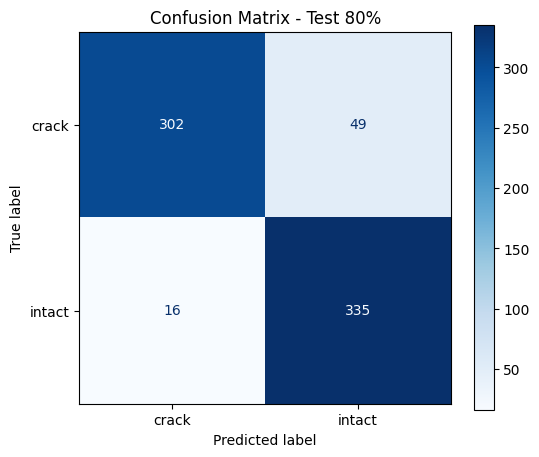


Classification Report:
              precision    recall  f1-score   support

       crack       0.95      0.86      0.90       351
      intact       0.87      0.95      0.91       351

    accuracy                           0.91       702
   macro avg       0.91      0.91      0.91       702
weighted avg       0.91      0.91      0.91       702


--- Performance ---
Accuracy:  0.9074
Precision: 0.9110
Recall:    0.9074
F1 Score:  0.9072
Inference Time: 53.90s | FPS: 13.02
CPU Usage: Before 0.3% -> After 0.4%
RAM Usage Increase: -0.039 GB
GPU Mem Increase: 0.000 GB | GPU Util: +0.0%


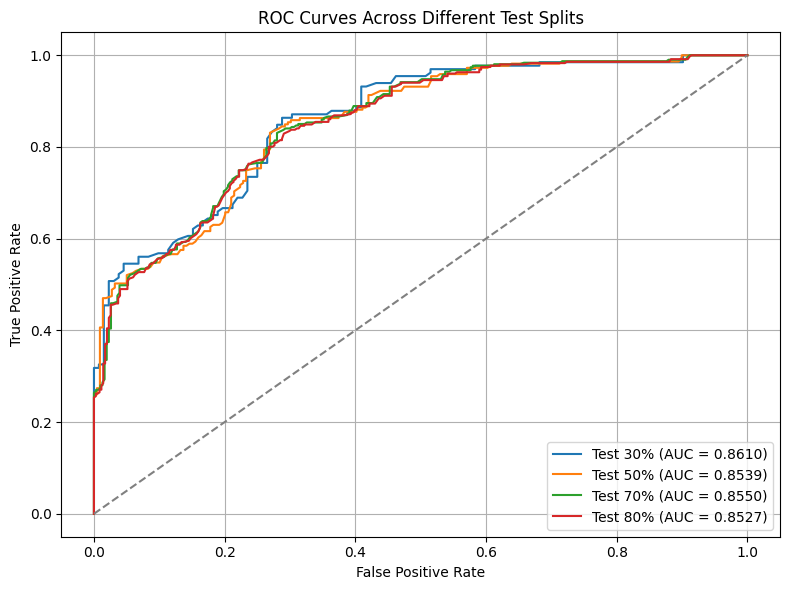

In [ ]:
import os
import random
import torch
import clip
import time
import psutil
import pynvml
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score,
    precision_score, recall_score, f1_score, roc_auc_score, roc_curve
)
from sklearn.model_selection import train_test_split

# Check device
device = "cuda" if torch.cuda.is_available() else "cpu"

# Load CLIP
clip_model, preprocess = clip.load("ViT-B/16", device=device)
total_params = sum(p.numel() for p in clip_model.parameters())
print(f"Total Model Parameters: {total_params:,}")

# Text prompts
text_descriptions_crack = [
    "an egg that has a visible crack like a thin line",
    "an egg with a clearly cracked shell that looks like a thin line",
    "an egg that is visibly cracked with a thin line",
    "an egg with an obvious thin line crack in its shell",
    "an egg that has a hole",
    "an egg with many edge cracks on its skin",
    "an egg with a broken shell",
    "an egg that is damaged with cracks"
]

text_descriptions_intact = [
    "an egg that is completely intact with no cracks",
    "an egg with a perfect, uncracked shell",
    "an egg without any visible cracks",
    "an egg that is fully intact with no cracks",
    "an egg with a smooth and undamaged shell",
    "an egg that is in perfect condition",
    "an egg without any damage",
    "an egg with a flawless shell"
]

text_descriptions = text_descriptions_crack + text_descriptions_intact
text_inputs = clip.tokenize(text_descriptions).to(device)

# Crack and intact directories
dir_crack = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/train/crack/c435"
dir_intact = "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/train/intact/i421"

# Gather and shuffle image paths
crack_images = [os.path.join(dir_crack, f) for f in os.listdir(dir_crack) if f.lower().endswith((".jpg", ".jpeg", ".png"))]
intact_images = [os.path.join(dir_intact, f) for f in os.listdir(dir_intact) if f.lower().endswith((".jpg", ".jpeg", ".png"))]

# Ensure balanced datasets
min_samples = min(len(crack_images), len(intact_images))
crack_images = random.sample(crack_images, min_samples)
intact_images = random.sample(intact_images, min_samples)

# Define testing ratios
test_ratios = [0.3, 0.5, 0.7, 0.8]

# Function to preprocess
def preprocess_image(image_path):
    image = preprocess(Image.open(image_path)).unsqueeze(0).to(device)
    return image

# Store ROC data for all conditions
roc_data = []

# Evaluation loop
for ratio in test_ratios:
    print(f"\n===== Testing Split: {int(ratio * 100)}% =====")

    # Create balanced train-test split
    crack_train, crack_test = train_test_split(crack_images, test_size=ratio, random_state=42)
    intact_train, intact_test = train_test_split(intact_images, test_size=ratio, random_state=42)

    test_data = [(img, "crack") for img in crack_test] + [(img, "intact") for img in intact_test]
    random.shuffle(test_data)

    true_labels = []
    predicted_labels = []
    predicted_scores = []

    # Start timing and GPU tracking
    cpu_usage_before = psutil.cpu_percent(interval=1)
    ram_usage_before = psutil.virtual_memory().used / (1024 ** 3)

    if torch.cuda.is_available():
        pynvml.nvmlInit()
        handle = pynvml.nvmlDeviceGetHandleByIndex(0)
        gpu_mem_before = torch.cuda.memory_allocated(device) / (1024 ** 3)
        gpu_util_before = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
    else:
        gpu_mem_before, gpu_util_before = 0, 0

    start_time = time.time()

    for image_path, label in test_data:
        test_image = preprocess_image(image_path)

        with torch.no_grad():
            image_features = clip_model.encode_image(test_image)
            text_features = clip_model.encode_text(text_inputs)

        image_features /= image_features.norm(dim=-1, keepdim=True)
        text_features /= text_features.norm(dim=-1, keepdim=True)
        similarity = (image_features @ text_features.T).cpu().numpy()

        best_match_idx = similarity.argmax()
        best_match_text = text_descriptions[best_match_idx]

        true_labels.append(label)
        predicted_labels.append("crack" if best_match_text in text_descriptions_crack else "intact")

        # Save crack score for ROC
        crack_score = similarity[0, :len(text_descriptions_crack)].max()
        predicted_scores.append(crack_score)

    # End timing and metrics
    end_time = time.time()
    inference_time = end_time - start_time
    fps = len(true_labels) / inference_time if inference_time > 0 else float("inf")

    cpu_usage_after = psutil.cpu_percent(interval=1)
    ram_usage_after = psutil.virtual_memory().used / (1024 ** 3)
    ram_diff = ram_usage_after - ram_usage_before

    if torch.cuda.is_available():
        gpu_mem_after = torch.cuda.memory_allocated(device) / (1024 ** 3)
        gpu_util_after = pynvml.nvmlDeviceGetUtilizationRates(handle).gpu
        gpu_mem_diff = gpu_mem_after - gpu_mem_before
        gpu_util_diff = gpu_util_after - gpu_util_before
    else:
        gpu_mem_diff, gpu_util_diff = 0, 0

    # Evaluation
    cm = confusion_matrix(true_labels, predicted_labels, labels=["crack", "intact"])
    fig, ax = plt.subplots(figsize=(6, 5))
    ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["crack", "intact"]).plot(ax=ax, cmap="Blues")
    plt.title(f"Confusion Matrix - Test {int(ratio * 100)}%")
    plt.show()

    print("\nClassification Report:")
    print(classification_report(true_labels, predicted_labels, target_names=["crack", "intact"], zero_division=0))

    accuracy = accuracy_score(true_labels, predicted_labels)
    precision = precision_score(true_labels, predicted_labels, average='weighted', zero_division=0)
    recall = recall_score(true_labels, predicted_labels, average='weighted')
    f1 = f1_score(true_labels, predicted_labels, average='weighted')

    print("\n--- Performance ---")
    print(f"Accuracy:  {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall:    {recall:.4f}")
    print(f"F1 Score:  {f1:.4f}")
    print(f"Inference Time: {inference_time:.2f}s | FPS: {fps:.2f}")
    print(f"CPU Usage: Before {cpu_usage_before:.1f}% -> After {cpu_usage_after:.1f}%")
    print(f"RAM Usage Increase: {ram_diff:.3f} GB")
    print(f"GPU Mem Increase: {gpu_mem_diff:.3f} GB | GPU Util: +{gpu_util_diff:.1f}%")

    # AUC-ROC
    y_true = [1 if lbl == "crack" else 0 for lbl in true_labels]
    roc_auc = roc_auc_score(y_true, predicted_scores)
    fpr, tpr, _ = roc_curve(y_true, predicted_scores)

    # Save for global ROC plot
    roc_data.append((fpr, tpr, roc_auc, ratio))

    if torch.cuda.is_available():
        pynvml.nvmlShutdown()

# === Global ROC Plot ===
plt.figure(figsize=(8, 6))
for fpr, tpr, auc_val, ratio in roc_data:
    plt.plot(fpr, tpr, label=f'Test {int(ratio*100)}% (AUC = {auc_val:.4f})')

plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves Across Different Test Splits')
plt.legend(loc='lower right')
plt.grid(True)
plt.tight_layout()
plt.show()


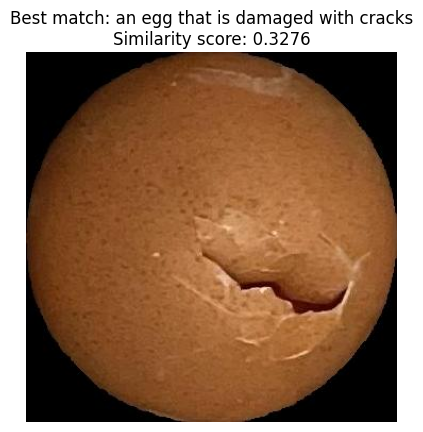

Image: maskegg_0_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.31005859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.298828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30419921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.302978515625
Description: an egg that has a hole, Similarity score: 0.30517578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.321533203125
Description: an egg with a broken shell, Similarity score: 0.302734375
Description: an egg that is damaged with cracks, Similarity score: 0.32763671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.286865234375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29443359375
Description: an egg without any visible cracks, Similarity score: 0.31982421875
Description

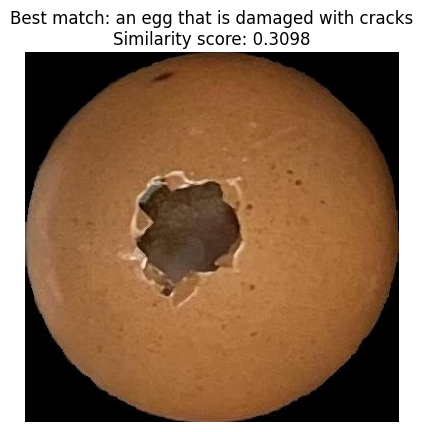

Image: maskegg_0_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.290283203125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28955078125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.292236328125
Description: an egg that has a hole, Similarity score: 0.290283203125
Description: an egg with many edge cracks on its skin, Similarity score: 0.308837890625
Description: an egg with a broken shell, Similarity score: 0.28466796875
Description: an egg that is damaged with cracks, Similarity score: 0.309814453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.25830078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26708984375
Description: an egg without any visible cracks, Similarity score: 0.300537109375
Descriptio

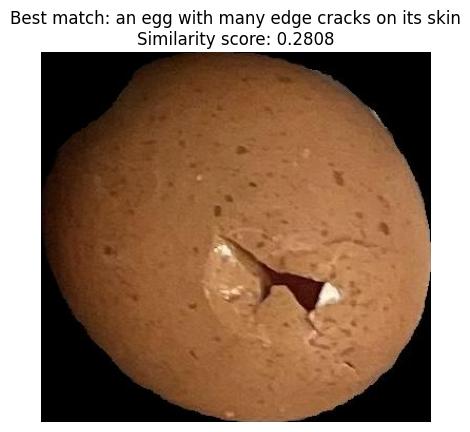

Image: maskegg_0_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.264404296875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2498779296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.260498046875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.267822265625
Description: an egg that has a hole, Similarity score: 0.26123046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.28076171875
Description: an egg with a broken shell, Similarity score: 0.257080078125
Description: an egg that is damaged with cracks, Similarity score: 0.2783203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.235107421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2427978515625
Description: an egg without any visible cracks, Similarity score: 0.27783203125
De

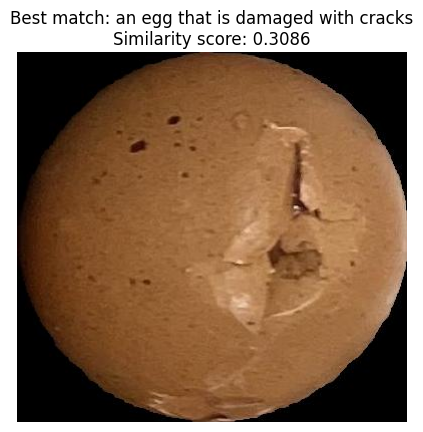

Image: maskegg_0_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2744140625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.273681640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.278564453125
Description: an egg that has a hole, Similarity score: 0.270751953125
Description: an egg with many edge cracks on its skin, Similarity score: 0.298828125
Description: an egg with a broken shell, Similarity score: 0.27685546875
Description: an egg that is damaged with cracks, Similarity score: 0.30859375
Description: an egg that is completely intact with no cracks, Similarity score: 0.25537109375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2646484375
Description: an egg without any visible cracks, Similarity score: 0.2919921875
Description: an egg 

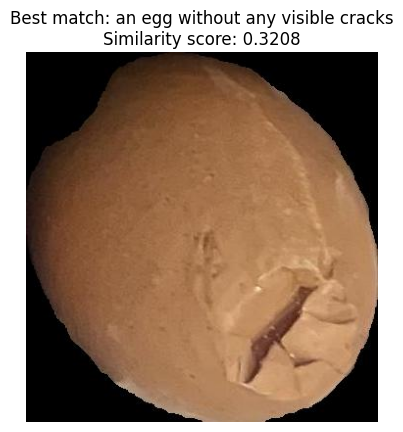

Image: maskegg_0_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29443359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.293701171875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.304443359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3095703125
Description: an egg that has a hole, Similarity score: 0.30224609375
Description: an egg with many edge cracks on its skin, Similarity score: 0.31591796875
Description: an egg with a broken shell, Similarity score: 0.3134765625
Description: an egg that is damaged with cracks, Similarity score: 0.319580078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.291259765625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.295166015625
Description: an egg without any visible cracks, Similarity score: 0.32080078125
Descrip

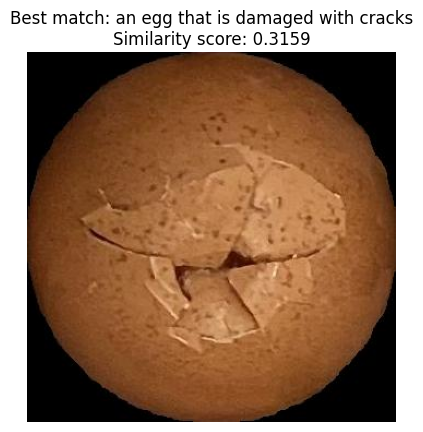

Image: maskegg_0_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.282958984375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28759765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.29150390625
Description: an egg that has a hole, Similarity score: 0.2841796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.311767578125
Description: an egg with a broken shell, Similarity score: 0.291015625
Description: an egg that is damaged with cracks, Similarity score: 0.31591796875
Description: an egg that is completely intact with no cracks, Similarity score: 0.268798828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.279052734375
Description: an egg without any visible cracks, Similarity score: 0.3076171875
Description: an 

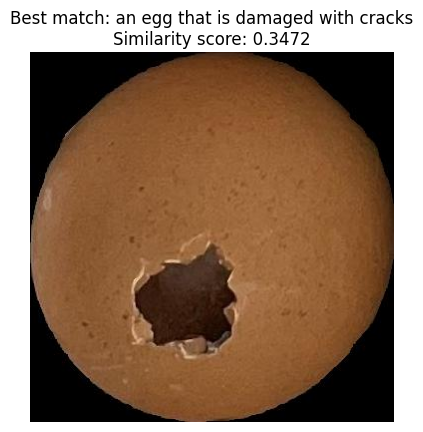

Image: maskegg_10_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.322509765625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.30908203125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31982421875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31689453125
Description: an egg that has a hole, Similarity score: 0.319091796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.344482421875
Description: an egg with a broken shell, Similarity score: 0.310546875
Description: an egg that is damaged with cracks, Similarity score: 0.34716796875
Description: an egg that is completely intact with no cracks, Similarity score: 0.289306640625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.293701171875
Description: an egg without any visible cracks, Similarity score: 0.33251953125
Descri

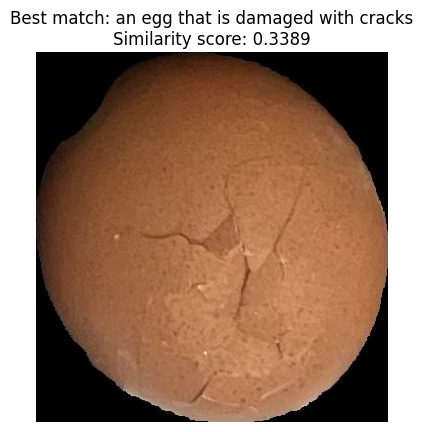

Image: maskegg_10_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.313232421875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.308349609375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.315185546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3095703125
Description: an egg that has a hole, Similarity score: 0.308837890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.334716796875
Description: an egg with a broken shell, Similarity score: 0.31298828125
Description: an egg that is damaged with cracks, Similarity score: 0.3388671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.295654296875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30078125
Description: an egg without any visible cracks, Similarity score: 0.335205078125
Descrip

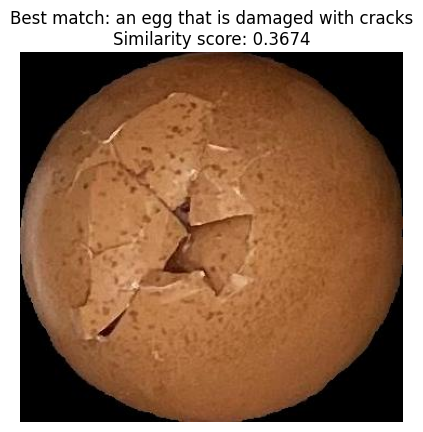

Image: maskegg_10_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.33349609375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.339111328125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.327880859375
Description: an egg that has a hole, Similarity score: 0.325439453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.354736328125
Description: an egg with a broken shell, Similarity score: 0.337158203125
Description: an egg that is damaged with cracks, Similarity score: 0.367431640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.3193359375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.323486328125
Description: an egg without any visible cracks, Similarity score: 0.343017578125
Descri

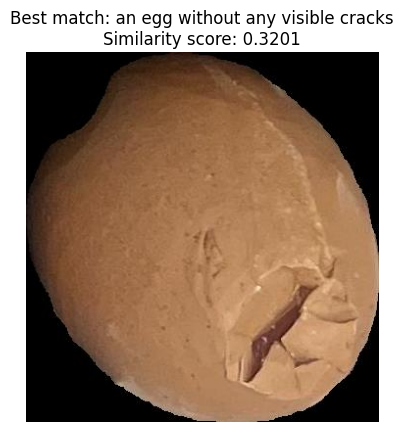

Image: maskegg_10_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29638671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.296142578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.304443359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.310302734375
Description: an egg that has a hole, Similarity score: 0.3046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.31494140625
Description: an egg with a broken shell, Similarity score: 0.31494140625
Description: an egg that is damaged with cracks, Similarity score: 0.317138671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.288818359375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29736328125
Description: an egg without any visible cracks, Similarity score: 0.320068359375
Descrip

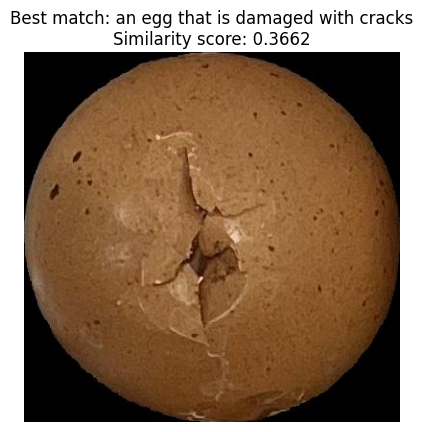

Image: maskegg_10_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.328857421875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.32177734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.33056640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.32421875
Description: an egg that has a hole, Similarity score: 0.322509765625
Description: an egg with many edge cracks on its skin, Similarity score: 0.34814453125
Description: an egg with a broken shell, Similarity score: 0.32861328125
Description: an egg that is damaged with cracks, Similarity score: 0.3662109375
Description: an egg that is completely intact with no cracks, Similarity score: 0.31103515625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.315673828125
Description: an egg without any visible cracks, Similarity score: 0.340576171875
Descripti

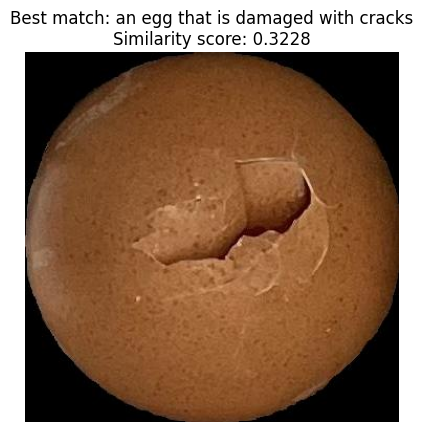

Image: maskegg_10_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2978515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.287353515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.293212890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.293701171875
Description: an egg that has a hole, Similarity score: 0.294189453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.3125
Description: an egg with a broken shell, Similarity score: 0.29345703125
Description: an egg that is damaged with cracks, Similarity score: 0.32275390625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2783203125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.283447265625
Description: an egg without any visible cracks, Similarity score: 0.31201171875
Description: 

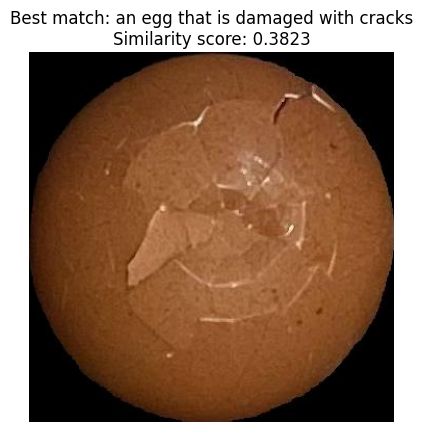

Image: maskegg_11_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.337646484375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.34375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.327880859375
Description: an egg that has a hole, Similarity score: 0.322265625
Description: an egg with many edge cracks on its skin, Similarity score: 0.360107421875
Description: an egg with a broken shell, Similarity score: 0.33837890625
Description: an egg that is damaged with cracks, Similarity score: 0.38232421875
Description: an egg that is completely intact with no cracks, Similarity score: 0.31884765625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.322998046875
Description: an egg without any visible cracks, Similarity score: 0.350341796875
Description: an 

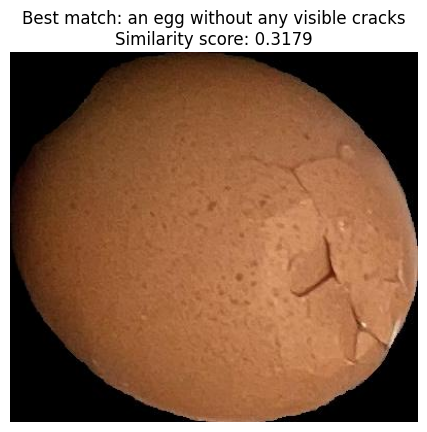

Image: maskegg_11_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.301025390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.299072265625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.297607421875
Description: an egg that has a hole, Similarity score: 0.29541015625
Description: an egg with many edge cracks on its skin, Similarity score: 0.31494140625
Description: an egg with a broken shell, Similarity score: 0.300537109375
Description: an egg that is damaged with cracks, Similarity score: 0.314453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.29150390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.302001953125
Description: an egg without any visible cracks, Similarity score: 0.31787109375
Description

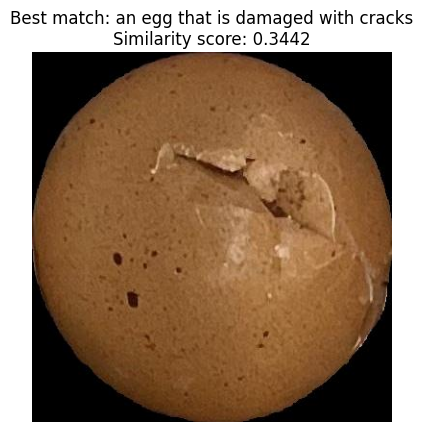

Image: maskegg_11_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.316650390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.310302734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.314697265625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30908203125
Description: an egg that has a hole, Similarity score: 0.31103515625
Description: an egg with many edge cracks on its skin, Similarity score: 0.330810546875
Description: an egg with a broken shell, Similarity score: 0.312255859375
Description: an egg that is damaged with cracks, Similarity score: 0.34423828125
Description: an egg that is completely intact with no cracks, Similarity score: 0.300048828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.302978515625
Description: an egg without any visible cracks, Similarity score: 0.329345703125
D

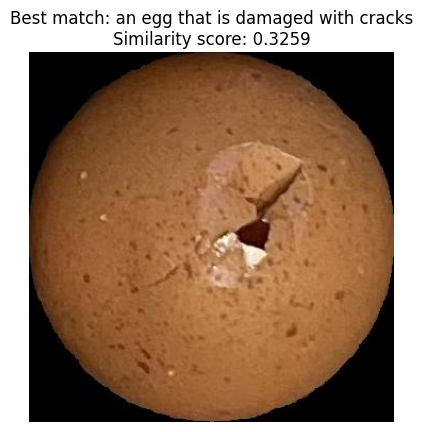

Image: maskegg_11_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.291015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27490234375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2919921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.296630859375
Description: an egg that has a hole, Similarity score: 0.30126953125
Description: an egg with many edge cracks on its skin, Similarity score: 0.31494140625
Description: an egg with a broken shell, Similarity score: 0.291259765625
Description: an egg that is damaged with cracks, Similarity score: 0.325927734375
Description: an egg that is completely intact with no cracks, Similarity score: 0.26513671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.270263671875
Description: an egg without any visible cracks, Similarity score: 0.305908203125
Descrip

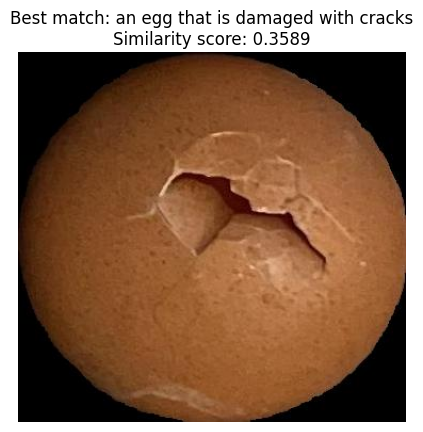

Image: maskegg_11_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.330810546875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.322265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.327880859375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.32177734375
Description: an egg that has a hole, Similarity score: 0.32421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.353271484375
Description: an egg with a broken shell, Similarity score: 0.326416015625
Description: an egg that is damaged with cracks, Similarity score: 0.35888671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.308837890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.31298828125
Description: an egg without any visible cracks, Similarity score: 0.338623046875
Descript

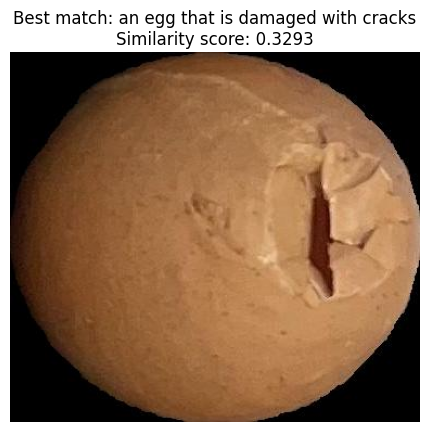

Image: maskegg_11_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.31005859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.310791015625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.310546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3173828125
Description: an egg that has a hole, Similarity score: 0.3115234375
Description: an egg with many edge cracks on its skin, Similarity score: 0.320068359375
Description: an egg with a broken shell, Similarity score: 0.322265625
Description: an egg that is damaged with cracks, Similarity score: 0.329345703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.300048828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.306884765625
Description: an egg without any visible cracks, Similarity score: 0.322265625
Description:

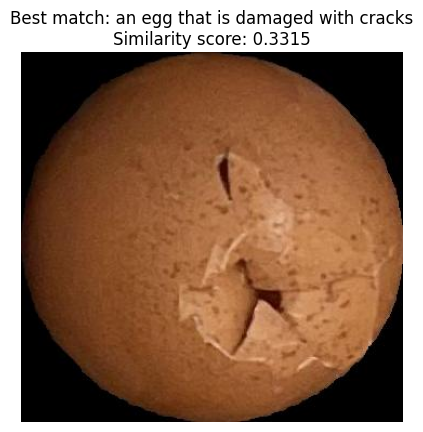

Image: maskegg_11_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3076171875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.30419921875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.304443359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30224609375
Description: an egg that has a hole, Similarity score: 0.298583984375
Description: an egg with many edge cracks on its skin, Similarity score: 0.322998046875
Description: an egg with a broken shell, Similarity score: 0.30517578125
Description: an egg that is damaged with cracks, Similarity score: 0.33154296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.285888671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29296875
Description: an egg without any visible cracks, Similarity score: 0.317138671875
Descript

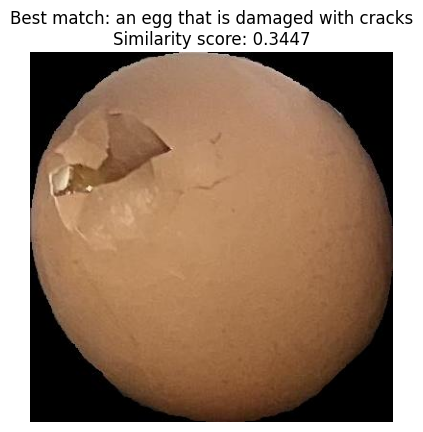

Image: maskegg_11_7.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3212890625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.317138671875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31884765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31396484375
Description: an egg that has a hole, Similarity score: 0.313232421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.336181640625
Description: an egg with a broken shell, Similarity score: 0.32177734375
Description: an egg that is damaged with cracks, Similarity score: 0.3447265625
Description: an egg that is completely intact with no cracks, Similarity score: 0.300537109375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3037109375
Description: an egg without any visible cracks, Similarity score: 0.328369140625
Descript

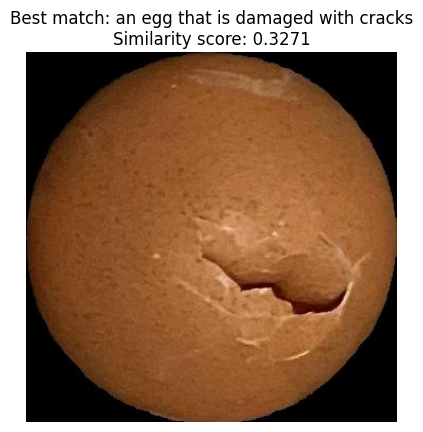

Image: maskegg_12_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3056640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.294921875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30224609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30322265625
Description: an egg that has a hole, Similarity score: 0.2998046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.322021484375
Description: an egg with a broken shell, Similarity score: 0.29736328125
Description: an egg that is damaged with cracks, Similarity score: 0.3271484375
Description: an egg that is completely intact with no cracks, Similarity score: 0.280517578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2890625
Description: an egg without any visible cracks, Similarity score: 0.3193359375
Description: an e

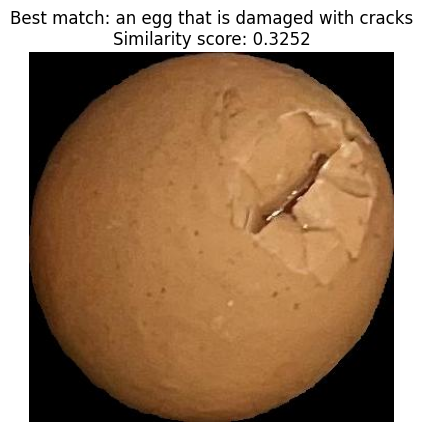

Image: maskegg_12_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.297119140625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.287841796875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29833984375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.298828125
Description: an egg that has a hole, Similarity score: 0.30224609375
Description: an egg with many edge cracks on its skin, Similarity score: 0.3134765625
Description: an egg with a broken shell, Similarity score: 0.30224609375
Description: an egg that is damaged with cracks, Similarity score: 0.3251953125
Description: an egg that is completely intact with no cracks, Similarity score: 0.285400390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.288330078125
Description: an egg without any visible cracks, Similarity score: 0.315673828125
Descript

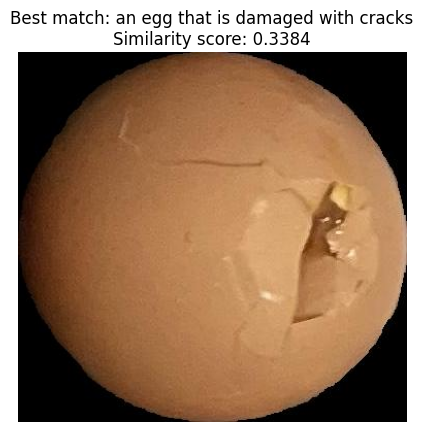

Image: maskegg_12_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.316162109375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.311279296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31298828125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.310546875
Description: an egg that has a hole, Similarity score: 0.30712890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.329345703125
Description: an egg with a broken shell, Similarity score: 0.320068359375
Description: an egg that is damaged with cracks, Similarity score: 0.33837890625
Description: an egg that is completely intact with no cracks, Similarity score: 0.293212890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30126953125
Description: an egg without any visible cracks, Similarity score: 0.321533203125
Descr

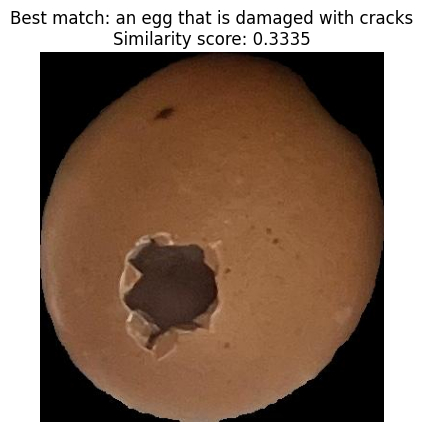

Image: maskegg_12_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.311767578125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.308837890625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.310791015625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.310791015625
Description: an egg that has a hole, Similarity score: 0.3203125
Description: an egg with many edge cracks on its skin, Similarity score: 0.33056640625
Description: an egg with a broken shell, Similarity score: 0.3134765625
Description: an egg that is damaged with cracks, Similarity score: 0.33349609375
Description: an egg that is completely intact with no cracks, Similarity score: 0.29345703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30029296875
Description: an egg without any visible cracks, Similarity score: 0.325439453125
Descripti

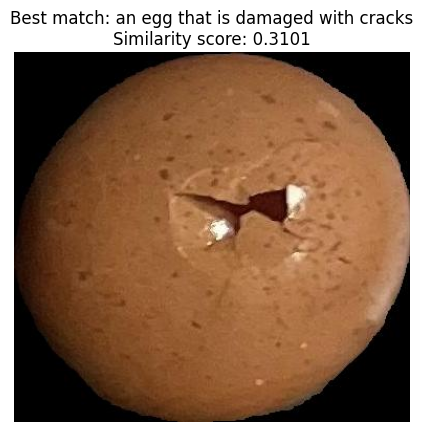

Image: maskegg_12_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29248046875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28369140625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.289794921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.293701171875
Description: an egg that has a hole, Similarity score: 0.2900390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.30517578125
Description: an egg with a broken shell, Similarity score: 0.290771484375
Description: an egg that is damaged with cracks, Similarity score: 0.31005859375
Description: an egg that is completely intact with no cracks, Similarity score: 0.268310546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27783203125
Description: an egg without any visible cracks, Similarity score: 0.301513671875
Descr

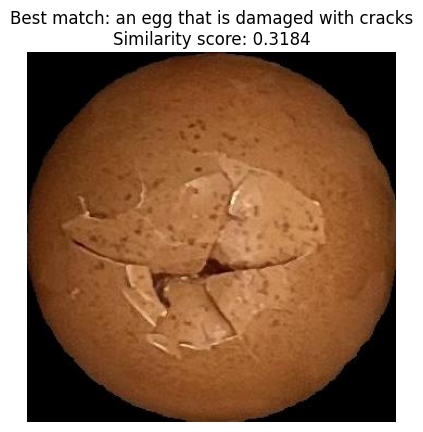

Image: maskegg_12_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.288818359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.296142578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.295654296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30224609375
Description: an egg that has a hole, Similarity score: 0.296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.31494140625
Description: an egg with a broken shell, Similarity score: 0.305908203125
Description: an egg that is damaged with cracks, Similarity score: 0.318359375
Description: an egg that is completely intact with no cracks, Similarity score: 0.284912109375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.294677734375
Description: an egg without any visible cracks, Similarity score: 0.31396484375
Descriptio

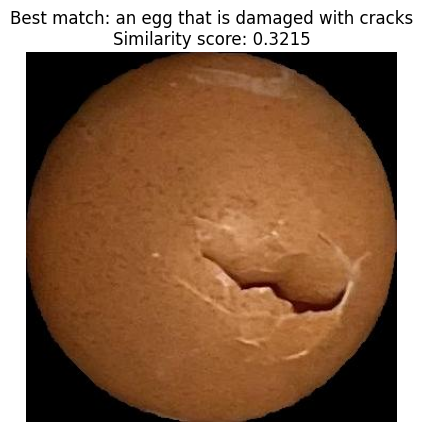

Image: maskegg_13_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2958984375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28564453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29443359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.296875
Description: an egg that has a hole, Similarity score: 0.29541015625
Description: an egg with many edge cracks on its skin, Similarity score: 0.318603515625
Description: an egg with a broken shell, Similarity score: 0.29345703125
Description: an egg that is damaged with cracks, Similarity score: 0.321533203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.27294921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.28173828125
Description: an egg without any visible cracks, Similarity score: 0.31298828125
Description: 

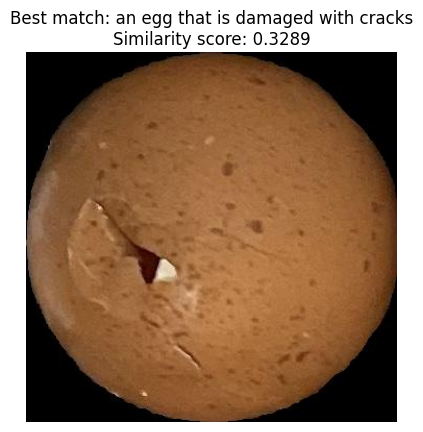

Image: maskegg_13_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.314453125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3056640625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31103515625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31201171875
Description: an egg that has a hole, Similarity score: 0.309814453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.321044921875
Description: an egg with a broken shell, Similarity score: 0.3017578125
Description: an egg that is damaged with cracks, Similarity score: 0.328857421875
Description: an egg that is completely intact with no cracks, Similarity score: 0.28564453125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.292236328125
Description: an egg without any visible cracks, Similarity score: 0.3203125
Description: 

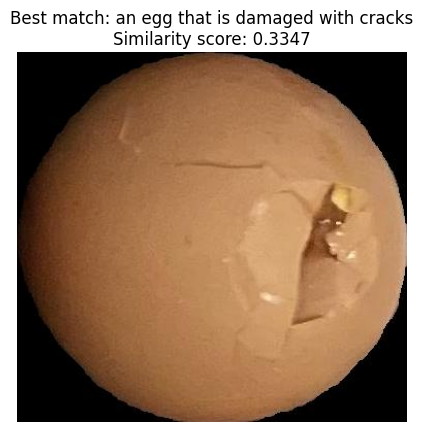

Image: maskegg_13_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.318359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3134765625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.314208984375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3095703125
Description: an egg that has a hole, Similarity score: 0.305908203125
Description: an egg with many edge cracks on its skin, Similarity score: 0.3291015625
Description: an egg with a broken shell, Similarity score: 0.3134765625
Description: an egg that is damaged with cracks, Similarity score: 0.334716796875
Description: an egg that is completely intact with no cracks, Similarity score: 0.295166015625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.301513671875
Description: an egg without any visible cracks, Similarity score: 0.32177734375
Descriptio

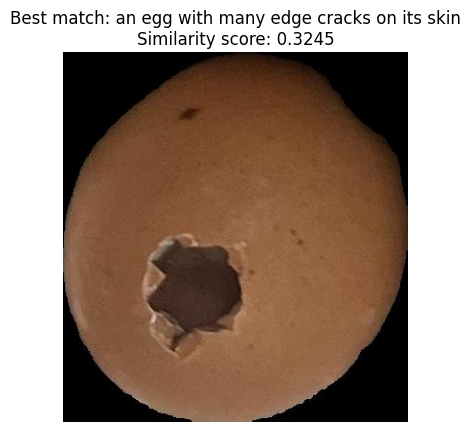

Image: maskegg_13_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.310546875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.309326171875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.308349609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.310302734375
Description: an egg that has a hole, Similarity score: 0.317626953125
Description: an egg with many edge cracks on its skin, Similarity score: 0.324462890625
Description: an egg with a broken shell, Similarity score: 0.308837890625
Description: an egg that is damaged with cracks, Similarity score: 0.320556640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2900390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.299560546875
Description: an egg without any visible cracks, Similarity score: 0.3212890625
Descr

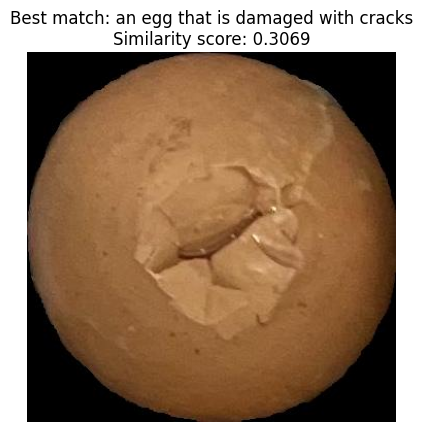

Image: maskegg_13_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.27490234375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.271240234375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.280517578125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.281982421875
Description: an egg that has a hole, Similarity score: 0.278564453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.295166015625
Description: an egg with a broken shell, Similarity score: 0.287353515625
Description: an egg that is damaged with cracks, Similarity score: 0.306884765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.272216796875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27490234375
Description: an egg without any visible cracks, Similarity score: 0.29931640625
D

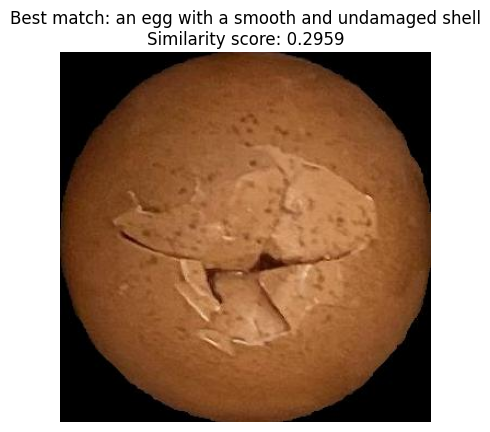

Image: maskegg_13_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.263671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.26318359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.27001953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2802734375
Description: an egg that has a hole, Similarity score: 0.27294921875
Description: an egg with many edge cracks on its skin, Similarity score: 0.2890625
Description: an egg with a broken shell, Similarity score: 0.2783203125
Description: an egg that is damaged with cracks, Similarity score: 0.29345703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.259521484375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.268310546875
Description: an egg without any visible cracks, Similarity score: 0.291748046875
Description: a

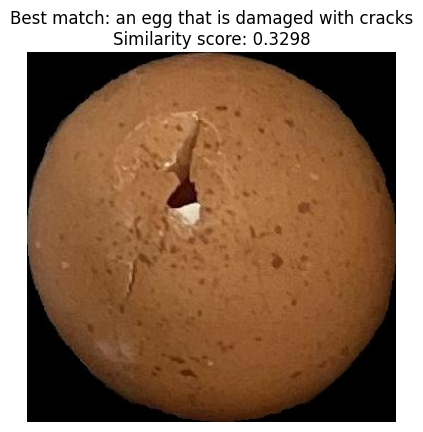

Image: maskegg_14_17.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.30908203125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.297607421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.308349609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.306396484375
Description: an egg that has a hole, Similarity score: 0.314697265625
Description: an egg with many edge cracks on its skin, Similarity score: 0.321044921875
Description: an egg with a broken shell, Similarity score: 0.306640625
Description: an egg that is damaged with cracks, Similarity score: 0.329833984375
Description: an egg that is completely intact with no cracks, Similarity score: 0.28173828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.292724609375
Description: an egg without any visible cracks, Similarity score: 0.315673828125
Des

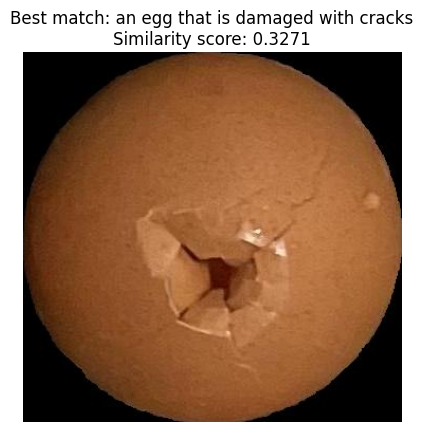

Image: maskegg_14_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.298095703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.285400390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.294677734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.291015625
Description: an egg that has a hole, Similarity score: 0.300048828125
Description: an egg with many edge cracks on its skin, Similarity score: 0.314208984375
Description: an egg with a broken shell, Similarity score: 0.295166015625
Description: an egg that is damaged with cracks, Similarity score: 0.3271484375
Description: an egg that is completely intact with no cracks, Similarity score: 0.27734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.28125
Description: an egg without any visible cracks, Similarity score: 0.309814453125
Description: a

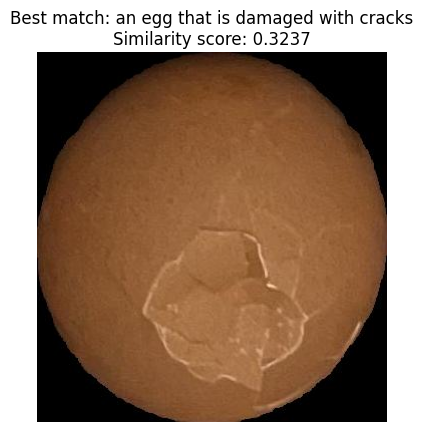

Image: maskegg_14_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2900390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2763671875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.293701171875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.288818359375
Description: an egg that has a hole, Similarity score: 0.284912109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.3173828125
Description: an egg with a broken shell, Similarity score: 0.28759765625
Description: an egg that is damaged with cracks, Similarity score: 0.32373046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.27294921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2763671875
Description: an egg without any visible cracks, Similarity score: 0.320068359375
Descripti

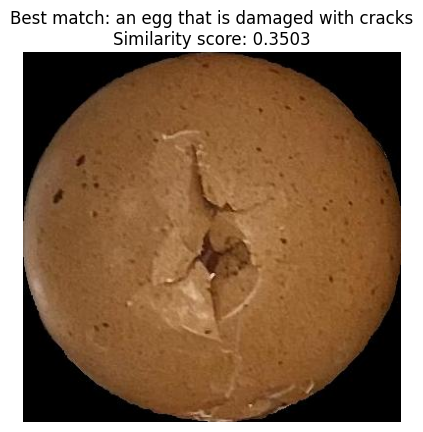

Image: maskegg_14_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3203125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.311767578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3203125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.319580078125
Description: an egg that has a hole, Similarity score: 0.3154296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.336181640625
Description: an egg with a broken shell, Similarity score: 0.316162109375
Description: an egg that is damaged with cracks, Similarity score: 0.350341796875
Description: an egg that is completely intact with no cracks, Similarity score: 0.30419921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30712890625
Description: an egg without any visible cracks, Similarity score: 0.33447265625
Description: 

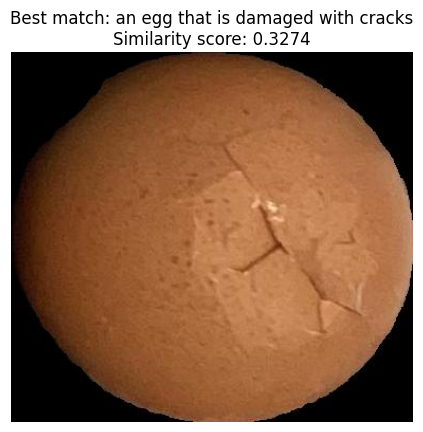

Image: maskegg_14_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.306396484375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.295654296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3076171875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30029296875
Description: an egg that has a hole, Similarity score: 0.297607421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.325927734375
Description: an egg with a broken shell, Similarity score: 0.299560546875
Description: an egg that is damaged with cracks, Similarity score: 0.327392578125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2841796875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.287109375
Description: an egg without any visible cracks, Similarity score: 0.322509765625
Descri

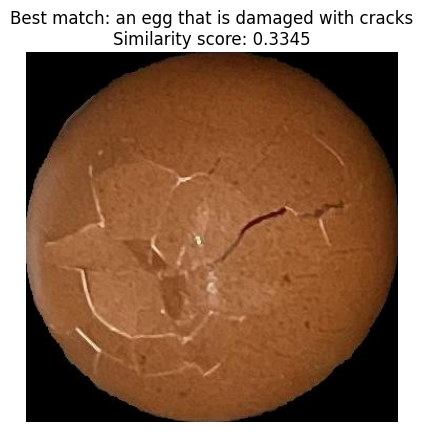

Image: maskegg_14_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3056640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.29296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3046875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2939453125
Description: an egg that has a hole, Similarity score: 0.293701171875
Description: an egg with many edge cracks on its skin, Similarity score: 0.322265625
Description: an egg with a broken shell, Similarity score: 0.297119140625
Description: an egg that is damaged with cracks, Similarity score: 0.33447265625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2822265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.285888671875
Description: an egg without any visible cracks, Similarity score: 0.316162109375
Description: an e

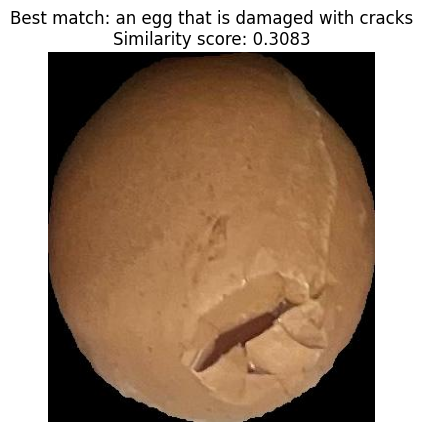

Image: maskegg_14_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.285888671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.284423828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2919921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.295654296875
Description: an egg that has a hole, Similarity score: 0.287841796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.303955078125
Description: an egg with a broken shell, Similarity score: 0.2998046875
Description: an egg that is damaged with cracks, Similarity score: 0.308349609375
Description: an egg that is completely intact with no cracks, Similarity score: 0.278076171875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.282958984375
Description: an egg without any visible cracks, Similarity score: 0.306884765625
De

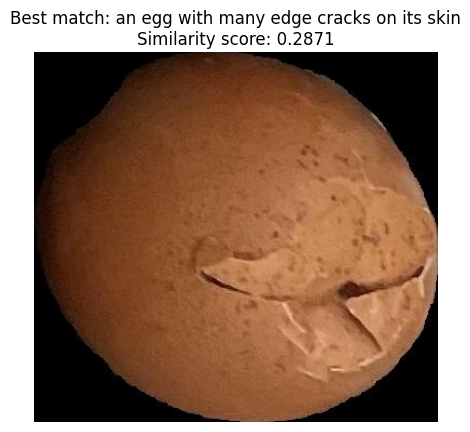

Image: maskegg_14_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.257080078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.25830078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.262939453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.27685546875
Description: an egg that has a hole, Similarity score: 0.265380859375
Description: an egg with many edge cracks on its skin, Similarity score: 0.287109375
Description: an egg with a broken shell, Similarity score: 0.28125
Description: an egg that is damaged with cracks, Similarity score: 0.280029296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.24462890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.260498046875
Description: an egg without any visible cracks, Similarity score: 0.287109375
Description: a

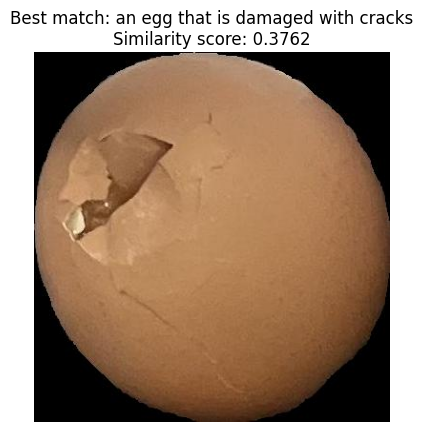

Image: maskegg_14_5.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.35400390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.350830078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.35302734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.340576171875
Description: an egg that has a hole, Similarity score: 0.342529296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.36669921875
Description: an egg with a broken shell, Similarity score: 0.350830078125
Description: an egg that is damaged with cracks, Similarity score: 0.376220703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.330810546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.33154296875
Description: an egg without any visible cracks, Similarity score: 0.35791015625
Desc

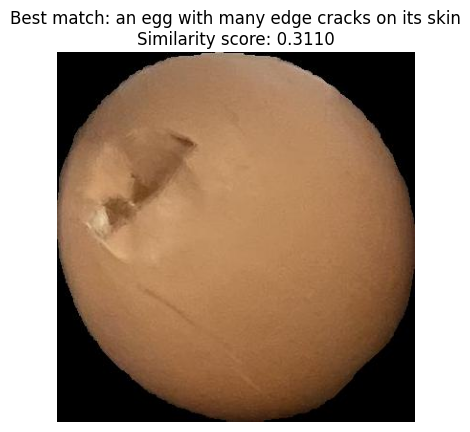

Image: maskegg_15_1.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29052734375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28369140625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.290283203125
Description: an egg that has a hole, Similarity score: 0.283935546875
Description: an egg with many edge cracks on its skin, Similarity score: 0.31103515625
Description: an egg with a broken shell, Similarity score: 0.291015625
Description: an egg that is damaged with cracks, Similarity score: 0.30908203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.26708984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2763671875
Description: an egg without any visible cracks, Similarity score: 0.3056640625
Description: an 

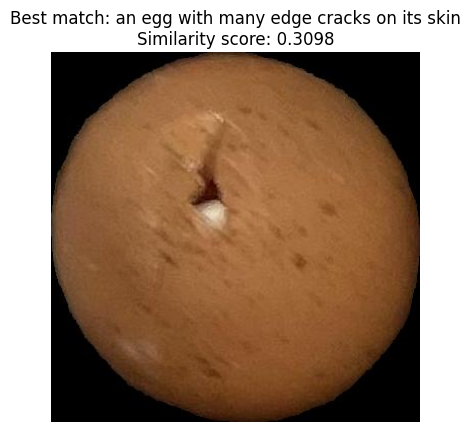

Image: maskegg_15_19.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.282470703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.262939453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.280029296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2880859375
Description: an egg that has a hole, Similarity score: 0.288818359375
Description: an egg with many edge cracks on its skin, Similarity score: 0.309814453125
Description: an egg with a broken shell, Similarity score: 0.27197265625
Description: an egg that is damaged with cracks, Similarity score: 0.302001953125
Description: an egg that is completely intact with no cracks, Similarity score: 0.249267578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26318359375
Description: an egg without any visible cracks, Similarity score: 0.299560546875
De

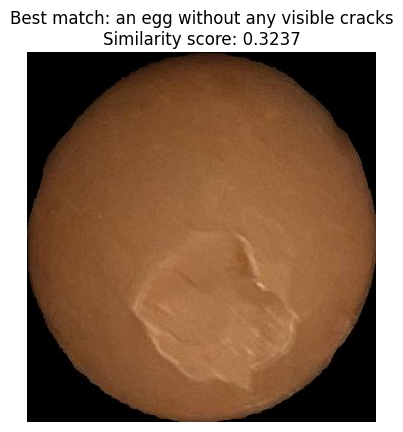

Image: maskegg_15_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.298095703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2841796875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.298583984375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.296142578125
Description: an egg that has a hole, Similarity score: 0.293212890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.314453125
Description: an egg with a broken shell, Similarity score: 0.2939453125
Description: an egg that is damaged with cracks, Similarity score: 0.316162109375
Description: an egg that is completely intact with no cracks, Similarity score: 0.279541015625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2861328125
Description: an egg without any visible cracks, Similarity score: 0.32373046875
Descript

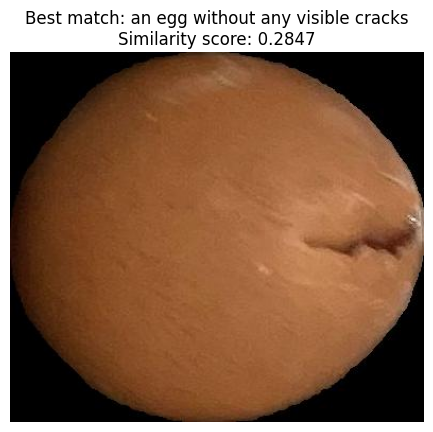

Image: maskegg_15_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.268798828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.252685546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.268310546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.276611328125
Description: an egg that has a hole, Similarity score: 0.27294921875
Description: an egg with many edge cracks on its skin, Similarity score: 0.282958984375
Description: an egg with a broken shell, Similarity score: 0.267822265625
Description: an egg that is damaged with cracks, Similarity score: 0.268310546875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2403564453125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.260986328125
Description: an egg without any visible cracks, Similarity score: 0.28466796875

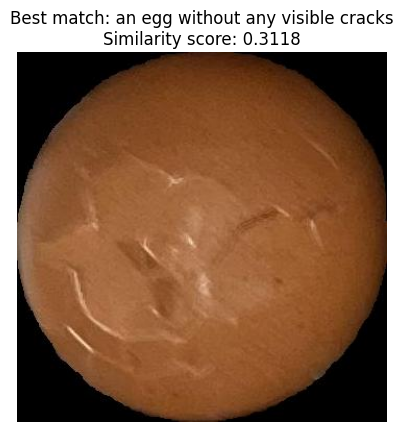

Image: maskegg_15_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28466796875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27587890625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28662109375
Description: an egg that has a hole, Similarity score: 0.27685546875
Description: an egg with many edge cracks on its skin, Similarity score: 0.303955078125
Description: an egg with a broken shell, Similarity score: 0.281982421875
Description: an egg that is damaged with cracks, Similarity score: 0.30224609375
Description: an egg that is completely intact with no cracks, Similarity score: 0.269775390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.276123046875
Description: an egg without any visible cracks, Similarity score: 0.311767578125
Descript

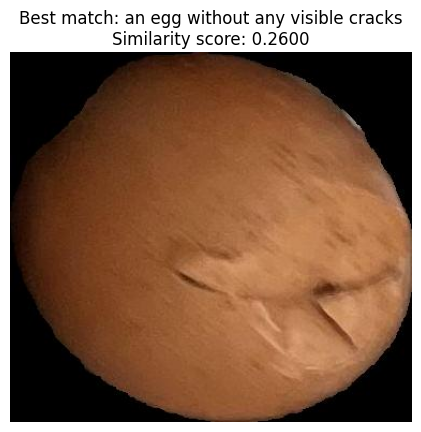

Image: maskegg_15_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2340087890625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.225830078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.239990234375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2449951171875
Description: an egg that has a hole, Similarity score: 0.2318115234375
Description: an egg with many edge cracks on its skin, Similarity score: 0.256103515625
Description: an egg with a broken shell, Similarity score: 0.2442626953125
Description: an egg that is damaged with cracks, Similarity score: 0.244384765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2147216796875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2275390625
Description: an egg without any visible cracks, Similarity score: 0.26000976

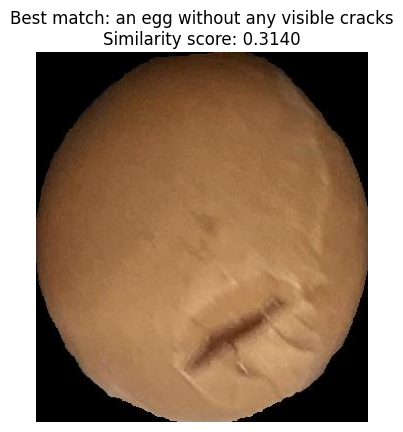

Image: maskegg_15_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2880859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.281982421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.294189453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30029296875
Description: an egg that has a hole, Similarity score: 0.2861328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.309814453125
Description: an egg with a broken shell, Similarity score: 0.299560546875
Description: an egg that is damaged with cracks, Similarity score: 0.309326171875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2763671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.281005859375
Description: an egg without any visible cracks, Similarity score: 0.31396484375
Descri

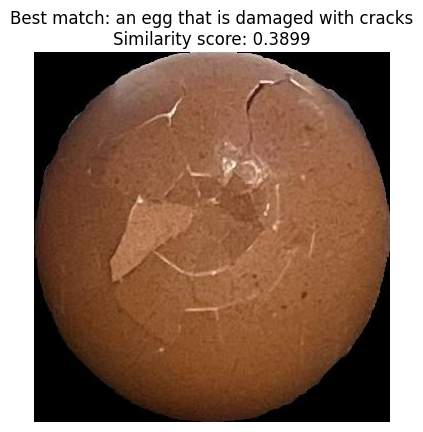

Image: maskegg_16_20.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.346435546875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.345458984375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.353759765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.341064453125
Description: an egg that has a hole, Similarity score: 0.337646484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.373046875
Description: an egg with a broken shell, Similarity score: 0.352783203125
Description: an egg that is damaged with cracks, Similarity score: 0.389892578125
Description: an egg that is completely intact with no cracks, Similarity score: 0.32763671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.32958984375
Description: an egg without any visible cracks, Similarity score: 0.361328125
Descri

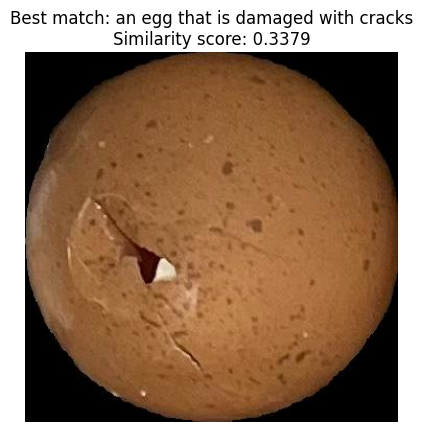

Image: maskegg_1_20.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3212890625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.313232421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.316650390625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.315185546875
Description: an egg that has a hole, Similarity score: 0.313232421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.328857421875
Description: an egg with a broken shell, Similarity score: 0.312255859375
Description: an egg that is damaged with cracks, Similarity score: 0.337890625
Description: an egg that is completely intact with no cracks, Similarity score: 0.294189453125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.300048828125
Description: an egg without any visible cracks, Similarity score: 0.3251953125
Descri

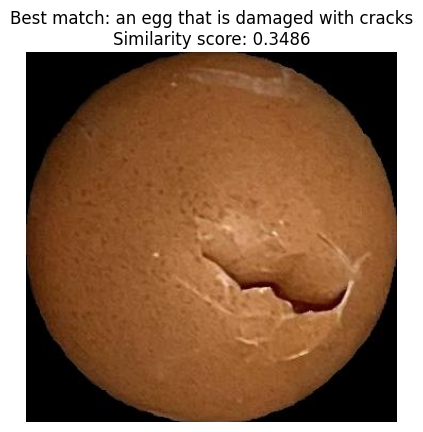

Image: maskegg_1_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.320556640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.309814453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.319091796875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31884765625
Description: an egg that has a hole, Similarity score: 0.32275390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.33935546875
Description: an egg with a broken shell, Similarity score: 0.3193359375
Description: an egg that is damaged with cracks, Similarity score: 0.3486328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.297607421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.306640625
Description: an egg without any visible cracks, Similarity score: 0.337890625
Description:

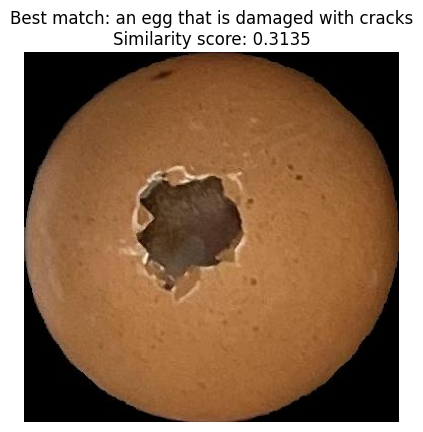

Image: maskegg_1_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.297607421875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2890625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2958984375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.29736328125
Description: an egg that has a hole, Similarity score: 0.30224609375
Description: an egg with many edge cracks on its skin, Similarity score: 0.31298828125
Description: an egg with a broken shell, Similarity score: 0.292236328125
Description: an egg that is damaged with cracks, Similarity score: 0.3134765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.268310546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.275390625
Description: an egg without any visible cracks, Similarity score: 0.30615234375
Description: an

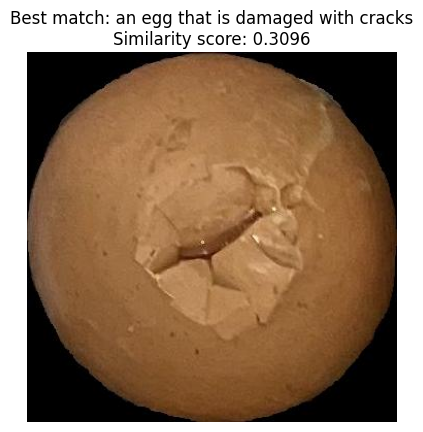

Image: maskegg_1_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28173828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.275146484375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28466796875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.285400390625
Description: an egg that has a hole, Similarity score: 0.285888671875
Description: an egg with many edge cracks on its skin, Similarity score: 0.29736328125
Description: an egg with a broken shell, Similarity score: 0.292724609375
Description: an egg that is damaged with cracks, Similarity score: 0.3095703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.271240234375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.276123046875
Description: an egg without any visible cracks, Similarity score: 0.30078125
Descript

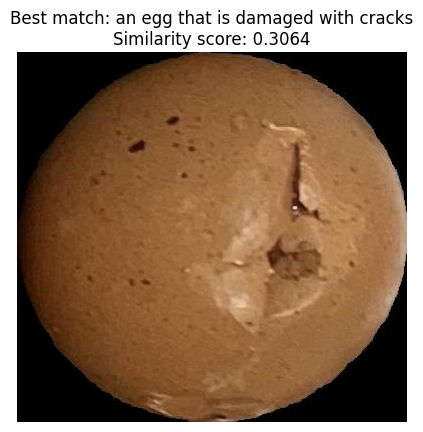

Image: maskegg_1_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.278076171875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.26416015625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2763671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.27880859375
Description: an egg that has a hole, Similarity score: 0.272705078125
Description: an egg with many edge cracks on its skin, Similarity score: 0.30029296875
Description: an egg with a broken shell, Similarity score: 0.272216796875
Description: an egg that is damaged with cracks, Similarity score: 0.306396484375
Description: an egg that is completely intact with no cracks, Similarity score: 0.253173828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.259521484375
Description: an egg without any visible cracks, Similarity score: 0.29150390625
Descr

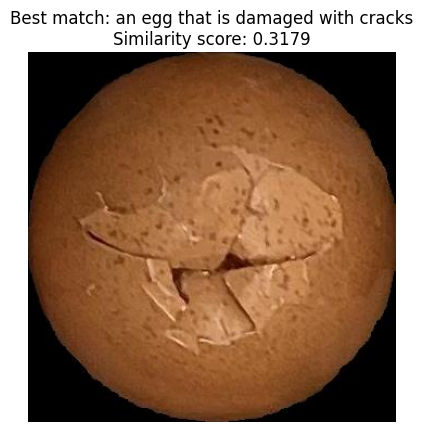

Image: maskegg_1_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.27978515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27783203125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.286376953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.291259765625
Description: an egg that has a hole, Similarity score: 0.28857421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.3076171875
Description: an egg with a broken shell, Similarity score: 0.291748046875
Description: an egg that is damaged with cracks, Similarity score: 0.31787109375
Description: an egg that is completely intact with no cracks, Similarity score: 0.273681640625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.279541015625
Description: an egg without any visible cracks, Similarity score: 0.3076171875
Descrip

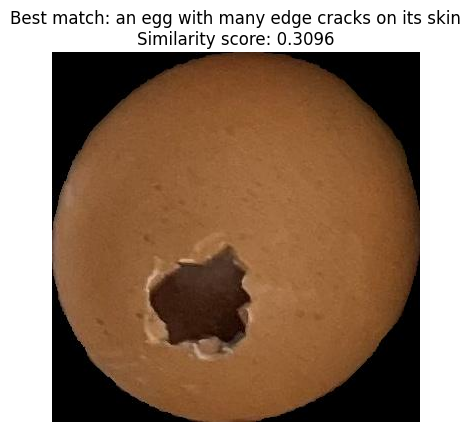

Image: maskegg_2_19.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28466796875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.269775390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.283447265625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.289794921875
Description: an egg that has a hole, Similarity score: 0.2900390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.3095703125
Description: an egg with a broken shell, Similarity score: 0.279052734375
Description: an egg that is damaged with cracks, Similarity score: 0.3095703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.252197265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.259765625
Description: an egg without any visible cracks, Similarity score: 0.29833984375
Descriptio

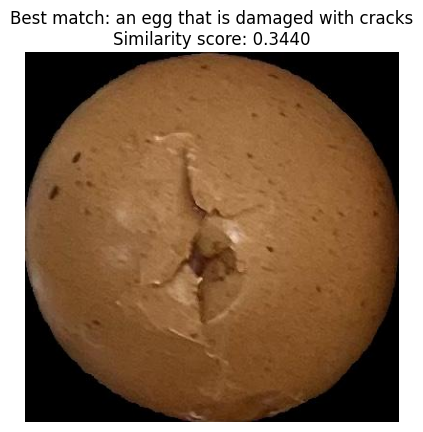

Image: maskegg_2_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.318115234375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.310546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31884765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.314697265625
Description: an egg that has a hole, Similarity score: 0.32275390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.33349609375
Description: an egg with a broken shell, Similarity score: 0.3154296875
Description: an egg that is damaged with cracks, Similarity score: 0.343994140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.302734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3076171875
Description: an egg without any visible cracks, Similarity score: 0.33154296875
Description: 

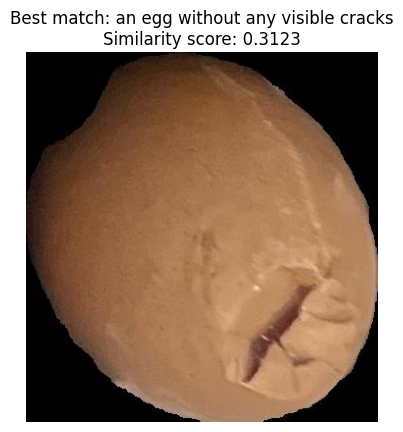

Image: maskegg_2_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29052734375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28857421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2939453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30419921875
Description: an egg that has a hole, Similarity score: 0.30029296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.30419921875
Description: an egg with a broken shell, Similarity score: 0.311767578125
Description: an egg that is damaged with cracks, Similarity score: 0.30517578125
Description: an egg that is completely intact with no cracks, Similarity score: 0.287353515625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.294677734375
Description: an egg without any visible cracks, Similarity score: 0.312255859375
Descrip

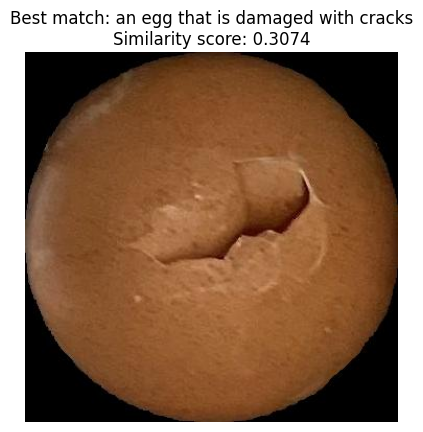

Image: maskegg_2_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2802734375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.263671875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.289794921875
Description: an egg that has a hole, Similarity score: 0.288330078125
Description: an egg with many edge cracks on its skin, Similarity score: 0.304443359375
Description: an egg with a broken shell, Similarity score: 0.278076171875
Description: an egg that is damaged with cracks, Similarity score: 0.307373046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.257080078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.265869140625
Description: an egg without any visible cracks, Similarity score: 0.3037109375
Description: 

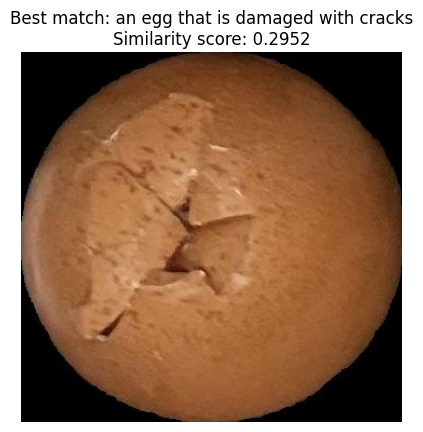

Image: maskegg_2_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.27099609375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.266845703125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.274169921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2783203125
Description: an egg that has a hole, Similarity score: 0.269287109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.292236328125
Description: an egg with a broken shell, Similarity score: 0.27587890625
Description: an egg that is damaged with cracks, Similarity score: 0.295166015625
Description: an egg that is completely intact with no cracks, Similarity score: 0.254638671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2646484375
Description: an egg without any visible cracks, Similarity score: 0.29296875
Descripti

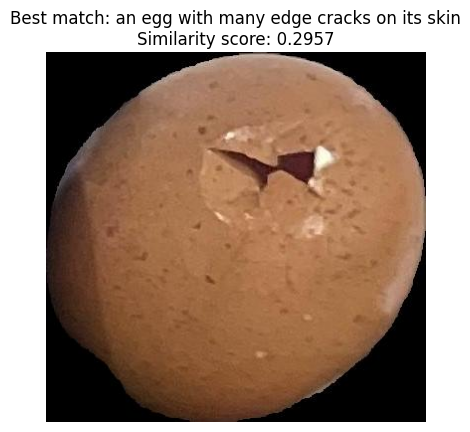

Image: maskegg_2_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.286865234375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2802734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28271484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.287841796875
Description: an egg that has a hole, Similarity score: 0.28271484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.295654296875
Description: an egg with a broken shell, Similarity score: 0.279541015625
Description: an egg that is damaged with cracks, Similarity score: 0.29248046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2587890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.270751953125
Description: an egg without any visible cracks, Similarity score: 0.29296875
Descriptio

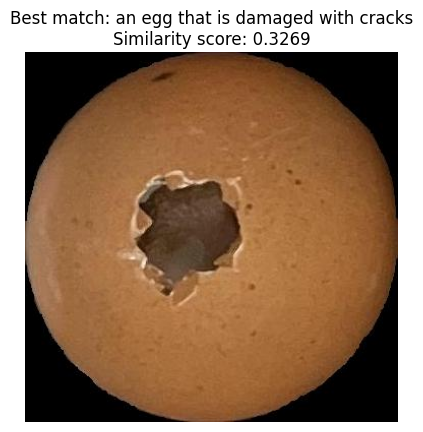

Image: maskegg_3_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3046875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.29345703125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.302978515625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3076171875
Description: an egg that has a hole, Similarity score: 0.31005859375
Description: an egg with many edge cracks on its skin, Similarity score: 0.32373046875
Description: an egg with a broken shell, Similarity score: 0.30126953125
Description: an egg that is damaged with cracks, Similarity score: 0.326904296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.275390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.282958984375
Description: an egg without any visible cracks, Similarity score: 0.31591796875
Description: a

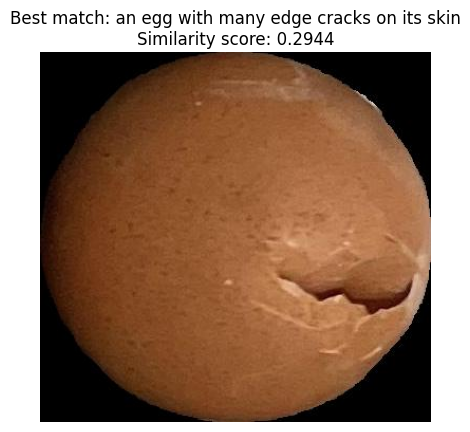

Image: maskegg_3_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.27001953125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.260009765625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.27001953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.279541015625
Description: an egg that has a hole, Similarity score: 0.2802734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.29443359375
Description: an egg with a broken shell, Similarity score: 0.280029296875
Description: an egg that is damaged with cracks, Similarity score: 0.28759765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.24853515625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26513671875
Description: an egg without any visible cracks, Similarity score: 0.29150390625
Descript

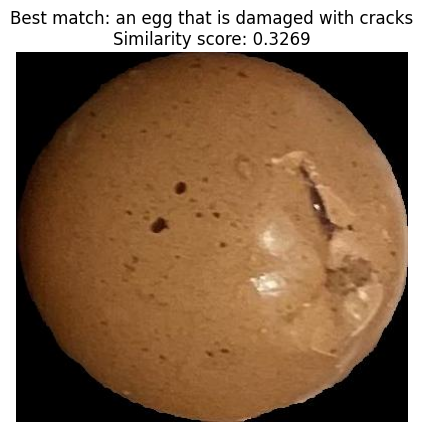

Image: maskegg_3_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29931640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.291015625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30029296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30224609375
Description: an egg that has a hole, Similarity score: 0.298095703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.319091796875
Description: an egg with a broken shell, Similarity score: 0.30029296875
Description: an egg that is damaged with cracks, Similarity score: 0.326904296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.282958984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.28759765625
Description: an egg without any visible cracks, Similarity score: 0.318115234375
Descrip

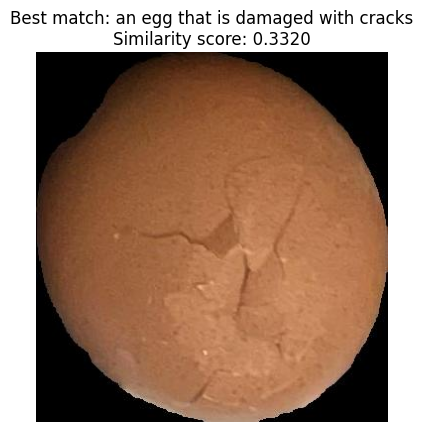

Image: maskegg_3_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3095703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.302734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31201171875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.307861328125
Description: an egg that has a hole, Similarity score: 0.303466796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.329833984375
Description: an egg with a broken shell, Similarity score: 0.3056640625
Description: an egg that is damaged with cracks, Similarity score: 0.33203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.293212890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.295166015625
Description: an egg without any visible cracks, Similarity score: 0.3310546875
Description: 

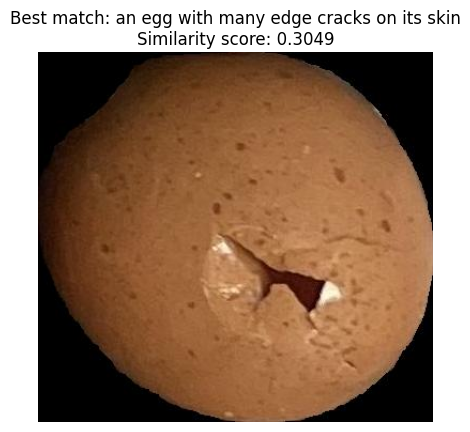

Image: maskegg_3_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.290283203125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.277099609375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28369140625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28759765625
Description: an egg that has a hole, Similarity score: 0.2822265625
Description: an egg with many edge cracks on its skin, Similarity score: 0.304931640625
Description: an egg with a broken shell, Similarity score: 0.27587890625
Description: an egg that is damaged with cracks, Similarity score: 0.304443359375
Description: an egg that is completely intact with no cracks, Similarity score: 0.259033203125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26416015625
Description: an egg without any visible cracks, Similarity score: 0.2978515625
Descrip

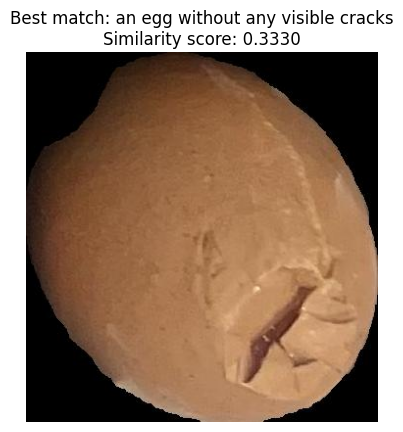

Image: maskegg_3_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.313720703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3154296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.320068359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.32421875
Description: an egg that has a hole, Similarity score: 0.320068359375
Description: an egg with many edge cracks on its skin, Similarity score: 0.32861328125
Description: an egg with a broken shell, Similarity score: 0.330078125
Description: an egg that is damaged with cracks, Similarity score: 0.33154296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.308837890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3115234375
Description: an egg without any visible cracks, Similarity score: 0.3330078125
Description: a

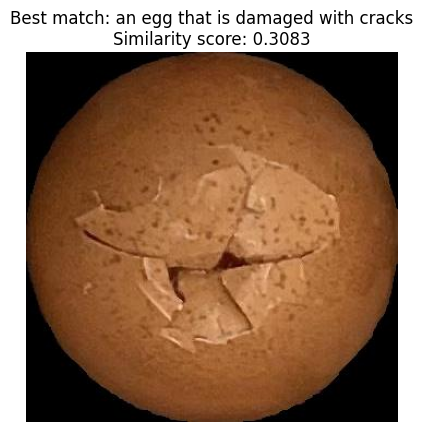

Image: maskegg_3_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.280029296875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28369140625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.287353515625
Description: an egg that has a hole, Similarity score: 0.277099609375
Description: an egg with many edge cracks on its skin, Similarity score: 0.30712890625
Description: an egg with a broken shell, Similarity score: 0.283203125
Description: an egg that is damaged with cracks, Similarity score: 0.308349609375
Description: an egg that is completely intact with no cracks, Similarity score: 0.26904296875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27978515625
Description: an egg without any visible cracks, Similarity score: 0.3037109375
Description: an

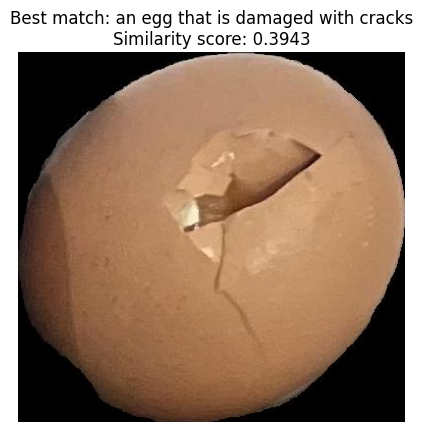

Image: maskegg_4_20.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.35693359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.35546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.359619140625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.350341796875
Description: an egg that has a hole, Similarity score: 0.34716796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.368896484375
Description: an egg with a broken shell, Similarity score: 0.359375
Description: an egg that is damaged with cracks, Similarity score: 0.394287109375
Description: an egg that is completely intact with no cracks, Similarity score: 0.338623046875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.336669921875
Description: an egg without any visible cracks, Similarity score: 0.360595703125
Description

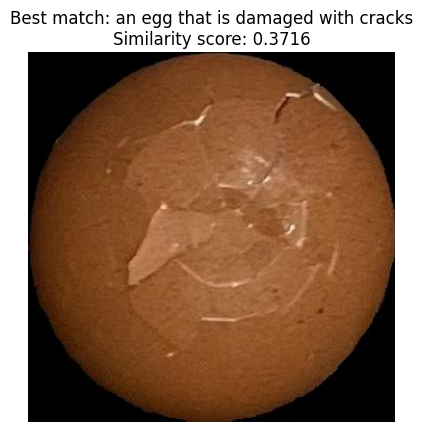

Image: maskegg_4_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.32373046875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.31689453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.331787109375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.318115234375
Description: an egg that has a hole, Similarity score: 0.307861328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.35107421875
Description: an egg with a broken shell, Similarity score: 0.32177734375
Description: an egg that is damaged with cracks, Similarity score: 0.37158203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.305419921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3076171875
Description: an egg without any visible cracks, Similarity score: 0.34423828125
Descrip

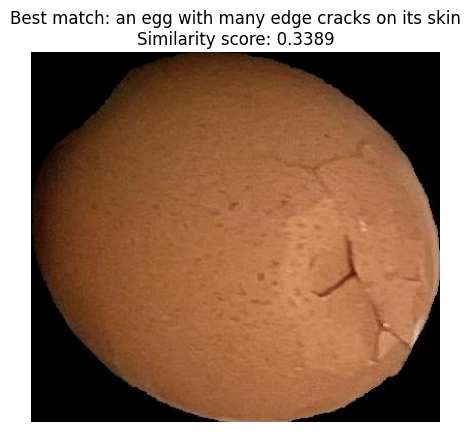

Image: maskegg_4_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3203125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.31689453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3203125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.312744140625
Description: an egg that has a hole, Similarity score: 0.31591796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.3388671875
Description: an egg with a broken shell, Similarity score: 0.314453125
Description: an egg that is damaged with cracks, Similarity score: 0.33740234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.30078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.308349609375
Description: an egg without any visible cracks, Similarity score: 0.3359375
Description: an egg that i

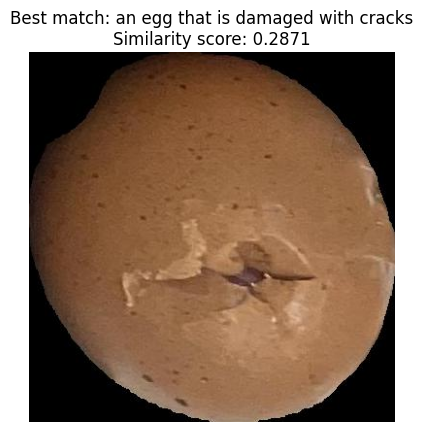

Image: maskegg_4_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.263916015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.26025390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.265869140625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.277099609375
Description: an egg that has a hole, Similarity score: 0.271728515625
Description: an egg with many edge cracks on its skin, Similarity score: 0.284423828125
Description: an egg with a broken shell, Similarity score: 0.278564453125
Description: an egg that is damaged with cracks, Similarity score: 0.287109375
Description: an egg that is completely intact with no cracks, Similarity score: 0.250244140625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26025390625
Description: an egg without any visible cracks, Similarity score: 0.287109375
Descrip

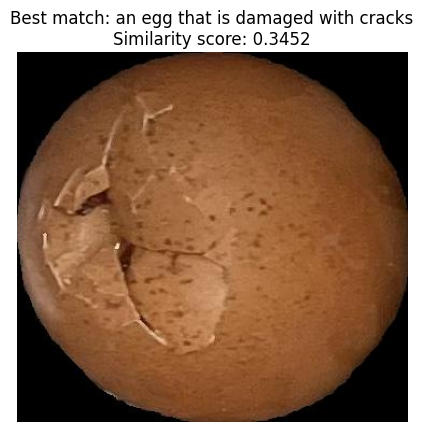

Image: maskegg_4_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.302978515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3017578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3115234375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31005859375
Description: an egg that has a hole, Similarity score: 0.30859375
Description: an egg with many edge cracks on its skin, Similarity score: 0.33251953125
Description: an egg with a broken shell, Similarity score: 0.316162109375
Description: an egg that is damaged with cracks, Similarity score: 0.34521484375
Description: an egg that is completely intact with no cracks, Similarity score: 0.298095703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.303955078125
Description: an egg without any visible cracks, Similarity score: 0.328369140625
Descriptio

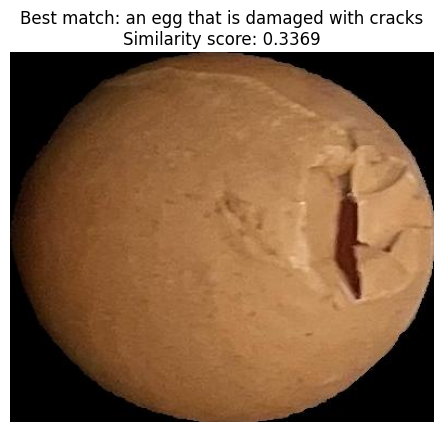

Image: maskegg_4_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.30419921875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2998046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30859375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3173828125
Description: an egg that has a hole, Similarity score: 0.308837890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.3232421875
Description: an egg with a broken shell, Similarity score: 0.315185546875
Description: an egg that is damaged with cracks, Similarity score: 0.3369140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.293701171875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2998046875
Description: an egg without any visible cracks, Similarity score: 0.323486328125
Description: a

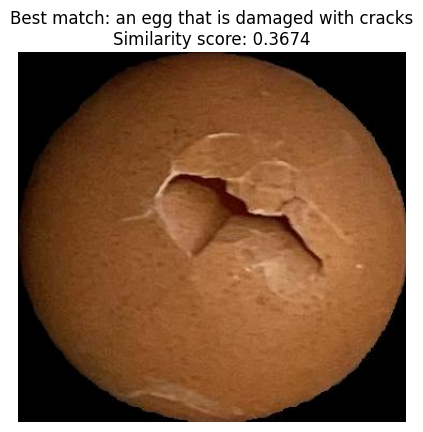

Image: maskegg_4_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.32666015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.316650390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.32763671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.320068359375
Description: an egg that has a hole, Similarity score: 0.3232421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.3564453125
Description: an egg with a broken shell, Similarity score: 0.325439453125
Description: an egg that is damaged with cracks, Similarity score: 0.367431640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.30615234375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3095703125
Description: an egg without any visible cracks, Similarity score: 0.33984375
Description:

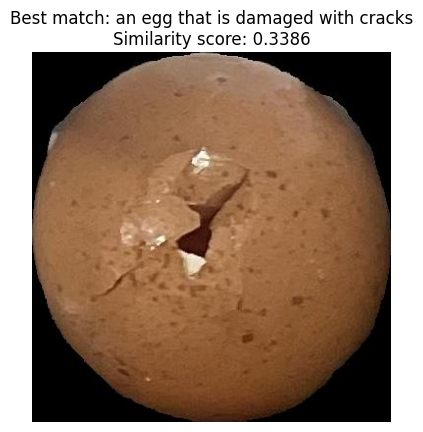

Image: maskegg_4_9.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3134765625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.309814453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3134765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.311279296875
Description: an egg that has a hole, Similarity score: 0.316650390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.330322265625
Description: an egg with a broken shell, Similarity score: 0.318115234375
Description: an egg that is damaged with cracks, Similarity score: 0.338623046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.298583984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.302490234375
Description: an egg without any visible cracks, Similarity score: 0.326171875
Descrip

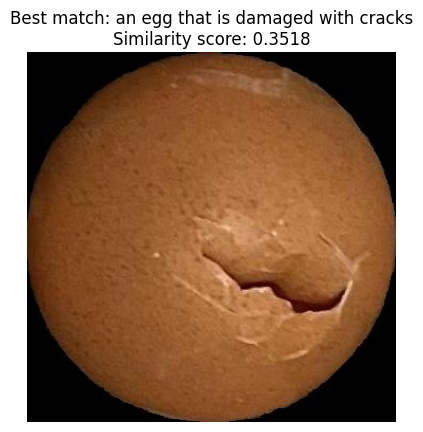

Image: maskegg_5_19.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.32080078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3076171875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.320556640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.321533203125
Description: an egg that has a hole, Similarity score: 0.323974609375
Description: an egg with many edge cracks on its skin, Similarity score: 0.342529296875
Description: an egg with a broken shell, Similarity score: 0.31787109375
Description: an egg that is damaged with cracks, Similarity score: 0.351806640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.299072265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30615234375
Description: an egg without any visible cracks, Similarity score: 0.341552734375
Desc

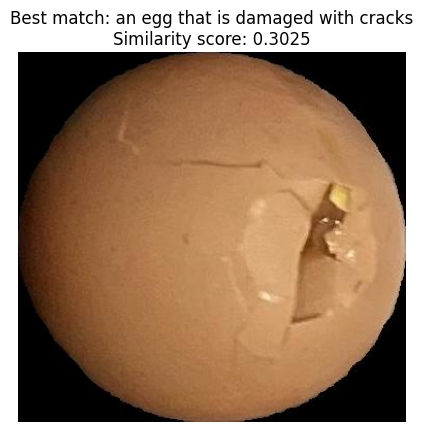

Image: maskegg_5_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28955078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27685546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.281494140625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.282470703125
Description: an egg that has a hole, Similarity score: 0.277587890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.299072265625
Description: an egg with a broken shell, Similarity score: 0.28515625
Description: an egg that is damaged with cracks, Similarity score: 0.302490234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.26220703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26953125
Description: an egg without any visible cracks, Similarity score: 0.29541015625
Description

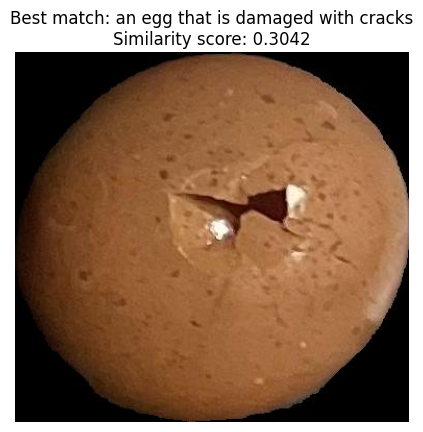

Image: maskegg_5_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.287109375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.279296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.283203125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.289306640625
Description: an egg that has a hole, Similarity score: 0.287841796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.302490234375
Description: an egg with a broken shell, Similarity score: 0.284912109375
Description: an egg that is damaged with cracks, Similarity score: 0.30419921875
Description: an egg that is completely intact with no cracks, Similarity score: 0.264404296875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27490234375
Description: an egg without any visible cracks, Similarity score: 0.30029296875
Description

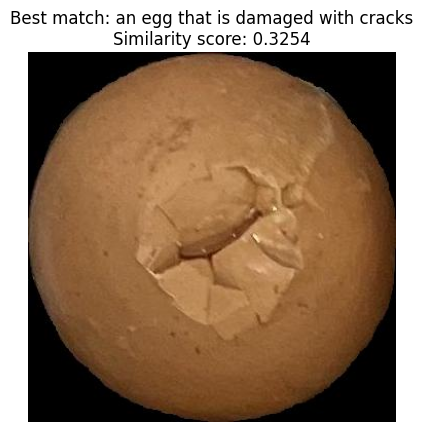

Image: maskegg_5_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2890625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28662109375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.295654296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.295654296875
Description: an egg that has a hole, Similarity score: 0.28955078125
Description: an egg with many edge cracks on its skin, Similarity score: 0.312744140625
Description: an egg with a broken shell, Similarity score: 0.304443359375
Description: an egg that is damaged with cracks, Similarity score: 0.325439453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.280517578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.286376953125
Description: an egg without any visible cracks, Similarity score: 0.31103515625
Descrip

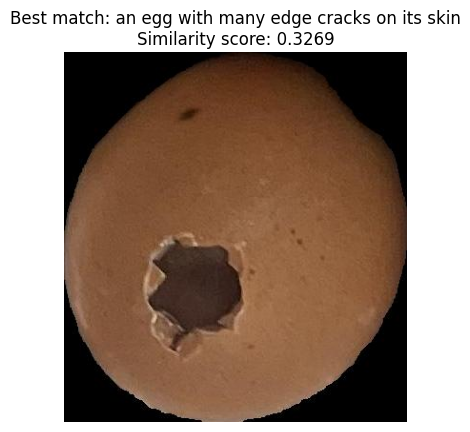

Image: maskegg_5_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.31103515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.308837890625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.308349609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31005859375
Description: an egg that has a hole, Similarity score: 0.31640625
Description: an egg with many edge cracks on its skin, Similarity score: 0.326904296875
Description: an egg with a broken shell, Similarity score: 0.306640625
Description: an egg that is damaged with cracks, Similarity score: 0.3232421875
Description: an egg that is completely intact with no cracks, Similarity score: 0.287353515625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.294189453125
Description: an egg without any visible cracks, Similarity score: 0.322265625
Description: 

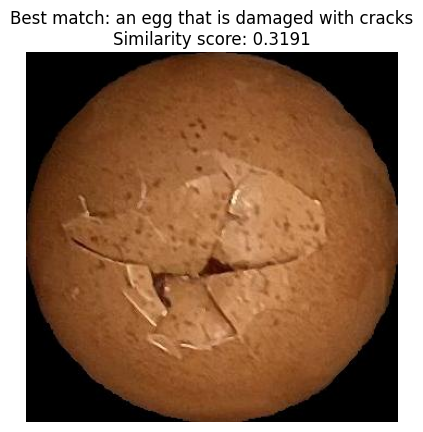

Image: maskegg_5_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.291015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.29345703125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29248046875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.301025390625
Description: an egg that has a hole, Similarity score: 0.294189453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.312744140625
Description: an egg with a broken shell, Similarity score: 0.306884765625
Description: an egg that is damaged with cracks, Similarity score: 0.319091796875
Description: an egg that is completely intact with no cracks, Similarity score: 0.279296875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29052734375
Description: an egg without any visible cracks, Similarity score: 0.311279296875
Descript

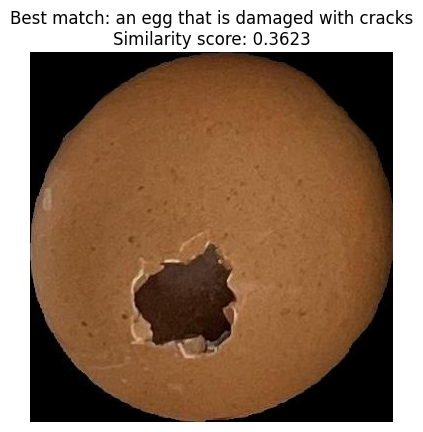

Image: maskegg_6_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.32373046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.334228515625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.328369140625
Description: an egg that has a hole, Similarity score: 0.33251953125
Description: an egg with many edge cracks on its skin, Similarity score: 0.359130859375
Description: an egg with a broken shell, Similarity score: 0.323974609375
Description: an egg that is damaged with cracks, Similarity score: 0.3623046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.302734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30859375
Description: an egg without any visible cracks, Similarity score: 0.346435546875
Description: an

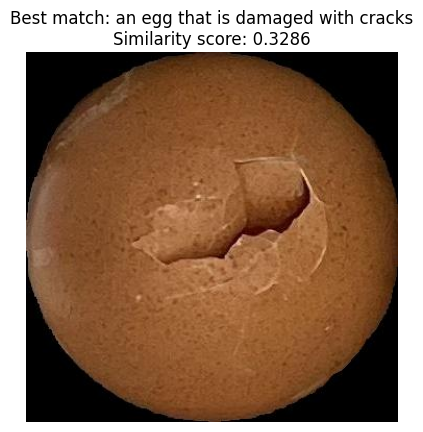

Image: maskegg_6_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.312255859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.304443359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30908203125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.305419921875
Description: an egg that has a hole, Similarity score: 0.305419921875
Description: an egg with many edge cracks on its skin, Similarity score: 0.324462890625
Description: an egg with a broken shell, Similarity score: 0.306396484375
Description: an egg that is damaged with cracks, Similarity score: 0.32861328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.29052734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.298095703125
Description: an egg without any visible cracks, Similarity score: 0.322021484375
De

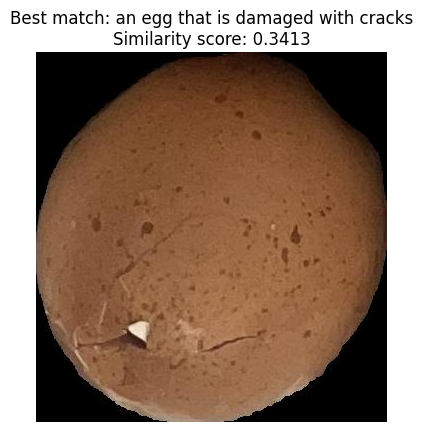

Image: maskegg_6_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3193359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.315673828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.32177734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31982421875
Description: an egg that has a hole, Similarity score: 0.317626953125
Description: an egg with many edge cracks on its skin, Similarity score: 0.336669921875
Description: an egg with a broken shell, Similarity score: 0.325439453125
Description: an egg that is damaged with cracks, Similarity score: 0.34130859375
Description: an egg that is completely intact with no cracks, Similarity score: 0.301513671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.304931640625
Description: an egg without any visible cracks, Similarity score: 0.33349609375
Descr

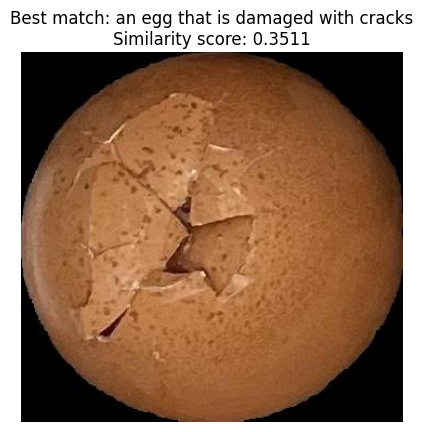

Image: maskegg_6_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.319580078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.324462890625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.326171875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3173828125
Description: an egg that has a hole, Similarity score: 0.319580078125
Description: an egg with many edge cracks on its skin, Similarity score: 0.341796875
Description: an egg with a broken shell, Similarity score: 0.328857421875
Description: an egg that is damaged with cracks, Similarity score: 0.35107421875
Description: an egg that is completely intact with no cracks, Similarity score: 0.31005859375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.316650390625
Description: an egg without any visible cracks, Similarity score: 0.32861328125
Descriptio

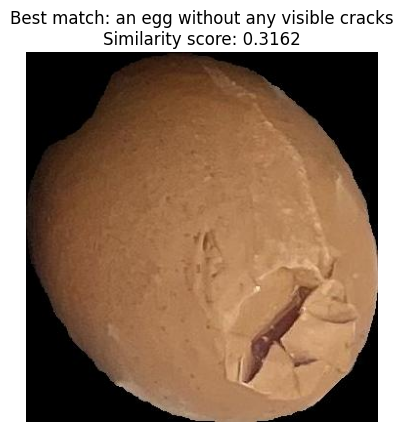

Image: maskegg_6_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2939453125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.29296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30126953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.305419921875
Description: an egg that has a hole, Similarity score: 0.3037109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.311279296875
Description: an egg with a broken shell, Similarity score: 0.31103515625
Description: an egg that is damaged with cracks, Similarity score: 0.31396484375
Description: an egg that is completely intact with no cracks, Similarity score: 0.286376953125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29248046875
Description: an egg without any visible cracks, Similarity score: 0.316162109375
Description

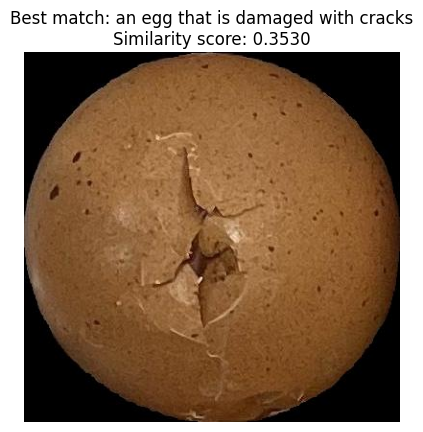

Image: maskegg_6_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.317626953125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.31005859375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31787109375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3125
Description: an egg that has a hole, Similarity score: 0.3134765625
Description: an egg with many edge cracks on its skin, Similarity score: 0.334716796875
Description: an egg with a broken shell, Similarity score: 0.3193359375
Description: an egg that is damaged with cracks, Similarity score: 0.35302734375
Description: an egg that is completely intact with no cracks, Similarity score: 0.30517578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30908203125
Description: an egg without any visible cracks, Similarity score: 0.330322265625
Description: an 

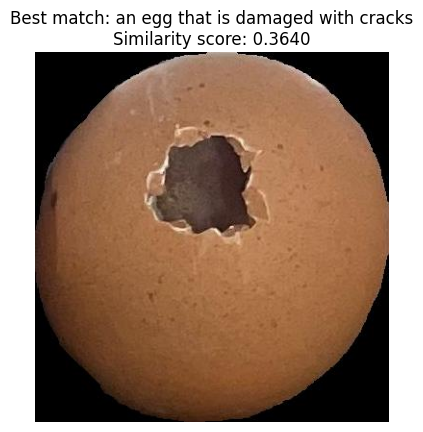

Image: maskegg_7_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.342041015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.336181640625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.34033203125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.331298828125
Description: an egg that has a hole, Similarity score: 0.34521484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.357177734375
Description: an egg with a broken shell, Similarity score: 0.3388671875
Description: an egg that is damaged with cracks, Similarity score: 0.364013671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.312744140625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.31884765625
Description: an egg without any visible cracks, Similarity score: 0.345947265625
Desc

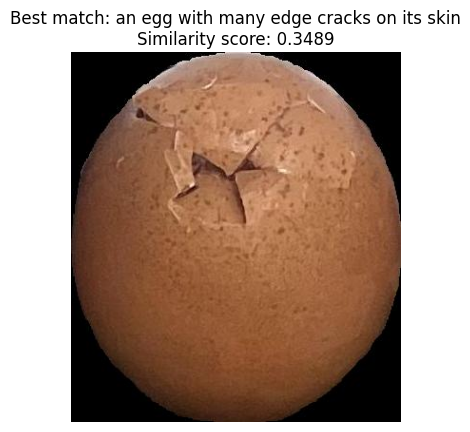

Image: maskegg_7_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.32763671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.325439453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.327392578125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.325439453125
Description: an egg that has a hole, Similarity score: 0.32763671875
Description: an egg with many edge cracks on its skin, Similarity score: 0.348876953125
Description: an egg with a broken shell, Similarity score: 0.3310546875
Description: an egg that is damaged with cracks, Similarity score: 0.34765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.310546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3154296875
Description: an egg without any visible cracks, Similarity score: 0.342041015625
Description:

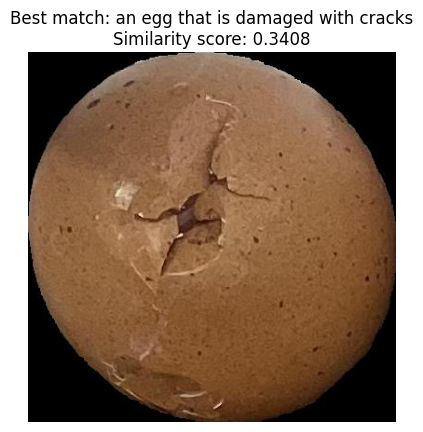

Image: maskegg_7_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3134765625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.306396484375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.310791015625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30615234375
Description: an egg that has a hole, Similarity score: 0.305419921875
Description: an egg with many edge cracks on its skin, Similarity score: 0.328369140625
Description: an egg with a broken shell, Similarity score: 0.310302734375
Description: an egg that is damaged with cracks, Similarity score: 0.3408203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2978515625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.300048828125
Description: an egg without any visible cracks, Similarity score: 0.3232421875
Descript

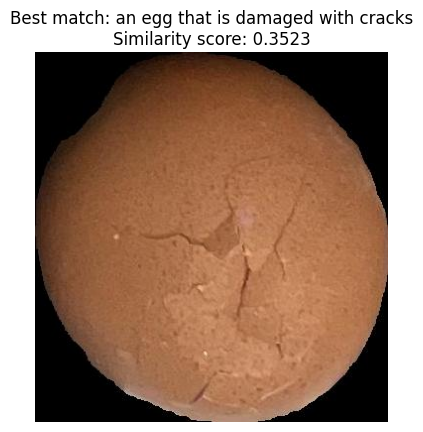

Image: maskegg_7_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.310791015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.307861328125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3193359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.315185546875
Description: an egg that has a hole, Similarity score: 0.310791015625
Description: an egg with many edge cracks on its skin, Similarity score: 0.34130859375
Description: an egg with a broken shell, Similarity score: 0.31884765625
Description: an egg that is damaged with cracks, Similarity score: 0.352294921875
Description: an egg that is completely intact with no cracks, Similarity score: 0.302001953125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3046875
Description: an egg without any visible cracks, Similarity score: 0.341064453125
Descript

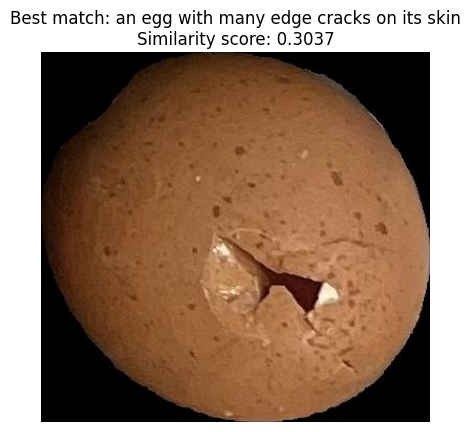

Image: maskegg_7_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.290771484375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.279541015625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28369140625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.289306640625
Description: an egg that has a hole, Similarity score: 0.287353515625
Description: an egg with many edge cracks on its skin, Similarity score: 0.3037109375
Description: an egg with a broken shell, Similarity score: 0.2841796875
Description: an egg that is damaged with cracks, Similarity score: 0.2998046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.259521484375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26953125
Description: an egg without any visible cracks, Similarity score: 0.296875
Description: an 

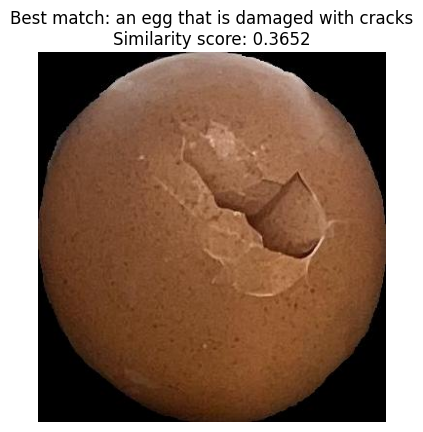

Image: maskegg_7_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.336181640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.33349609375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.337646484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.327392578125
Description: an egg that has a hole, Similarity score: 0.333984375
Description: an egg with many edge cracks on its skin, Similarity score: 0.35595703125
Description: an egg with a broken shell, Similarity score: 0.336181640625
Description: an egg that is damaged with cracks, Similarity score: 0.365234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.314208984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.320556640625
Description: an egg without any visible cracks, Similarity score: 0.34814453125
Descript

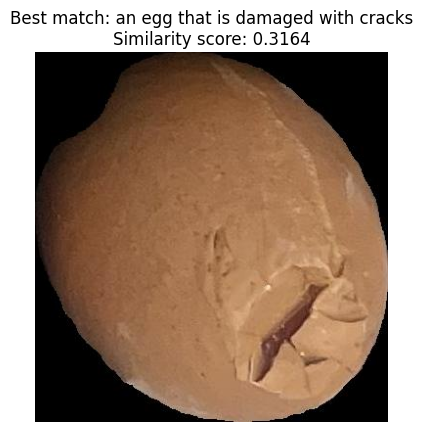

Image: maskegg_7_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29150390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28955078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.301025390625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3046875
Description: an egg that has a hole, Similarity score: 0.3046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.31298828125
Description: an egg with a broken shell, Similarity score: 0.311279296875
Description: an egg that is damaged with cracks, Similarity score: 0.31640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.287841796875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.291259765625
Description: an egg without any visible cracks, Similarity score: 0.31396484375
Description: an e

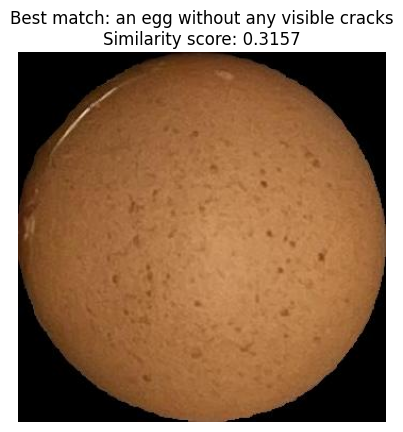

Image: maskegg_8_17.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.302490234375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.287109375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.302734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.29296875
Description: an egg that has a hole, Similarity score: 0.296142578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.3115234375
Description: an egg with a broken shell, Similarity score: 0.28125
Description: an egg that is damaged with cracks, Similarity score: 0.306396484375
Description: an egg that is completely intact with no cracks, Similarity score: 0.272705078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.28173828125
Description: an egg without any visible cracks, Similarity score: 0.315673828125
Description: an egg

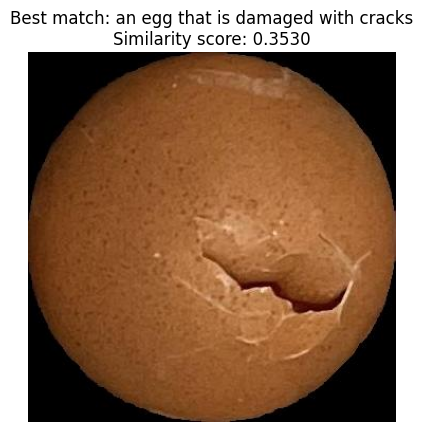

Image: maskegg_8_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.32470703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.314453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.322021484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31591796875
Description: an egg that has a hole, Similarity score: 0.323974609375
Description: an egg with many edge cracks on its skin, Similarity score: 0.341796875
Description: an egg with a broken shell, Similarity score: 0.321044921875
Description: an egg that is damaged with cracks, Similarity score: 0.35302734375
Description: an egg that is completely intact with no cracks, Similarity score: 0.302734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30908203125
Description: an egg without any visible cracks, Similarity score: 0.33740234375
Description: 

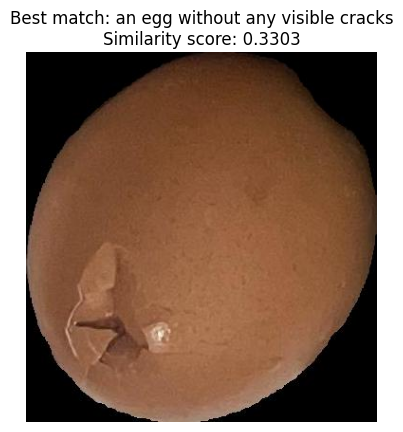

Image: maskegg_8_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.303955078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2998046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.306396484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.310546875
Description: an egg that has a hole, Similarity score: 0.31396484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.330078125
Description: an egg with a broken shell, Similarity score: 0.314208984375
Description: an egg that is damaged with cracks, Similarity score: 0.32861328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.289306640625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.300048828125
Description: an egg without any visible cracks, Similarity score: 0.330322265625
Descripti

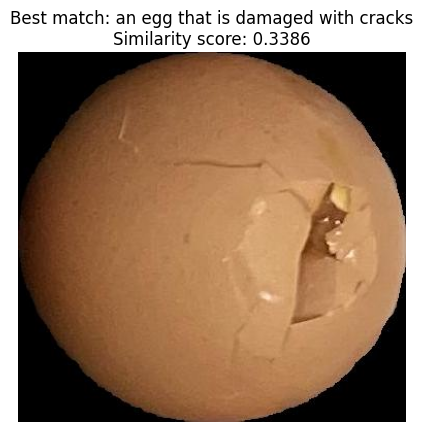

Image: maskegg_8_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.323974609375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3173828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.313232421875
Description: an egg that has a hole, Similarity score: 0.316650390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.33056640625
Description: an egg with a broken shell, Similarity score: 0.322021484375
Description: an egg that is damaged with cracks, Similarity score: 0.338623046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.304443359375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.31201171875
Description: an egg without any visible cracks, Similarity score: 0.32470703125
Descript

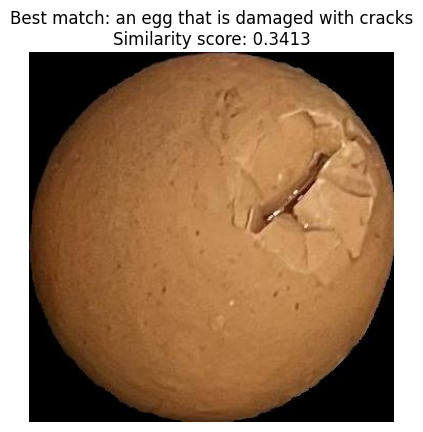

Image: maskegg_8_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.314697265625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.3076171875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.317138671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3125
Description: an egg that has a hole, Similarity score: 0.31787109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.328369140625
Description: an egg with a broken shell, Similarity score: 0.3154296875
Description: an egg that is damaged with cracks, Similarity score: 0.34130859375
Description: an egg that is completely intact with no cracks, Similarity score: 0.301025390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.299560546875
Description: an egg without any visible cracks, Similarity score: 0.328857421875
Description: 

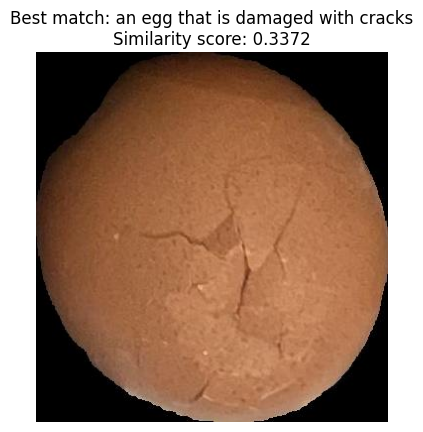

Image: maskegg_8_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.310791015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.304931640625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.308837890625
Description: an egg that has a hole, Similarity score: 0.307373046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.332763671875
Description: an egg with a broken shell, Similarity score: 0.308837890625
Description: an egg that is damaged with cracks, Similarity score: 0.337158203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.299072265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.30029296875
Description: an egg without any visible cracks, Similarity score: 0.332763671875
Descript

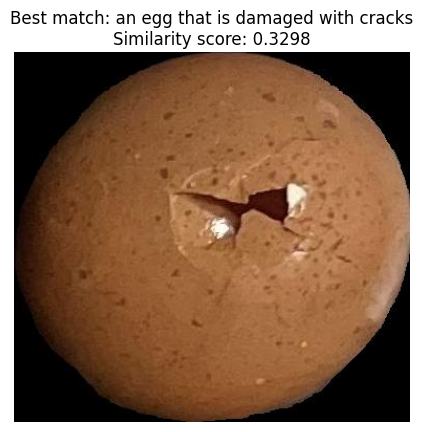

Image: maskegg_8_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.305908203125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.299072265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3056640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3046875
Description: an egg that has a hole, Similarity score: 0.306884765625
Description: an egg with many edge cracks on its skin, Similarity score: 0.321044921875
Description: an egg with a broken shell, Similarity score: 0.309814453125
Description: an egg that is damaged with cracks, Similarity score: 0.329833984375
Description: an egg that is completely intact with no cracks, Similarity score: 0.28271484375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.292724609375
Description: an egg without any visible cracks, Similarity score: 0.315673828125
Descrip

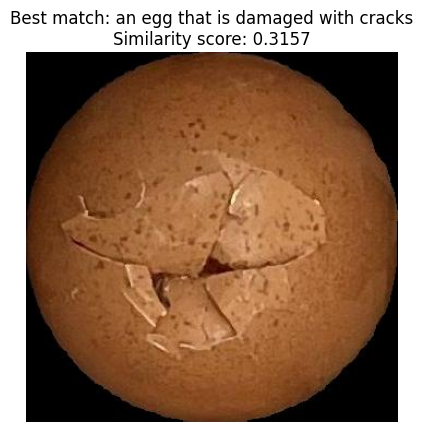

Image: maskegg_8_29.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28466796875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.289794921875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.291748046875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.29736328125
Description: an egg that has a hole, Similarity score: 0.295654296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.307373046875
Description: an egg with a broken shell, Similarity score: 0.305419921875
Description: an egg that is damaged with cracks, Similarity score: 0.315673828125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2841796875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.292724609375
Description: an egg without any visible cracks, Similarity score: 0.3076171875
Descr

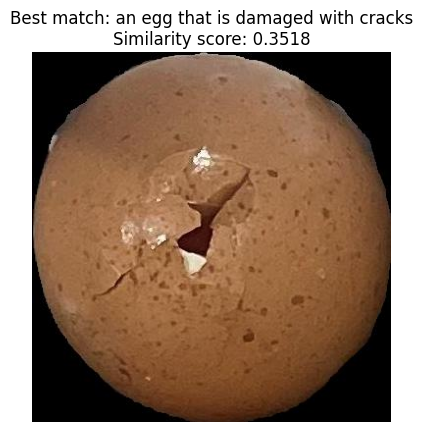

Image: maskegg_9_15.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.32470703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.318603515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.325927734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.323974609375
Description: an egg that has a hole, Similarity score: 0.33056640625
Description: an egg with many edge cracks on its skin, Similarity score: 0.341552734375
Description: an egg with a broken shell, Similarity score: 0.327880859375
Description: an egg that is damaged with cracks, Similarity score: 0.351806640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.30859375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.313720703125
Description: an egg without any visible cracks, Similarity score: 0.337646484375
Descr

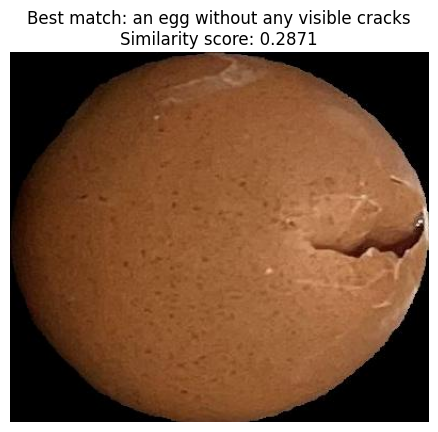

Image: maskegg_9_20.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.269775390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.260498046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.269775390625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.275146484375
Description: an egg that has a hole, Similarity score: 0.266357421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.285400390625
Description: an egg with a broken shell, Similarity score: 0.273193359375
Description: an egg that is damaged with cracks, Similarity score: 0.28515625
Description: an egg that is completely intact with no cracks, Similarity score: 0.252197265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.264404296875
Description: an egg without any visible cracks, Similarity score: 0.287109375
Descri

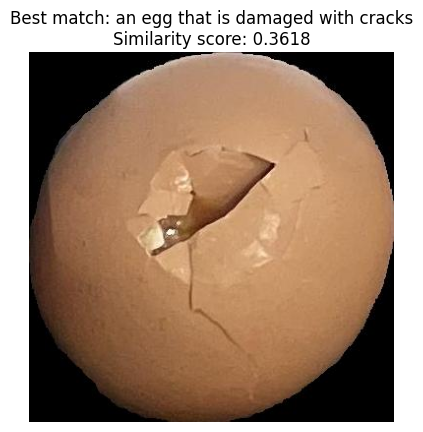

Image: maskegg_9_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.332763671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.330078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.331298828125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.325439453125
Description: an egg that has a hole, Similarity score: 0.32861328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.34375
Description: an egg with a broken shell, Similarity score: 0.3369140625
Description: an egg that is damaged with cracks, Similarity score: 0.36181640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.318359375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.318359375
Description: an egg without any visible cracks, Similarity score: 0.33740234375
Description: an egg 

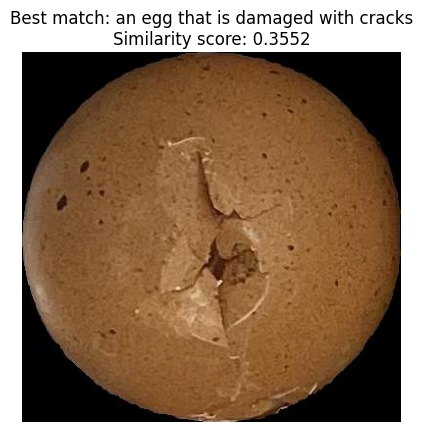

Image: maskegg_9_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.322021484375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.313232421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.323486328125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31494140625
Description: an egg that has a hole, Similarity score: 0.318359375
Description: an egg with many edge cracks on its skin, Similarity score: 0.33642578125
Description: an egg with a broken shell, Similarity score: 0.3193359375
Description: an egg that is damaged with cracks, Similarity score: 0.355224609375
Description: an egg that is completely intact with no cracks, Similarity score: 0.305419921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.305419921875
Description: an egg without any visible cracks, Similarity score: 0.332763671875
Descri

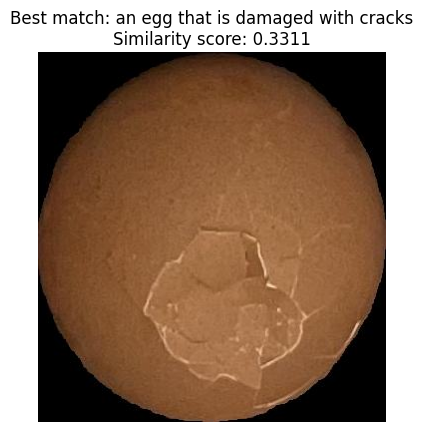

Image: maskegg_9_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.294677734375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2841796875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2998046875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2900390625
Description: an egg that has a hole, Similarity score: 0.287841796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.322509765625
Description: an egg with a broken shell, Similarity score: 0.28955078125
Description: an egg that is damaged with cracks, Similarity score: 0.3310546875
Description: an egg that is completely intact with no cracks, Similarity score: 0.274658203125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.279541015625
Description: an egg without any visible cracks, Similarity score: 0.321533203125
Descript

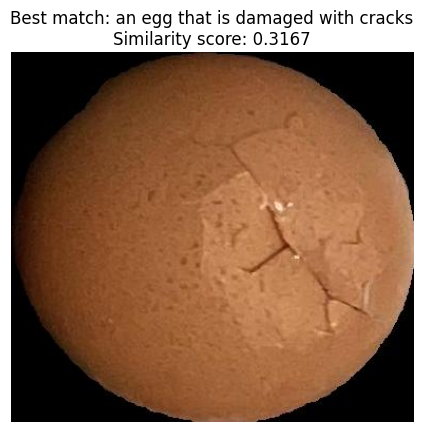

Image: maskegg_9_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.296630859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28955078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.294921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.287353515625
Description: an egg that has a hole, Similarity score: 0.2802734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.314697265625
Description: an egg with a broken shell, Similarity score: 0.284912109375
Description: an egg that is damaged with cracks, Similarity score: 0.316650390625
Description: an egg that is completely intact with no cracks, Similarity score: 0.27685546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.283203125
Description: an egg without any visible cracks, Similarity score: 0.310302734375
Descripti

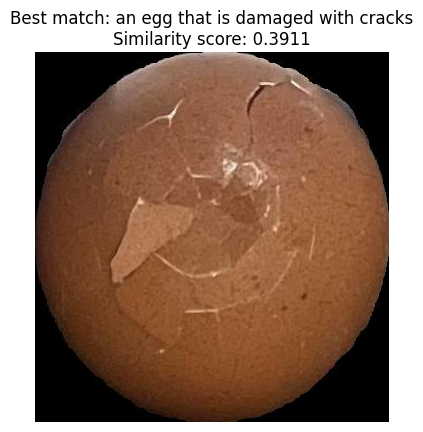

Image: maskegg_9_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.355712890625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.35498046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.360107421875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.347900390625
Description: an egg that has a hole, Similarity score: 0.346435546875
Description: an egg with many edge cracks on its skin, Similarity score: 0.377685546875
Description: an egg with a broken shell, Similarity score: 0.3583984375
Description: an egg that is damaged with cracks, Similarity score: 0.39111328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.3359375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.33935546875
Description: an egg without any visible cracks, Similarity score: 0.36767578125
Descriptio

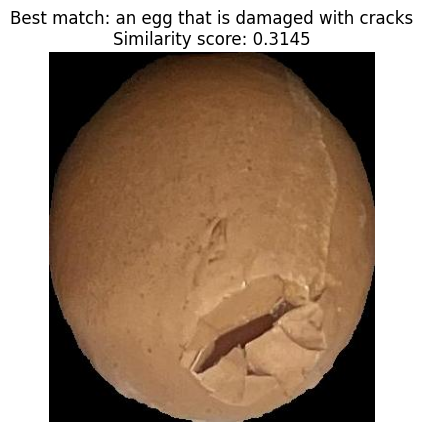

Image: maskegg_9_27.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.273681640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2880859375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.291748046875
Description: an egg that has a hole, Similarity score: 0.279296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.306396484375
Description: an egg with a broken shell, Similarity score: 0.29931640625
Description: an egg that is damaged with cracks, Similarity score: 0.314453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.268310546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.276123046875
Description: an egg without any visible cracks, Similarity score: 0.304443359375
Description: 

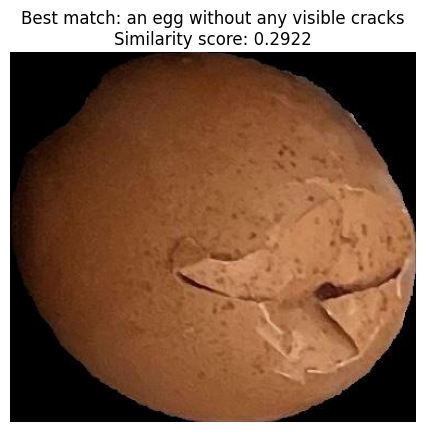

Image: maskegg_9_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.270263671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.271728515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.270751953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28173828125
Description: an egg that has a hole, Similarity score: 0.2783203125
Description: an egg with many edge cracks on its skin, Similarity score: 0.290283203125
Description: an egg with a broken shell, Similarity score: 0.2890625
Description: an egg that is damaged with cracks, Similarity score: 0.281494140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.255859375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.270263671875
Description: an egg without any visible cracks, Similarity score: 0.292236328125
Descriptio

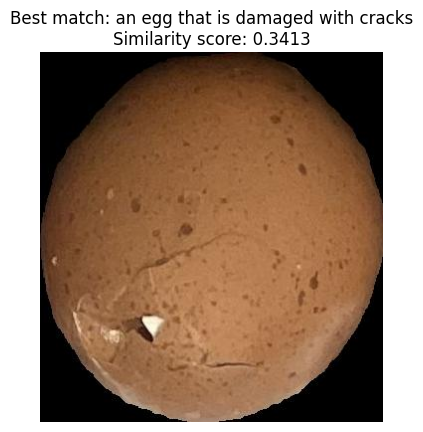

Image: maskegg_0.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.31689453125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.313232421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31884765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3212890625
Description: an egg that has a hole, Similarity score: 0.31396484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.336181640625
Description: an egg with a broken shell, Similarity score: 0.32470703125
Description: an egg that is damaged with cracks, Similarity score: 0.34130859375
Description: an egg that is completely intact with no cracks, Similarity score: 0.29638671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3037109375
Description: an egg without any visible cracks, Similarity score: 0.333251953125
Description:

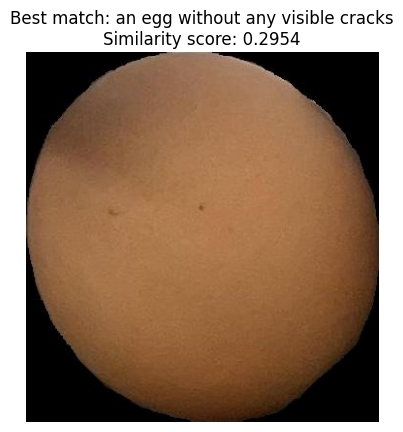

Image: maskegg_0_0.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.279541015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.264892578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2763671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2734375
Description: an egg that has a hole, Similarity score: 0.27490234375
Description: an egg with many edge cracks on its skin, Similarity score: 0.28955078125
Description: an egg with a broken shell, Similarity score: 0.2568359375
Description: an egg that is damaged with cracks, Similarity score: 0.27490234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.2459716796875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.259521484375
Description: an egg without any visible cracks, Similarity score: 0.29541015625
Description:

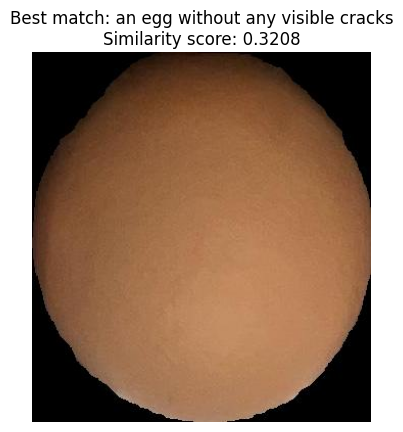

Image: maskegg_0_10.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.297119140625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28369140625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.298828125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.295166015625
Description: an egg that has a hole, Similarity score: 0.2900390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.30712890625
Description: an egg with a broken shell, Similarity score: 0.28662109375
Description: an egg that is damaged with cracks, Similarity score: 0.29345703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.271728515625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.279052734375
Description: an egg without any visible cracks, Similarity score: 0.32080078125
Descripti

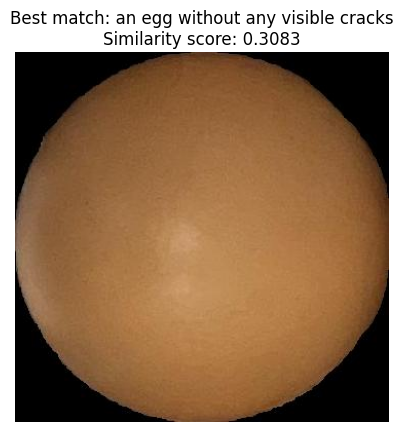

Image: maskegg_0_11.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29443359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27978515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2939453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.286865234375
Description: an egg that has a hole, Similarity score: 0.286865234375
Description: an egg with many edge cracks on its skin, Similarity score: 0.296142578125
Description: an egg with a broken shell, Similarity score: 0.2763671875
Description: an egg that is damaged with cracks, Similarity score: 0.282958984375
Description: an egg that is completely intact with no cracks, Similarity score: 0.268798828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2802734375
Description: an egg without any visible cracks, Similarity score: 0.308349609375
Descrip

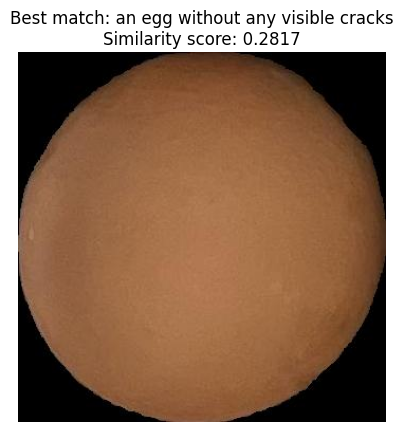

Image: maskegg_0_12.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.262939453125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.246826171875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.265380859375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.259765625
Description: an egg that has a hole, Similarity score: 0.25537109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.267822265625
Description: an egg with a broken shell, Similarity score: 0.24951171875
Description: an egg that is damaged with cracks, Similarity score: 0.253173828125
Description: an egg that is completely intact with no cracks, Similarity score: 0.232666015625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.24072265625
Description: an egg without any visible cracks, Similarity score: 0.28173828125
Descri

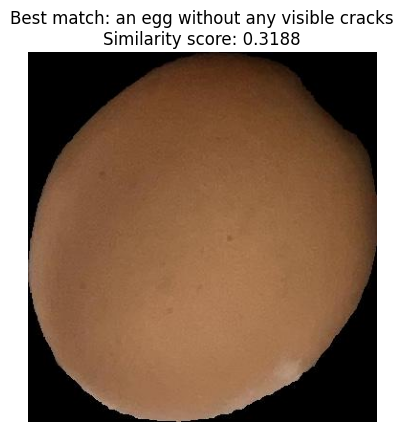

Image: maskegg_0_13.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.30322265625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.293701171875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30126953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2978515625
Description: an egg that has a hole, Similarity score: 0.3017578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.305419921875
Description: an egg with a broken shell, Similarity score: 0.291748046875
Description: an egg that is damaged with cracks, Similarity score: 0.29052734375
Description: an egg that is completely intact with no cracks, Similarity score: 0.2822265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29150390625
Description: an egg without any visible cracks, Similarity score: 0.31884765625
Descriptio

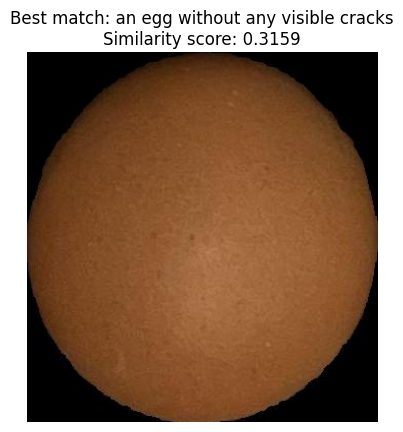

Image: maskegg_0_14.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.300537109375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.282958984375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.301025390625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.288818359375
Description: an egg that has a hole, Similarity score: 0.29345703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.3076171875
Description: an egg with a broken shell, Similarity score: 0.276123046875
Description: an egg that is damaged with cracks, Similarity score: 0.297607421875
Description: an egg that is completely intact with no cracks, Similarity score: 0.270263671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.275634765625
Description: an egg without any visible cracks, Similarity score: 0.31591796875
Des

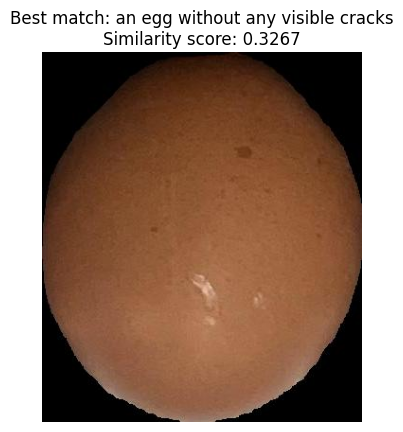

Image: maskegg_0_15.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3095703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2978515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3056640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.302490234375
Description: an egg that has a hole, Similarity score: 0.303955078125
Description: an egg with many edge cracks on its skin, Similarity score: 0.32080078125
Description: an egg with a broken shell, Similarity score: 0.29833984375
Description: an egg that is damaged with cracks, Similarity score: 0.3154296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.282958984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2919921875
Description: an egg without any visible cracks, Similarity score: 0.32666015625
Description:

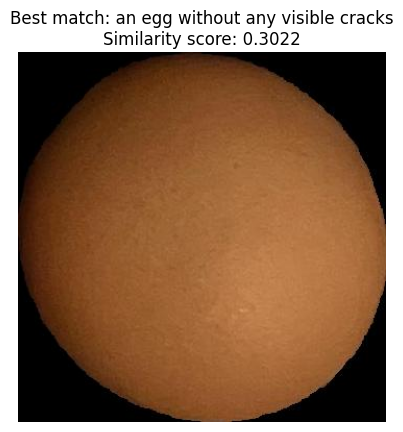

Image: maskegg_0_16.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2841796875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.262939453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28466796875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.276123046875
Description: an egg that has a hole, Similarity score: 0.276611328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.297607421875
Description: an egg with a broken shell, Similarity score: 0.260498046875
Description: an egg that is damaged with cracks, Similarity score: 0.287109375
Description: an egg that is completely intact with no cracks, Similarity score: 0.253173828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2578125
Description: an egg without any visible cracks, Similarity score: 0.30224609375
Description

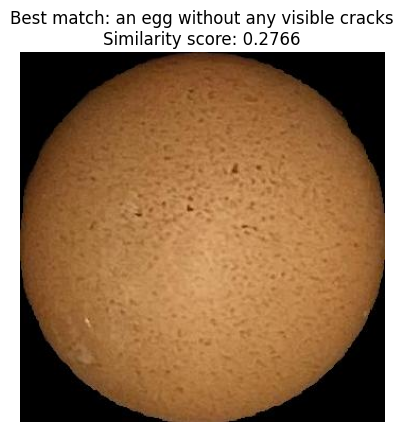

Image: maskegg_0_18.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.254150390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.239013671875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.25634765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.25341796875
Description: an egg that has a hole, Similarity score: 0.256103515625
Description: an egg with many edge cracks on its skin, Similarity score: 0.265380859375
Description: an egg with a broken shell, Similarity score: 0.238037109375
Description: an egg that is damaged with cracks, Similarity score: 0.25634765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2322998046875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.244873046875
Description: an egg without any visible cracks, Similarity score: 0.276611328125
D

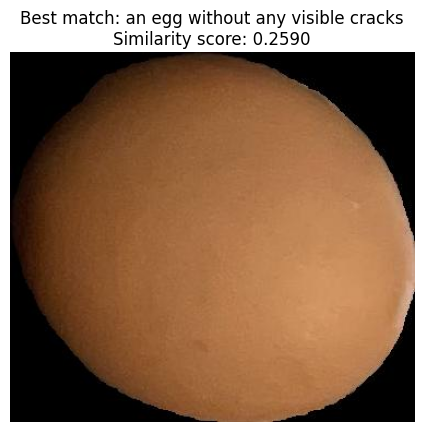

Image: maskegg_0_19.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2427978515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.22998046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.239990234375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.24267578125
Description: an egg that has a hole, Similarity score: 0.2303466796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.249267578125
Description: an egg with a broken shell, Similarity score: 0.2255859375
Description: an egg that is damaged with cracks, Similarity score: 0.231201171875
Description: an egg that is completely intact with no cracks, Similarity score: 0.218505859375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2281494140625
Description: an egg without any visible cracks, Similarity score: 0.259033203125


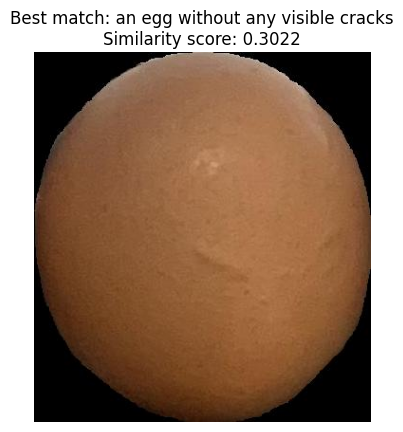

Image: maskegg_0_2.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.286865234375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2744140625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.283447265625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.280517578125
Description: an egg that has a hole, Similarity score: 0.2734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.292724609375
Description: an egg with a broken shell, Similarity score: 0.26953125
Description: an egg that is damaged with cracks, Similarity score: 0.2861328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.263427734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.268310546875
Description: an egg without any visible cracks, Similarity score: 0.30224609375
Description: a

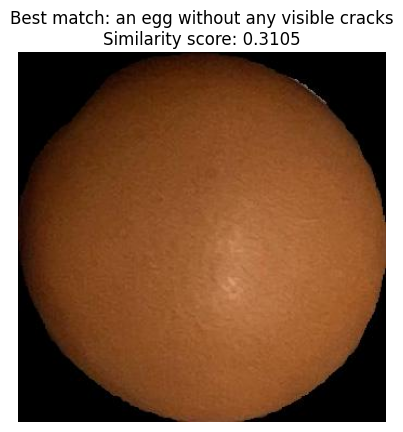

Image: maskegg_0_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.293701171875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27783203125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.295654296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28759765625
Description: an egg that has a hole, Similarity score: 0.28564453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.30712890625
Description: an egg with a broken shell, Similarity score: 0.271240234375
Description: an egg that is damaged with cracks, Similarity score: 0.29345703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.259521484375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.267333984375
Description: an egg without any visible cracks, Similarity score: 0.310546875
Descrip

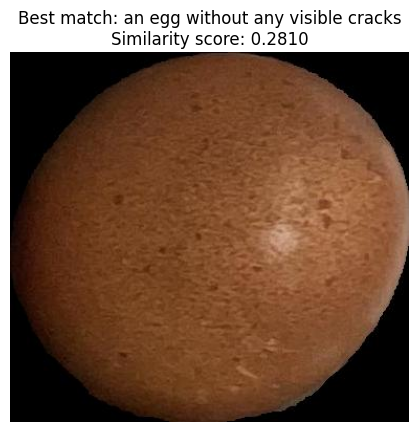

Image: maskegg_0_24.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.259765625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.250732421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.26171875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.259033203125
Description: an egg that has a hole, Similarity score: 0.25537109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.275146484375
Description: an egg with a broken shell, Similarity score: 0.2481689453125
Description: an egg that is damaged with cracks, Similarity score: 0.2646484375
Description: an egg that is completely intact with no cracks, Similarity score: 0.236572265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.25244140625
Description: an egg without any visible cracks, Similarity score: 0.281005859375
Descripti

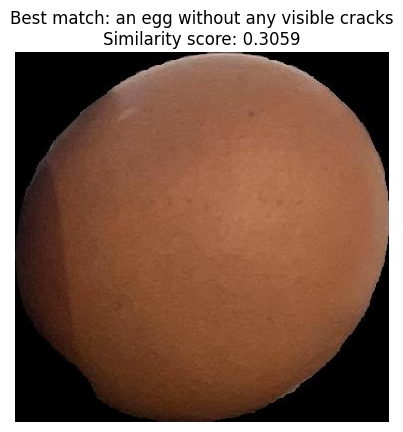

Image: maskegg_0_3.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.288818359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.276611328125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2861328125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28515625
Description: an egg that has a hole, Similarity score: 0.28759765625
Description: an egg with many edge cracks on its skin, Similarity score: 0.29443359375
Description: an egg with a broken shell, Similarity score: 0.280029296875
Description: an egg that is damaged with cracks, Similarity score: 0.28369140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.267333984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2763671875
Description: an egg without any visible cracks, Similarity score: 0.305908203125
Description

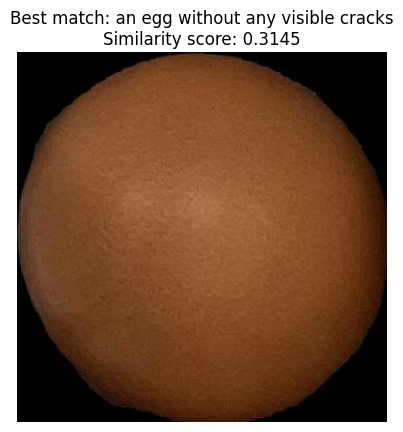

Image: maskegg_0_4.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.294921875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.275634765625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29638671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.289794921875
Description: an egg that has a hole, Similarity score: 0.292724609375
Description: an egg with many edge cracks on its skin, Similarity score: 0.306396484375
Description: an egg with a broken shell, Similarity score: 0.281494140625
Description: an egg that is damaged with cracks, Similarity score: 0.293701171875
Description: an egg that is completely intact with no cracks, Similarity score: 0.267578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.272216796875
Description: an egg without any visible cracks, Similarity score: 0.314453125
Descriptio

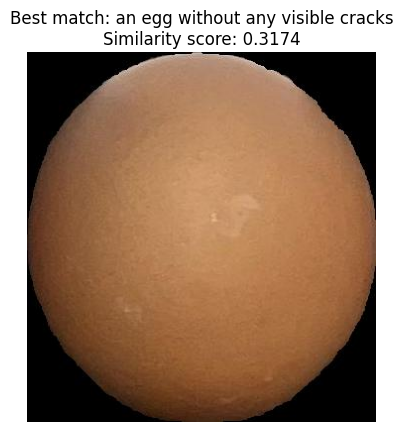

Image: maskegg_0_5.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.296630859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28271484375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29541015625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.289794921875
Description: an egg that has a hole, Similarity score: 0.29052734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.31201171875
Description: an egg with a broken shell, Similarity score: 0.28369140625
Description: an egg that is damaged with cracks, Similarity score: 0.303466796875
Description: an egg that is completely intact with no cracks, Similarity score: 0.27001953125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.278076171875
Description: an egg without any visible cracks, Similarity score: 0.3173828125
Descript

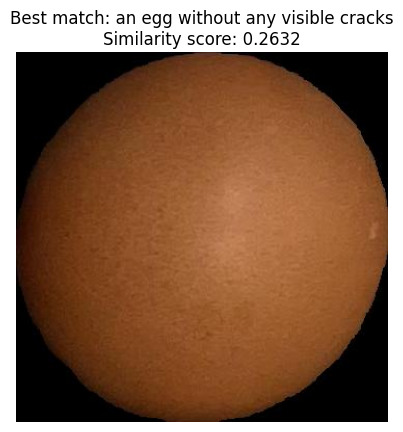

Image: maskegg_0_6.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.23974609375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.220703125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2420654296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.237548828125
Description: an egg that has a hole, Similarity score: 0.235595703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.256591796875
Description: an egg with a broken shell, Similarity score: 0.2197265625
Description: an egg that is damaged with cracks, Similarity score: 0.2421875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2078857421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2232666015625
Description: an egg without any visible cracks, Similarity score: 0.26318359375
Descripti

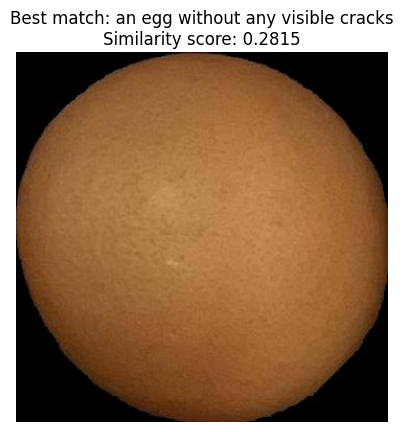

Image: maskegg_0_7.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.26220703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2447509765625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.264404296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.255615234375
Description: an egg that has a hole, Similarity score: 0.255859375
Description: an egg with many edge cracks on its skin, Similarity score: 0.275146484375
Description: an egg with a broken shell, Similarity score: 0.239501953125
Description: an egg that is damaged with cracks, Similarity score: 0.26220703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.232421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2413330078125
Description: an egg without any visible cracks, Similarity score: 0.281494140625
Descri

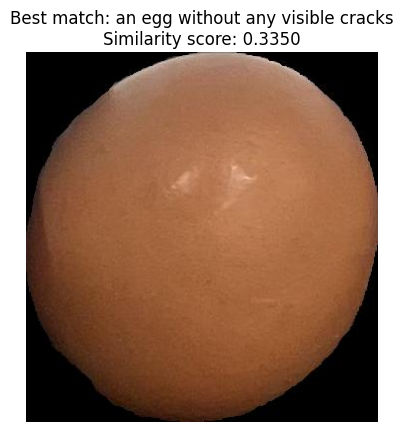

Image: maskegg_0_8.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.322021484375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.311767578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.318359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.315673828125
Description: an egg that has a hole, Similarity score: 0.31494140625
Description: an egg with many edge cracks on its skin, Similarity score: 0.328125
Description: an egg with a broken shell, Similarity score: 0.306884765625
Description: an egg that is damaged with cracks, Similarity score: 0.31884765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2958984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.306396484375
Description: an egg without any visible cracks, Similarity score: 0.3349609375
Description: an

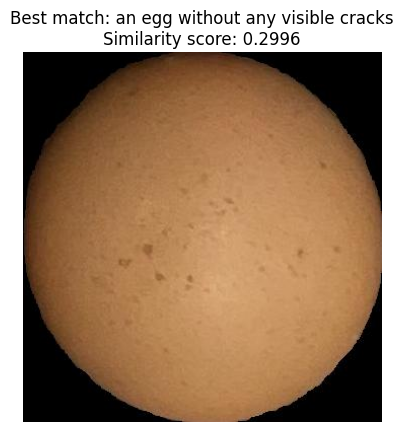

Image: maskegg_0_9.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.284912109375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.268798828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.282958984375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.272216796875
Description: an egg that has a hole, Similarity score: 0.279541015625
Description: an egg with many edge cracks on its skin, Similarity score: 0.2939453125
Description: an egg with a broken shell, Similarity score: 0.260986328125
Description: an egg that is damaged with cracks, Similarity score: 0.281494140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.25927734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.269287109375
Description: an egg without any visible cracks, Similarity score: 0.299560546875
Des

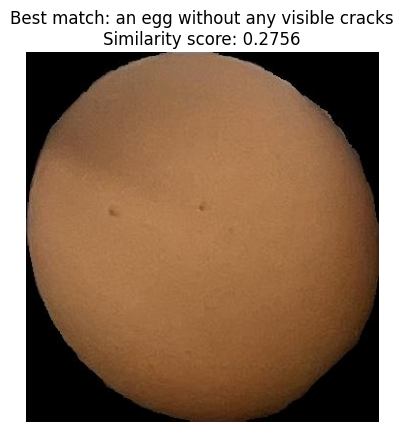

Image: maskegg_1_0.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.255126953125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.239013671875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.251220703125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.253662109375
Description: an egg that has a hole, Similarity score: 0.254150390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.266845703125
Description: an egg with a broken shell, Similarity score: 0.2344970703125
Description: an egg that is damaged with cracks, Similarity score: 0.25244140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2236328125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2357177734375
Description: an egg without any visible cracks, Similarity score: 0.275634765625
D

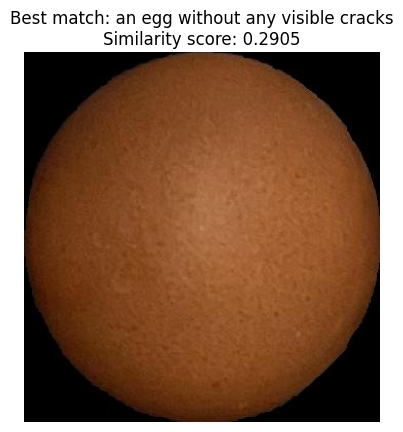

Image: maskegg_1_1.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.264892578125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2462158203125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.26806640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.259765625
Description: an egg that has a hole, Similarity score: 0.26171875
Description: an egg with many edge cracks on its skin, Similarity score: 0.2880859375
Description: an egg with a broken shell, Similarity score: 0.2449951171875
Description: an egg that is damaged with cracks, Similarity score: 0.276611328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2379150390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2457275390625
Description: an egg without any visible cracks, Similarity score: 0.29052734375
Descrip

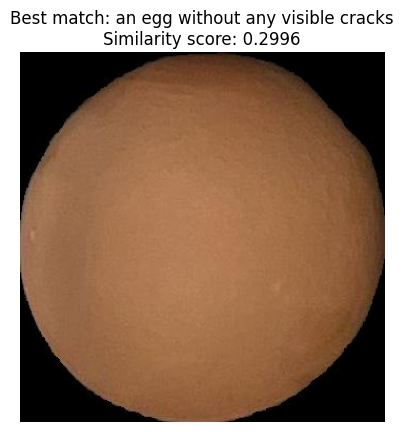

Image: maskegg_1_10.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2685546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.283935546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.279541015625
Description: an egg that has a hole, Similarity score: 0.279052734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.284912109375
Description: an egg with a broken shell, Similarity score: 0.27294921875
Description: an egg that is damaged with cracks, Similarity score: 0.272705078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.25732421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.263916015625
Description: an egg without any visible cracks, Similarity score: 0.299560546875
Descrip

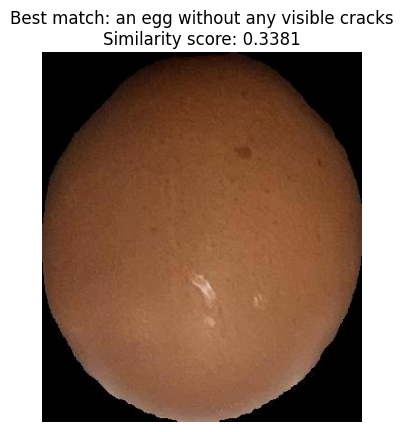

Image: maskegg_1_11.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.323486328125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.313232421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.322021484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.314453125
Description: an egg that has a hole, Similarity score: 0.318359375
Description: an egg with many edge cracks on its skin, Similarity score: 0.334228515625
Description: an egg with a broken shell, Similarity score: 0.305419921875
Description: an egg that is damaged with cracks, Similarity score: 0.32421875
Description: an egg that is completely intact with no cracks, Similarity score: 0.297607421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3056640625
Description: an egg without any visible cracks, Similarity score: 0.338134765625
Description

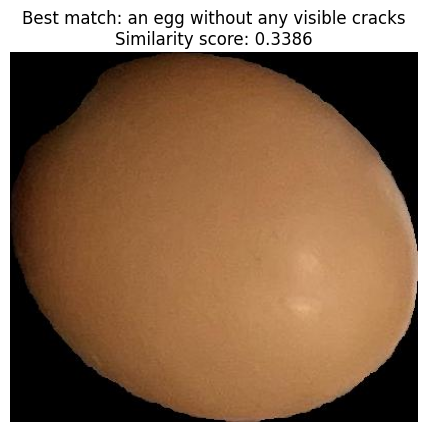

Image: maskegg_1_13.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3212890625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.31298828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.320556640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3203125
Description: an egg that has a hole, Similarity score: 0.317138671875
Description: an egg with many edge cracks on its skin, Similarity score: 0.328857421875
Description: an egg with a broken shell, Similarity score: 0.3125
Description: an egg that is damaged with cracks, Similarity score: 0.315673828125
Description: an egg that is completely intact with no cracks, Similarity score: 0.299560546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.309326171875
Description: an egg without any visible cracks, Similarity score: 0.338623046875
Description: an

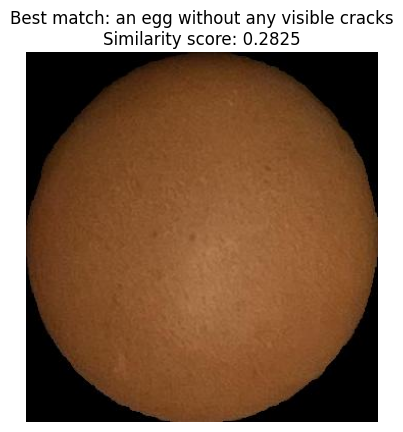

Image: maskegg_1_14.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.259765625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.241455078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2607421875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.25146484375
Description: an egg that has a hole, Similarity score: 0.253173828125
Description: an egg with many edge cracks on its skin, Similarity score: 0.273681640625
Description: an egg with a broken shell, Similarity score: 0.23828125
Description: an egg that is damaged with cracks, Similarity score: 0.26171875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2314453125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.23681640625
Description: an egg without any visible cracks, Similarity score: 0.282470703125
Description: an 

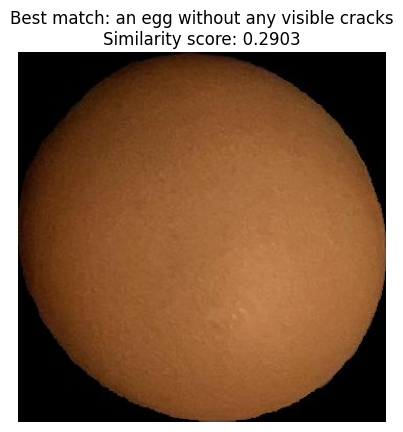

Image: maskegg_1_15.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2763671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.256103515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.274169921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.263671875
Description: an egg that has a hole, Similarity score: 0.271484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.281494140625
Description: an egg with a broken shell, Similarity score: 0.250732421875
Description: an egg that is damaged with cracks, Similarity score: 0.265869140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.24560546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2529296875
Description: an egg without any visible cracks, Similarity score: 0.290283203125
Descriptio

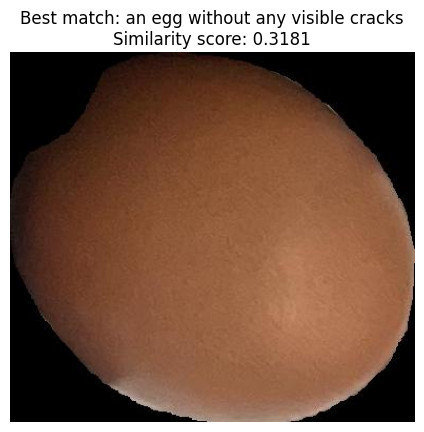

Image: maskegg_1_16.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.299072265625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28564453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.301025390625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.297607421875
Description: an egg that has a hole, Similarity score: 0.293212890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.311279296875
Description: an egg with a broken shell, Similarity score: 0.29052734375
Description: an egg that is damaged with cracks, Similarity score: 0.295166015625
Description: an egg that is completely intact with no cracks, Similarity score: 0.27294921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.28173828125
Description: an egg without any visible cracks, Similarity score: 0.318115234375
Des

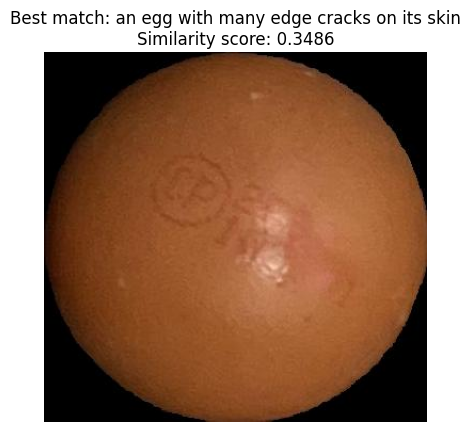

Image: maskegg_1_18.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.315673828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.300537109375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3193359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30908203125
Description: an egg that has a hole, Similarity score: 0.3125
Description: an egg with many edge cracks on its skin, Similarity score: 0.3486328125
Description: an egg with a broken shell, Similarity score: 0.308349609375
Description: an egg that is damaged with cracks, Similarity score: 0.34228515625
Description: an egg that is completely intact with no cracks, Similarity score: 0.28857421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29931640625
Description: an egg without any visible cracks, Similarity score: 0.333740234375
Description: an

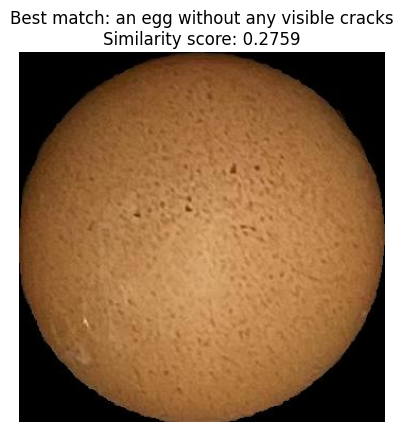

Image: maskegg_1_19.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.248779296875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.231689453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.25439453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.25
Description: an egg that has a hole, Similarity score: 0.2479248046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.2666015625
Description: an egg with a broken shell, Similarity score: 0.2333984375
Description: an egg that is damaged with cracks, Similarity score: 0.258544921875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2208251953125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2320556640625
Description: an egg without any visible cracks, Similarity score: 0.27587890625
Description:

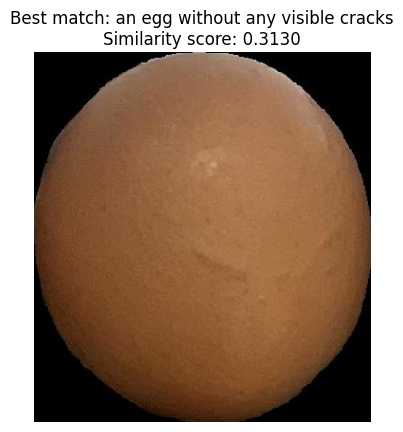

Image: maskegg_1_2.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.296630859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.282958984375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2939453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2890625
Description: an egg that has a hole, Similarity score: 0.284912109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.306884765625
Description: an egg with a broken shell, Similarity score: 0.2783203125
Description: an egg that is damaged with cracks, Similarity score: 0.2978515625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2685546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27392578125
Description: an egg without any visible cracks, Similarity score: 0.31298828125
Description: an

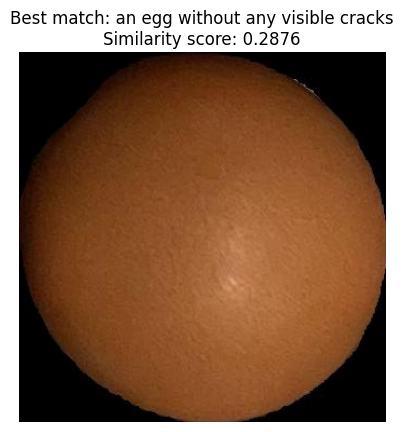

Image: maskegg_1_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.268798828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2529296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.26904296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.266357421875
Description: an egg that has a hole, Similarity score: 0.264404296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.28125
Description: an egg with a broken shell, Similarity score: 0.25146484375
Description: an egg that is damaged with cracks, Similarity score: 0.266845703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2413330078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2490234375
Description: an egg without any visible cracks, Similarity score: 0.28759765625
Description:

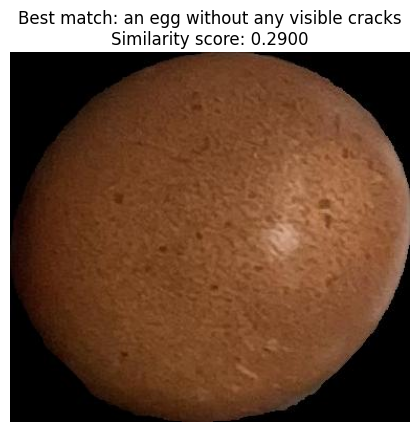

Image: maskegg_1_25.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.266357421875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2568359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.266357421875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2666015625
Description: an egg that has a hole, Similarity score: 0.265625
Description: an egg with many edge cracks on its skin, Similarity score: 0.2841796875
Description: an egg with a broken shell, Similarity score: 0.259765625
Description: an egg that is damaged with cracks, Similarity score: 0.274169921875
Description: an egg that is completely intact with no cracks, Similarity score: 0.24462890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.256103515625
Description: an egg without any visible cracks, Similarity score: 0.2900390625
Description: an e

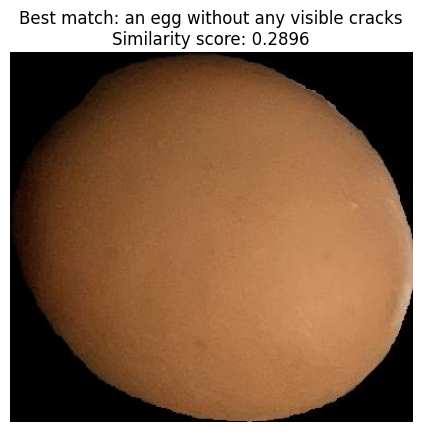

Image: maskegg_1_28.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.265625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.252197265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.265869140625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.267578125
Description: an egg that has a hole, Similarity score: 0.2587890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.2802734375
Description: an egg with a broken shell, Similarity score: 0.253173828125
Description: an egg that is damaged with cracks, Similarity score: 0.2685546875
Description: an egg that is completely intact with no cracks, Similarity score: 0.239990234375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2490234375
Description: an egg without any visible cracks, Similarity score: 0.28955078125
Description: an e

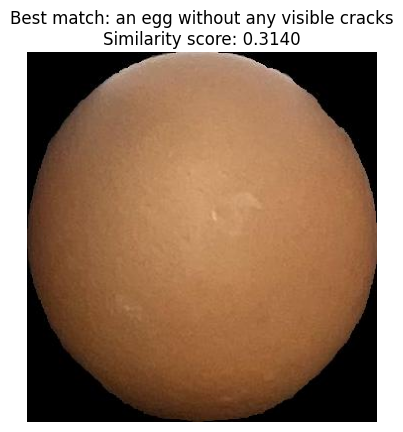

Image: maskegg_1_3.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29638671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28369140625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.294921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.291015625
Description: an egg that has a hole, Similarity score: 0.2900390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.306640625
Description: an egg with a broken shell, Similarity score: 0.282958984375
Description: an egg that is damaged with cracks, Similarity score: 0.2958984375
Description: an egg that is completely intact with no cracks, Similarity score: 0.2705078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.277099609375
Description: an egg without any visible cracks, Similarity score: 0.31396484375
Description: an eg

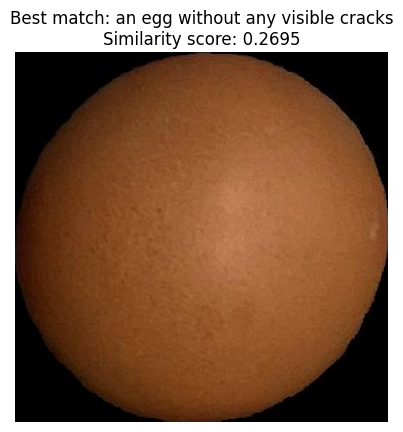

Image: maskegg_1_4.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2449951171875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2252197265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.247802734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.243408203125
Description: an egg that has a hole, Similarity score: 0.2403564453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.264404296875
Description: an egg with a broken shell, Similarity score: 0.225830078125
Description: an egg that is damaged with cracks, Similarity score: 0.2491455078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2110595703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.222900390625
Description: an egg without any visible cracks, Similarity score: 0.26953125

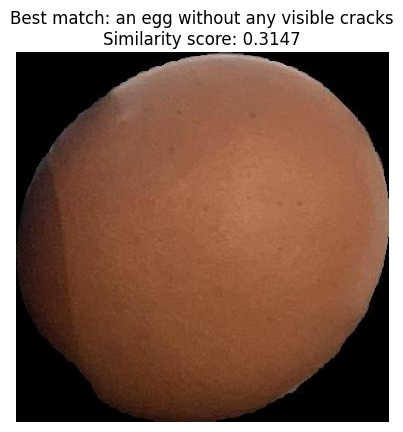

Image: maskegg_1_5.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.29443359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.281982421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.293212890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28955078125
Description: an egg that has a hole, Similarity score: 0.293212890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.3046875
Description: an egg with a broken shell, Similarity score: 0.283203125
Description: an egg that is damaged with cracks, Similarity score: 0.294677734375
Description: an egg that is completely intact with no cracks, Similarity score: 0.27294921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27978515625
Description: an egg without any visible cracks, Similarity score: 0.314697265625
Description:

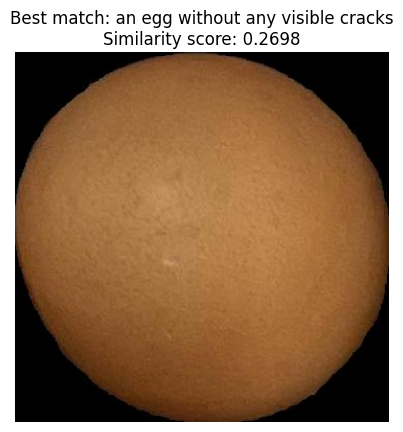

Image: maskegg_1_6.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.254638671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2354736328125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.252685546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2452392578125
Description: an egg that has a hole, Similarity score: 0.24462890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.259765625
Description: an egg with a broken shell, Similarity score: 0.228759765625
Description: an egg that is damaged with cracks, Similarity score: 0.2474365234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.220947265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2279052734375
Description: an egg without any visible cracks, Similarity score: 0.269775390625


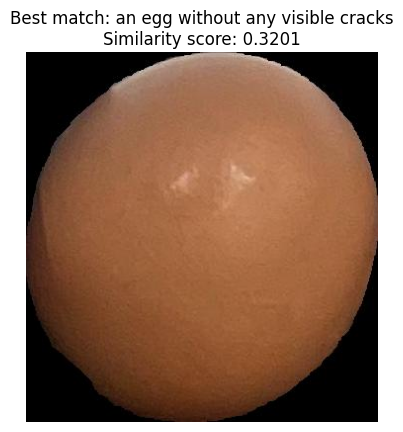

Image: maskegg_1_7.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.307373046875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.29541015625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.30126953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30126953125
Description: an egg that has a hole, Similarity score: 0.30078125
Description: an egg with many edge cracks on its skin, Similarity score: 0.310791015625
Description: an egg with a broken shell, Similarity score: 0.294189453125
Description: an egg that is damaged with cracks, Similarity score: 0.3017578125
Description: an egg that is completely intact with no cracks, Similarity score: 0.280029296875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29052734375
Description: an egg without any visible cracks, Similarity score: 0.320068359375
Descriptio

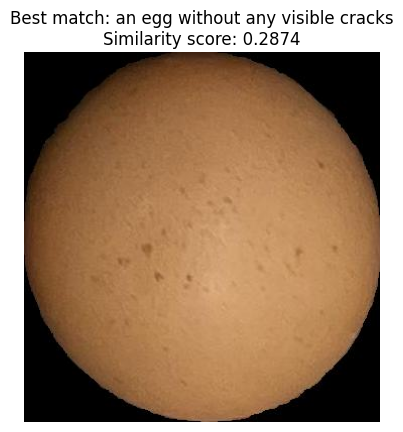

Image: maskegg_1_8.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.265869140625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.250732421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2685546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.26025390625
Description: an egg that has a hole, Similarity score: 0.26416015625
Description: an egg with many edge cracks on its skin, Similarity score: 0.2783203125
Description: an egg with a broken shell, Similarity score: 0.252197265625
Description: an egg that is damaged with cracks, Similarity score: 0.2705078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2359619140625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.245361328125
Description: an egg without any visible cracks, Similarity score: 0.287353515625
Descrip

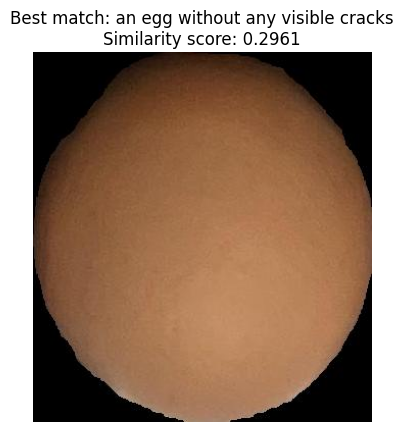

Image: maskegg_1_9.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.281005859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.265869140625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.279052734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.277099609375
Description: an egg that has a hole, Similarity score: 0.275146484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.28173828125
Description: an egg with a broken shell, Similarity score: 0.2705078125
Description: an egg that is damaged with cracks, Similarity score: 0.267578125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26416015625
Description: an egg without any visible cracks, Similarity score: 0.296142578125
Description:

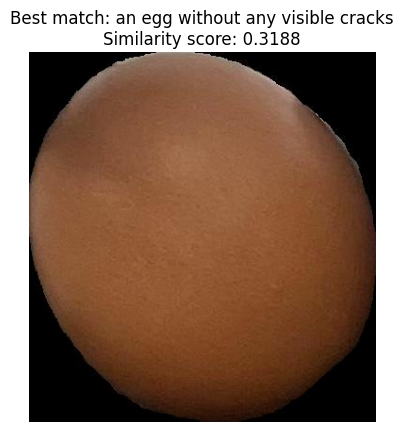

Image: maskegg_2_0.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.304931640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.291015625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3017578125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.299072265625
Description: an egg that has a hole, Similarity score: 0.298583984375
Description: an egg with many edge cracks on its skin, Similarity score: 0.310302734375
Description: an egg with a broken shell, Similarity score: 0.291748046875
Description: an egg that is damaged with cracks, Similarity score: 0.2939453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.275634765625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.28466796875
Description: an egg without any visible cracks, Similarity score: 0.31884765625
Descripti

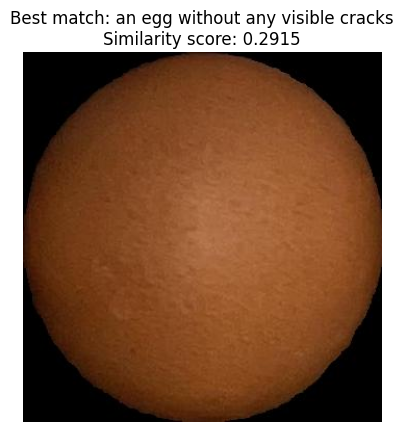

Image: maskegg_2_1.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.274658203125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.25634765625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.27392578125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.266845703125
Description: an egg that has a hole, Similarity score: 0.2705078125
Description: an egg with many edge cracks on its skin, Similarity score: 0.28564453125
Description: an egg with a broken shell, Similarity score: 0.25439453125
Description: an egg that is damaged with cracks, Similarity score: 0.273193359375
Description: an egg that is completely intact with no cracks, Similarity score: 0.246337890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.25439453125
Description: an egg without any visible cracks, Similarity score: 0.29150390625
Descript

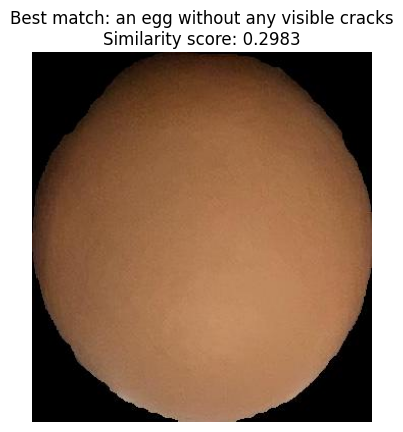

Image: maskegg_2_10.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.279541015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.264892578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.280029296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.275146484375
Description: an egg that has a hole, Similarity score: 0.273193359375
Description: an egg with many edge cracks on its skin, Similarity score: 0.2841796875
Description: an egg with a broken shell, Similarity score: 0.268310546875
Description: an egg that is damaged with cracks, Similarity score: 0.268310546875
Description: an egg that is completely intact with no cracks, Similarity score: 0.25390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2607421875
Description: an egg without any visible cracks, Similarity score: 0.29833984375
Descript

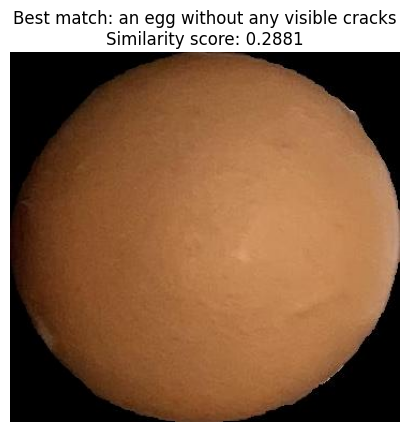

Image: maskegg_2_11.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.27197265625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.259765625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.27099609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.26953125
Description: an egg that has a hole, Similarity score: 0.26318359375
Description: an egg with many edge cracks on its skin, Similarity score: 0.278564453125
Description: an egg with a broken shell, Similarity score: 0.25830078125
Description: an egg that is damaged with cracks, Similarity score: 0.26416015625
Description: an egg that is completely intact with no cracks, Similarity score: 0.241455078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.24951171875
Description: an egg without any visible cracks, Similarity score: 0.2880859375
Description: a

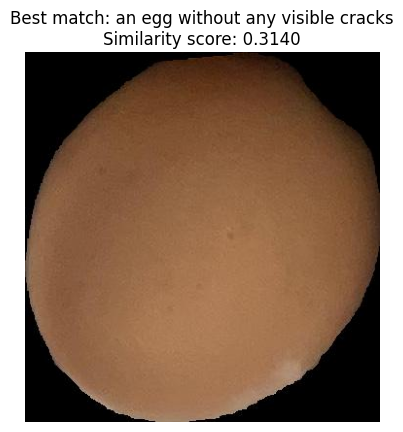

Image: maskegg_2_12.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.291259765625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28173828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.292724609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2890625
Description: an egg that has a hole, Similarity score: 0.2890625
Description: an egg with many edge cracks on its skin, Similarity score: 0.29833984375
Description: an egg with a broken shell, Similarity score: 0.28125
Description: an egg that is damaged with cracks, Similarity score: 0.288330078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.268310546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.278076171875
Description: an egg without any visible cracks, Similarity score: 0.31396484375
Description: an egg

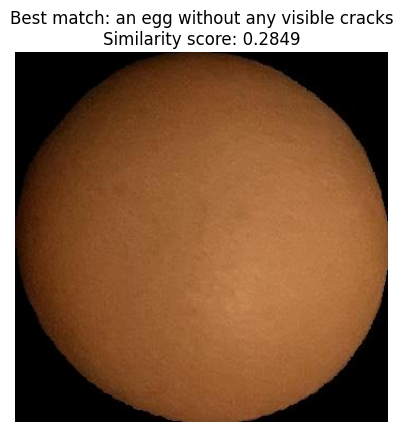

Image: maskegg_2_13.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.26708984375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.24755859375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.266845703125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.259521484375
Description: an egg that has a hole, Similarity score: 0.264892578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.2763671875
Description: an egg with a broken shell, Similarity score: 0.245361328125
Description: an egg that is damaged with cracks, Similarity score: 0.257080078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.238037109375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2451171875
Description: an egg without any visible cracks, Similarity score: 0.284912109375
Descr

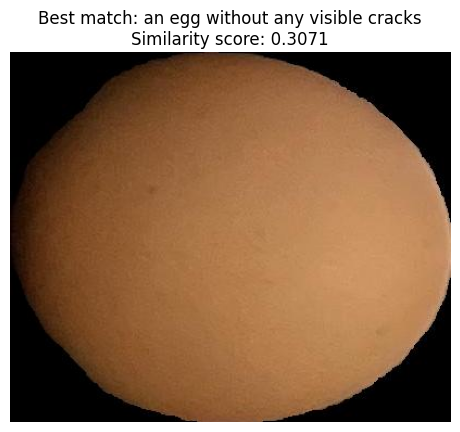

Image: maskegg_2_14.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28955078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27197265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.288818359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28125
Description: an egg that has a hole, Similarity score: 0.29150390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.296142578125
Description: an egg with a broken shell, Similarity score: 0.27099609375
Description: an egg that is damaged with cracks, Similarity score: 0.276611328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.260986328125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2685546875
Description: an egg without any visible cracks, Similarity score: 0.30712890625
Description: 

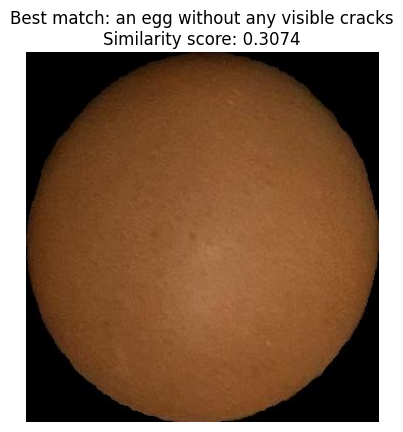

Image: maskegg_2_16.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2890625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27490234375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.290771484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.28076171875
Description: an egg that has a hole, Similarity score: 0.283203125
Description: an egg with many edge cracks on its skin, Similarity score: 0.298583984375
Description: an egg with a broken shell, Similarity score: 0.267578125
Description: an egg that is damaged with cracks, Similarity score: 0.285400390625
Description: an egg that is completely intact with no cracks, Similarity score: 0.26171875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.26904296875
Description: an egg without any visible cracks, Similarity score: 0.307373046875
Description: an e

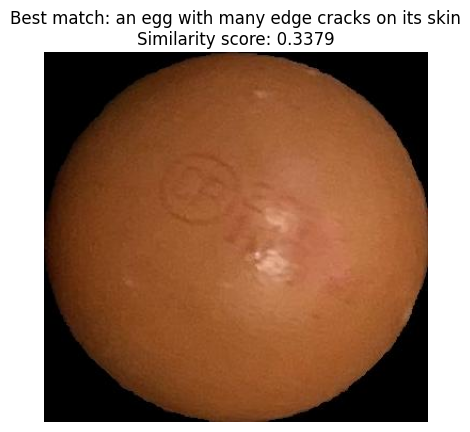

Image: maskegg_2_17.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3095703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.29248046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.308837890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.30419921875
Description: an egg that has a hole, Similarity score: 0.304931640625
Description: an egg with many edge cracks on its skin, Similarity score: 0.337890625
Description: an egg with a broken shell, Similarity score: 0.299072265625
Description: an egg that is damaged with cracks, Similarity score: 0.324951171875
Description: an egg that is completely intact with no cracks, Similarity score: 0.277099609375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.290771484375
Description: an egg without any visible cracks, Similarity score: 0.3251953125
Descript

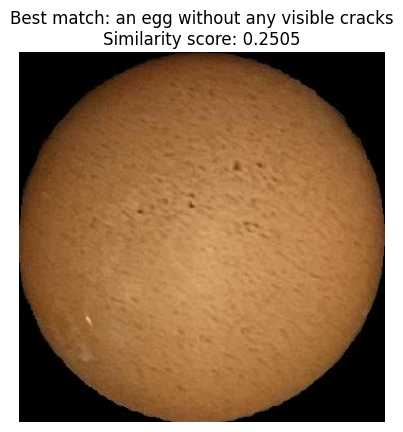

Image: maskegg_2_18.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2294921875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.212646484375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.23095703125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2325439453125
Description: an egg that has a hole, Similarity score: 0.2236328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.2391357421875
Description: an egg with a broken shell, Similarity score: 0.21435546875
Description: an egg that is damaged with cracks, Similarity score: 0.229736328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.197509765625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2110595703125
Description: an egg without any visible cracks, Similarity score: 0.25048828125
Des

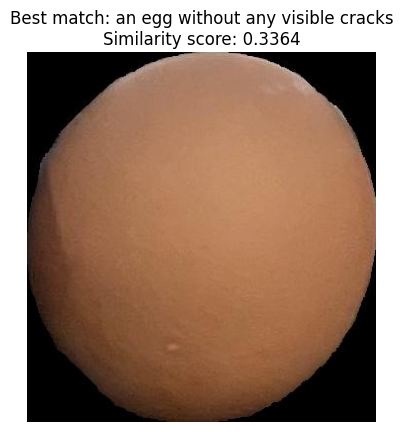

Image: maskegg_2_2.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.313232421875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.30078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.314453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.315673828125
Description: an egg that has a hole, Similarity score: 0.3095703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.326416015625
Description: an egg with a broken shell, Similarity score: 0.30517578125
Description: an egg that is damaged with cracks, Similarity score: 0.31640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.28955078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29931640625
Description: an egg without any visible cracks, Similarity score: 0.33642578125
Description: an e

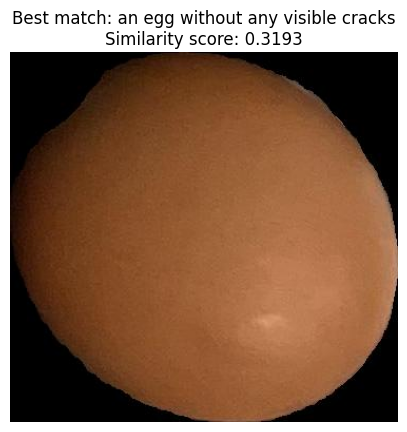

Image: maskegg_2_20.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.304931640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.295654296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3046875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.301513671875
Description: an egg that has a hole, Similarity score: 0.298095703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.30859375
Description: an egg with a broken shell, Similarity score: 0.292236328125
Description: an egg that is damaged with cracks, Similarity score: 0.29345703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.28125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29248046875
Description: an egg without any visible cracks, Similarity score: 0.3193359375
Description: an egg

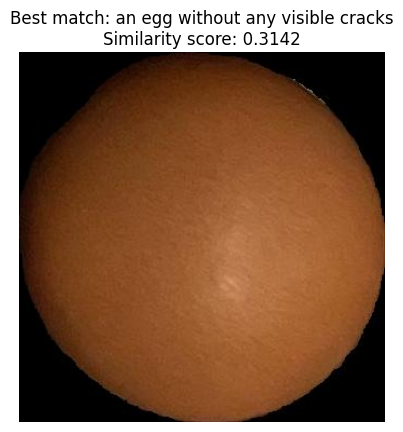

Image: maskegg_2_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.298095703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.281005859375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29541015625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.29248046875
Description: an egg that has a hole, Similarity score: 0.290283203125
Description: an egg with many edge cracks on its skin, Similarity score: 0.310791015625
Description: an egg with a broken shell, Similarity score: 0.275634765625
Description: an egg that is damaged with cracks, Similarity score: 0.291259765625
Description: an egg that is completely intact with no cracks, Similarity score: 0.267578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.275634765625
Description: an egg without any visible cracks, Similarity score: 0.314208984375
Desc

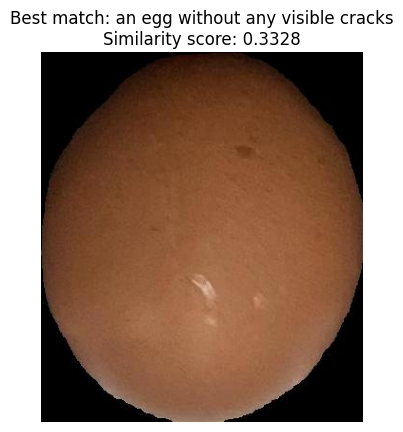

Image: maskegg_2_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.3173828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.31103515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.314697265625
Description: an egg that has a hole, Similarity score: 0.313232421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.329833984375
Description: an egg with a broken shell, Similarity score: 0.3076171875
Description: an egg that is damaged with cracks, Similarity score: 0.318359375
Description: an egg that is completely intact with no cracks, Similarity score: 0.296142578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3037109375
Description: an egg without any visible cracks, Similarity score: 0.332763671875
Description: 

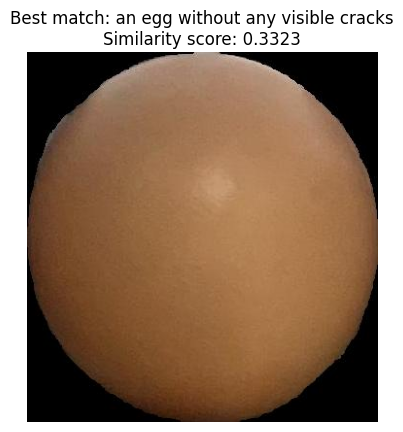

Image: maskegg_2_3.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.31591796875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.309326171875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.314453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.312255859375
Description: an egg that has a hole, Similarity score: 0.3095703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.32177734375
Description: an egg with a broken shell, Similarity score: 0.303466796875
Description: an egg that is damaged with cracks, Similarity score: 0.309814453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.294677734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.303955078125
Description: an egg without any visible cracks, Similarity score: 0.332275390625
Descrip

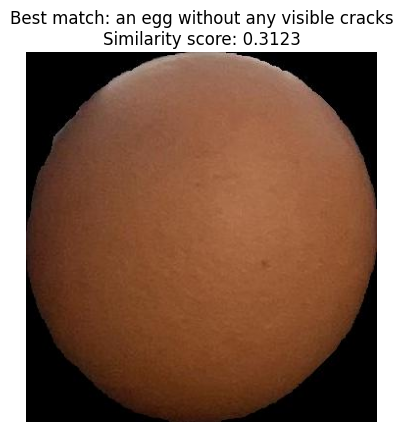

Image: maskegg_2_4.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.298583984375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.282470703125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.296630859375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2880859375
Description: an egg that has a hole, Similarity score: 0.29150390625
Description: an egg with many edge cracks on its skin, Similarity score: 0.308837890625
Description: an egg with a broken shell, Similarity score: 0.277587890625
Description: an egg that is damaged with cracks, Similarity score: 0.29345703125
Description: an egg that is completely intact with no cracks, Similarity score: 0.266357421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.276123046875
Description: an egg without any visible cracks, Similarity score: 0.312255859375
Desc

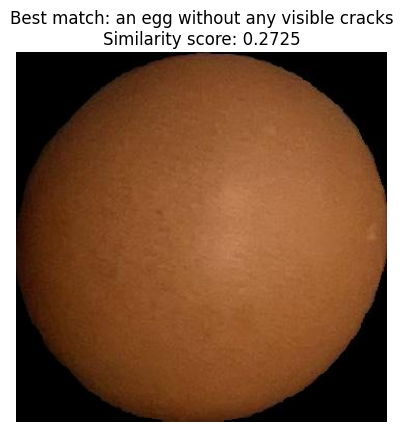

Image: maskegg_2_5.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.248779296875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.232421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2529296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2476806640625
Description: an egg that has a hole, Similarity score: 0.243408203125
Description: an egg with many edge cracks on its skin, Similarity score: 0.268310546875
Description: an egg with a broken shell, Similarity score: 0.23388671875
Description: an egg that is damaged with cracks, Similarity score: 0.252685546875
Description: an egg that is completely intact with no cracks, Similarity score: 0.21630859375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.228515625
Description: an egg without any visible cracks, Similarity score: 0.2724609375
Description

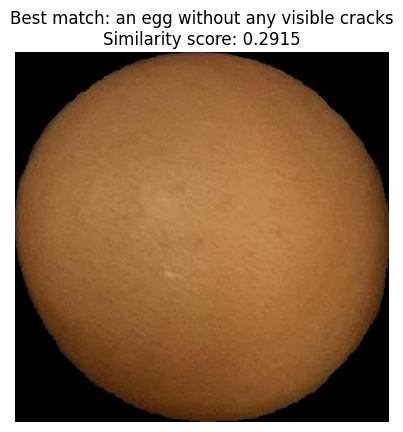

Image: maskegg_2_6.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.270263671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.25341796875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.271728515625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.263427734375
Description: an egg that has a hole, Similarity score: 0.266357421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.284423828125
Description: an egg with a broken shell, Similarity score: 0.244384765625
Description: an egg that is damaged with cracks, Similarity score: 0.26513671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.23779296875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.248046875
Description: an egg without any visible cracks, Similarity score: 0.29150390625
Descrip

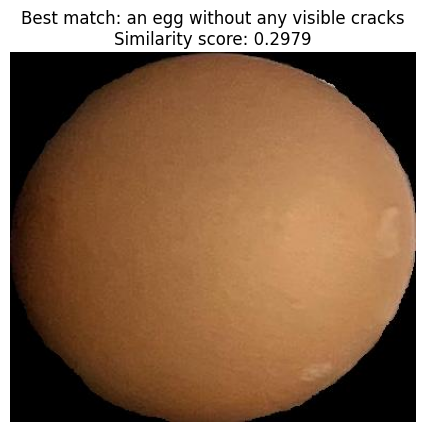

Image: maskegg_2_7.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2822265625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.266845703125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.27734375
Description: an egg that has a hole, Similarity score: 0.28125
Description: an egg with many edge cracks on its skin, Similarity score: 0.29248046875
Description: an egg with a broken shell, Similarity score: 0.2724609375
Description: an egg that is damaged with cracks, Similarity score: 0.274658203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.249267578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.261962890625
Description: an egg without any visible cracks, Similarity score: 0.2978515625
Description: an egg that 

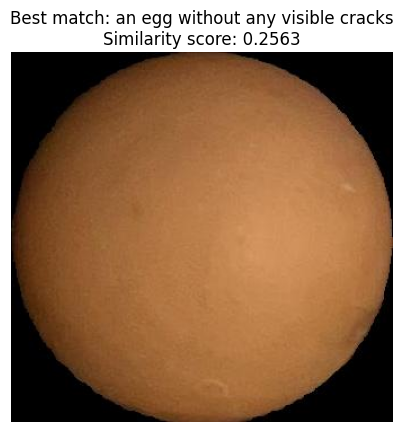

Image: maskegg_2_8.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2366943359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.21630859375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2386474609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2352294921875
Description: an egg that has a hole, Similarity score: 0.232421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.2442626953125
Description: an egg with a broken shell, Similarity score: 0.220947265625
Description: an egg that is damaged with cracks, Similarity score: 0.2353515625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2088623046875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2137451171875
Description: an egg without any visible cracks, Similarity score: 0.25634765625
D

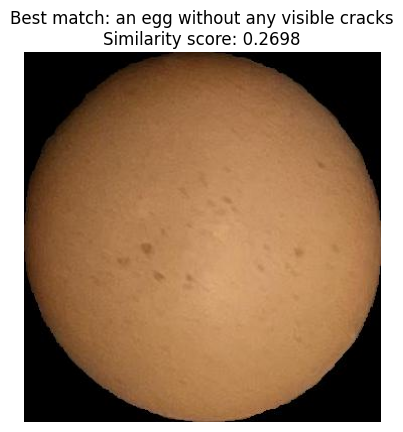

Image: maskegg_2_9.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.247314453125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.230224609375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2491455078125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.240234375
Description: an egg that has a hole, Similarity score: 0.2421875
Description: an egg with many edge cracks on its skin, Similarity score: 0.260986328125
Description: an egg with a broken shell, Similarity score: 0.2283935546875
Description: an egg that is damaged with cracks, Similarity score: 0.249755859375
Description: an egg that is completely intact with no cracks, Similarity score: 0.2171630859375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.22705078125
Description: an egg without any visible cracks, Similarity score: 0.269775390625
Descri

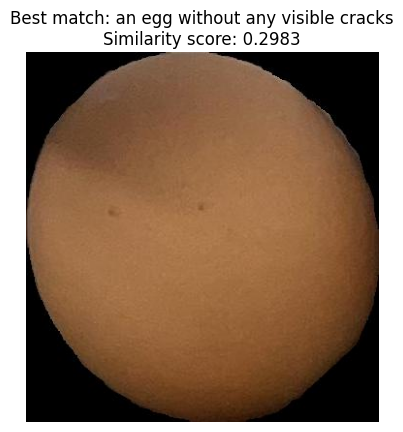

Image: maskegg_3_0.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.281005859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2685546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.279052734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.275390625
Description: an egg that has a hole, Similarity score: 0.2802734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.289306640625
Description: an egg with a broken shell, Similarity score: 0.261474609375
Description: an egg that is damaged with cracks, Similarity score: 0.275390625
Description: an egg that is completely intact with no cracks, Similarity score: 0.248046875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.264404296875
Description: an egg without any visible cracks, Similarity score: 0.29833984375
Description: a

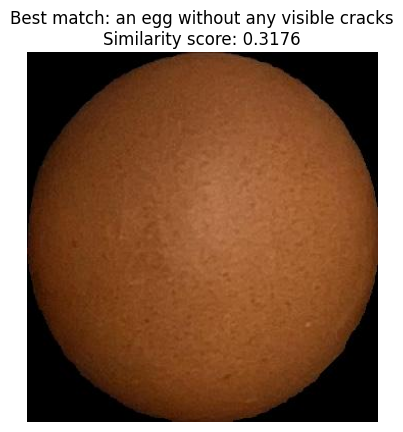

Image: maskegg_3_1.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.301025390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2861328125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.301025390625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.287353515625
Description: an egg that has a hole, Similarity score: 0.29248046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.3115234375
Description: an egg with a broken shell, Similarity score: 0.2763671875
Description: an egg that is damaged with cracks, Similarity score: 0.30517578125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2763671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2822265625
Description: an egg without any visible cracks, Similarity score: 0.317626953125
Description:

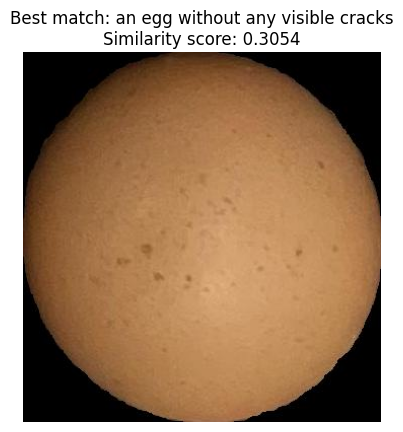

Image: maskegg_3_10.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.289306640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.273193359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29052734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2822265625
Description: an egg that has a hole, Similarity score: 0.290771484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.296875
Description: an egg with a broken shell, Similarity score: 0.275390625
Description: an egg that is damaged with cracks, Similarity score: 0.286865234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.258544921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.269775390625
Description: an egg without any visible cracks, Similarity score: 0.305419921875
Description

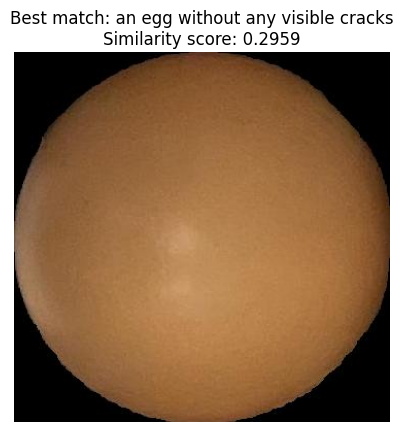

Image: maskegg_3_11.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.27685546875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.260498046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.27783203125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.271728515625
Description: an egg that has a hole, Similarity score: 0.2685546875
Description: an egg with many edge cracks on its skin, Similarity score: 0.284423828125
Description: an egg with a broken shell, Similarity score: 0.25927734375
Description: an egg that is damaged with cracks, Similarity score: 0.27001953125
Description: an egg that is completely intact with no cracks, Similarity score: 0.24755859375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.260009765625
Description: an egg without any visible cracks, Similarity score: 0.2958984375
Descript

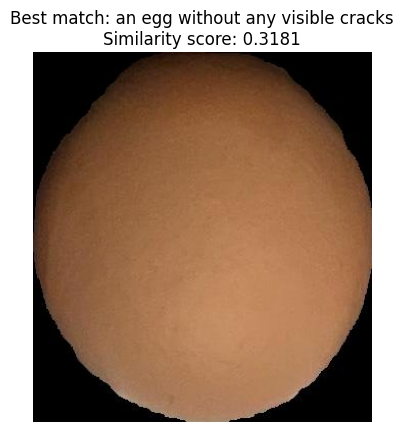

Image: maskegg_3_12.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.297119140625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.287353515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.297607421875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.29541015625
Description: an egg that has a hole, Similarity score: 0.291015625
Description: an egg with many edge cracks on its skin, Similarity score: 0.303466796875
Description: an egg with a broken shell, Similarity score: 0.28759765625
Description: an egg that is damaged with cracks, Similarity score: 0.290283203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.27197265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.281494140625
Description: an egg without any visible cracks, Similarity score: 0.318115234375
Descr

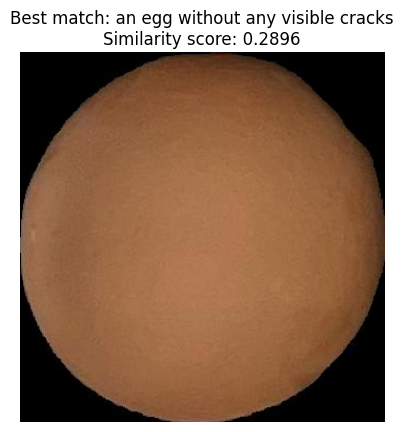

Image: maskegg_3_13.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2734375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2568359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.274169921875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.268310546875
Description: an egg that has a hole, Similarity score: 0.26708984375
Description: an egg with many edge cracks on its skin, Similarity score: 0.273193359375
Description: an egg with a broken shell, Similarity score: 0.2607421875
Description: an egg that is damaged with cracks, Similarity score: 0.261474609375
Description: an egg that is completely intact with no cracks, Similarity score: 0.2442626953125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.251220703125
Description: an egg without any visible cracks, Similarity score: 0.28955078125
Descripti

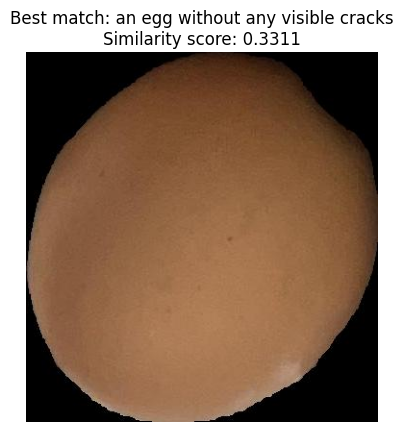

Image: maskegg_3_14.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.319091796875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.311767578125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.317626953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31103515625
Description: an egg that has a hole, Similarity score: 0.31201171875
Description: an egg with many edge cracks on its skin, Similarity score: 0.320068359375
Description: an egg with a broken shell, Similarity score: 0.30419921875
Description: an egg that is damaged with cracks, Similarity score: 0.303955078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.29541015625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.3037109375
Description: an egg without any visible cracks, Similarity score: 0.3310546875
Descrip

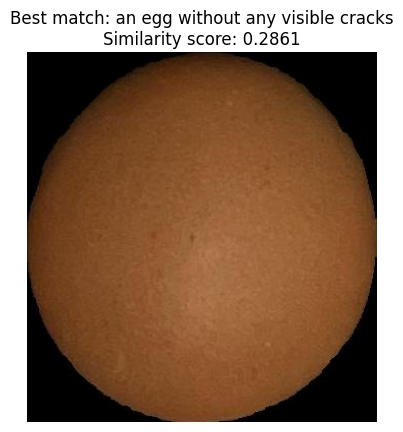

Image: maskegg_3_15.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.257080078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2373046875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2626953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.25634765625
Description: an egg that has a hole, Similarity score: 0.256103515625
Description: an egg with many edge cracks on its skin, Similarity score: 0.27880859375
Description: an egg with a broken shell, Similarity score: 0.2398681640625
Description: an egg that is damaged with cracks, Similarity score: 0.2666015625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2283935546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.23681640625
Description: an egg without any visible cracks, Similarity score: 0.2861328125
Descript

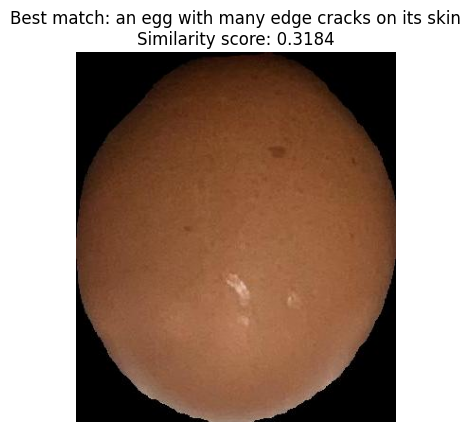

Image: maskegg_3_16.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.300537109375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.287109375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29931640625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.293212890625
Description: an egg that has a hole, Similarity score: 0.29443359375
Description: an egg with many edge cracks on its skin, Similarity score: 0.318359375
Description: an egg with a broken shell, Similarity score: 0.285400390625
Description: an egg that is damaged with cracks, Similarity score: 0.308837890625
Description: an egg that is completely intact with no cracks, Similarity score: 0.276123046875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.283935546875
Description: an egg without any visible cracks, Similarity score: 0.318359375
Descriptio

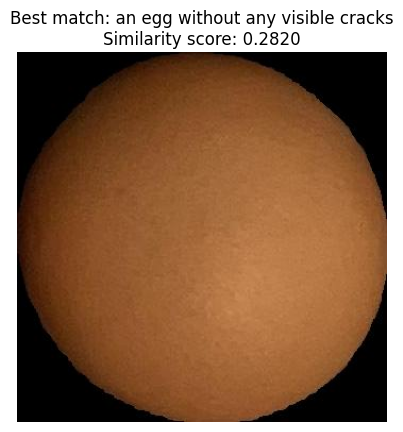

Image: maskegg_3_17.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.259521484375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2391357421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.26220703125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.255859375
Description: an egg that has a hole, Similarity score: 0.256591796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.274658203125
Description: an egg with a broken shell, Similarity score: 0.2413330078125
Description: an egg that is damaged with cracks, Similarity score: 0.258544921875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2254638671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.234130859375
Description: an egg without any visible cracks, Similarity score: 0.281982421875


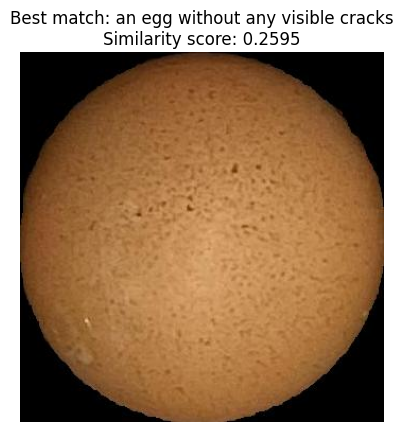

Image: maskegg_3_19.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.231689453125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2149658203125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2364501953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.23681640625
Description: an egg that has a hole, Similarity score: 0.233642578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.2498779296875
Description: an egg with a broken shell, Similarity score: 0.21923828125
Description: an egg that is damaged with cracks, Similarity score: 0.240234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.206298828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.22021484375
Description: an egg without any visible cracks, Similarity score: 0.259521484375
De

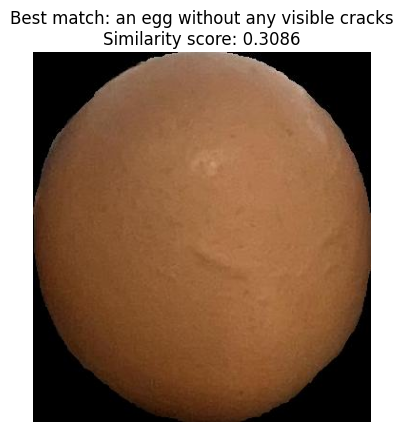

Image: maskegg_3_2.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2919921875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.287841796875
Description: an egg that has a hole, Similarity score: 0.28271484375
Description: an egg with many edge cracks on its skin, Similarity score: 0.299560546875
Description: an egg with a broken shell, Similarity score: 0.280029296875
Description: an egg that is damaged with cracks, Similarity score: 0.2900390625
Description: an egg that is completely intact with no cracks, Similarity score: 0.27001953125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.276123046875
Description: an egg without any visible cracks, Similarity score: 0.30859375
Description: an egg th

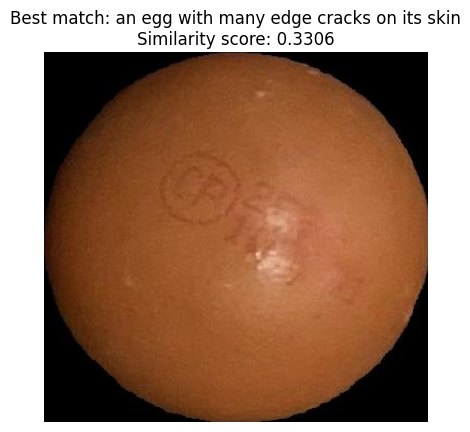

Image: maskegg_3_20.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.302978515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.287353515625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.302978515625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.295166015625
Description: an egg that has a hole, Similarity score: 0.298583984375
Description: an egg with many edge cracks on its skin, Similarity score: 0.33056640625
Description: an egg with a broken shell, Similarity score: 0.293701171875
Description: an egg that is damaged with cracks, Similarity score: 0.317626953125
Description: an egg that is completely intact with no cracks, Similarity score: 0.270263671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.283203125
Description: an egg without any visible cracks, Similarity score: 0.3154296875
Descr

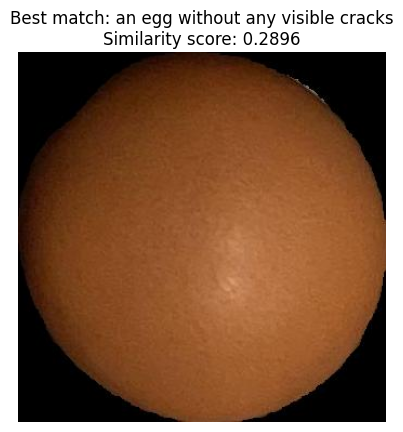

Image: maskegg_3_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.26953125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2486572265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.271240234375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.26806640625
Description: an egg that has a hole, Similarity score: 0.268310546875
Description: an egg with many edge cracks on its skin, Similarity score: 0.2880859375
Description: an egg with a broken shell, Similarity score: 0.25146484375
Description: an egg that is damaged with cracks, Similarity score: 0.270263671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2357177734375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2457275390625
Description: an egg without any visible cracks, Similarity score: 0.28955078125
Descr

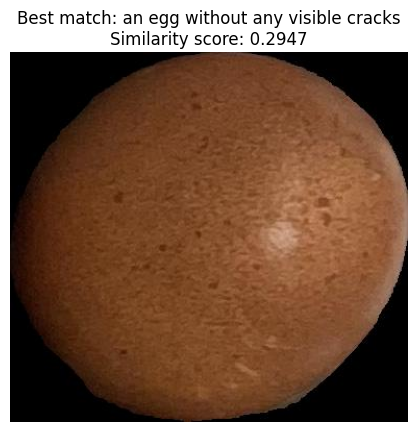

Image: maskegg_3_22.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.26953125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.25830078125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.273193359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.268798828125
Description: an egg that has a hole, Similarity score: 0.266845703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.29150390625
Description: an egg with a broken shell, Similarity score: 0.261962890625
Description: an egg that is damaged with cracks, Similarity score: 0.281494140625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2479248046875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.261474609375
Description: an egg without any visible cracks, Similarity score: 0.294677734375
Desc

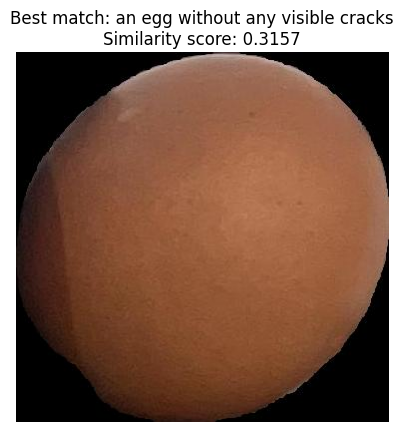

Image: maskegg_3_3.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.298095703125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28466796875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29638671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.29638671875
Description: an egg that has a hole, Similarity score: 0.296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.306640625
Description: an egg with a broken shell, Similarity score: 0.2890625
Description: an egg that is damaged with cracks, Similarity score: 0.296142578125
Description: an egg that is completely intact with no cracks, Similarity score: 0.27294921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.28271484375
Description: an egg without any visible cracks, Similarity score: 0.315673828125
Description: an egg

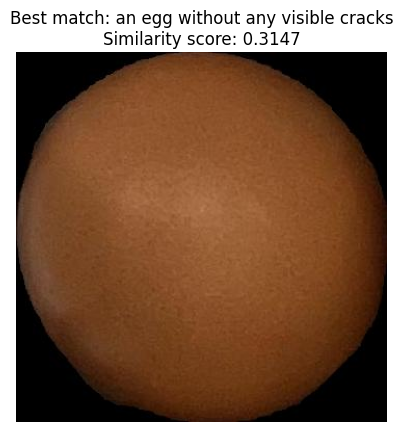

Image: maskegg_3_4.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.295166015625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2783203125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29833984375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.289794921875
Description: an egg that has a hole, Similarity score: 0.29052734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.306884765625
Description: an egg with a broken shell, Similarity score: 0.28076171875
Description: an egg that is damaged with cracks, Similarity score: 0.29296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.268798828125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27490234375
Description: an egg without any visible cracks, Similarity score: 0.314697265625
Descriptio

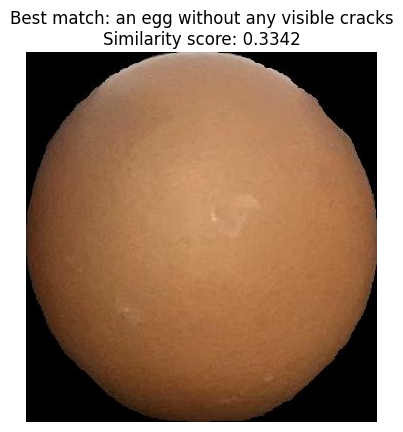

Image: maskegg_3_5.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.315673828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.303466796875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3134765625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.310302734375
Description: an egg that has a hole, Similarity score: 0.307861328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.329345703125
Description: an egg with a broken shell, Similarity score: 0.300048828125
Description: an egg that is damaged with cracks, Similarity score: 0.320556640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.29638671875
Description: an egg without any visible cracks, Similarity score: 0.334228515625
Descript

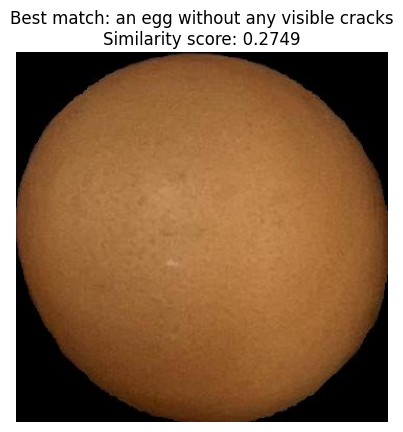

Image: maskegg_3_6.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.25048828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.23193359375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.25439453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.24853515625
Description: an egg that has a hole, Similarity score: 0.24755859375
Description: an egg with many edge cracks on its skin, Similarity score: 0.2666015625
Description: an egg with a broken shell, Similarity score: 0.23095703125
Description: an egg that is damaged with cracks, Similarity score: 0.25390625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2198486328125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2325439453125
Description: an egg without any visible cracks, Similarity score: 0.27490234375
Description

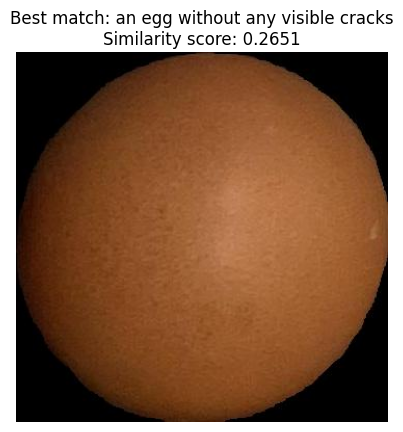

Image: maskegg_3_7.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2366943359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.219482421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2427978515625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2410888671875
Description: an egg that has a hole, Similarity score: 0.23681640625
Description: an egg with many edge cracks on its skin, Similarity score: 0.26220703125
Description: an egg with a broken shell, Similarity score: 0.2286376953125
Description: an egg that is damaged with cracks, Similarity score: 0.25
Description: an egg that is completely intact with no cracks, Similarity score: 0.205810546875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.220458984375
Description: an egg without any visible cracks, Similarity score: 0.26513671875
Descripti

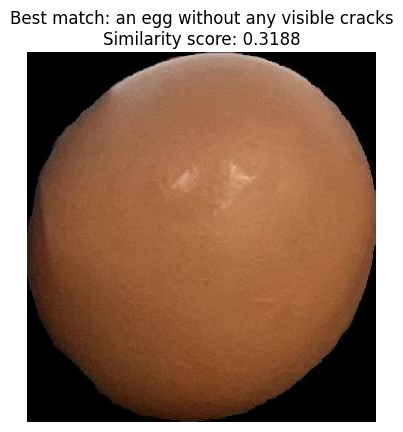

Image: maskegg_3_8.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.305419921875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.294677734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.299560546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.298828125
Description: an egg that has a hole, Similarity score: 0.298583984375
Description: an egg with many edge cracks on its skin, Similarity score: 0.310302734375
Description: an egg with a broken shell, Similarity score: 0.292236328125
Description: an egg that is damaged with cracks, Similarity score: 0.2998046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.278076171875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.288330078125
Description: an egg without any visible cracks, Similarity score: 0.31884765625
Descri

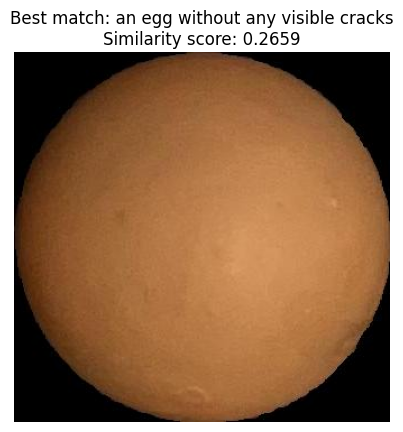

Image: maskegg_3_9.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2452392578125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.22900390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.247802734375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2462158203125
Description: an egg that has a hole, Similarity score: 0.24267578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.252685546875
Description: an egg with a broken shell, Similarity score: 0.235107421875
Description: an egg that is damaged with cracks, Similarity score: 0.245361328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.218017578125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2252197265625
Description: an egg without any visible cracks, Similarity score: 0.265869140625

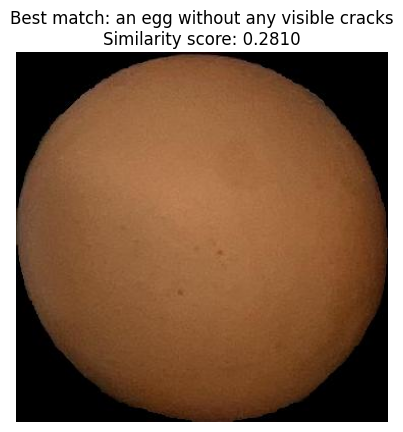

Image: maskegg_4_0.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.25830078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.23974609375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2607421875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.255859375
Description: an egg that has a hole, Similarity score: 0.254638671875
Description: an egg with many edge cracks on its skin, Similarity score: 0.27001953125
Description: an egg with a broken shell, Similarity score: 0.2386474609375
Description: an egg that is damaged with cracks, Similarity score: 0.2568359375
Description: an egg that is completely intact with no cracks, Similarity score: 0.22705078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.237548828125
Description: an egg without any visible cracks, Similarity score: 0.281005859375
Descriptio

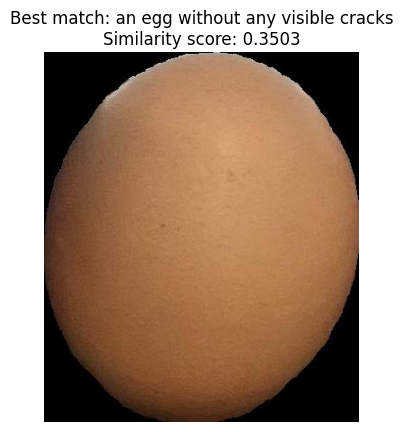

Image: maskegg_4_1.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.341064453125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.332275390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.341064453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.336181640625
Description: an egg that has a hole, Similarity score: 0.338623046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.344482421875
Description: an egg with a broken shell, Similarity score: 0.326904296875
Description: an egg that is damaged with cracks, Similarity score: 0.331298828125
Description: an egg that is completely intact with no cracks, Similarity score: 0.314697265625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.322998046875
Description: an egg without any visible cracks, Similarity score: 0.350341796875


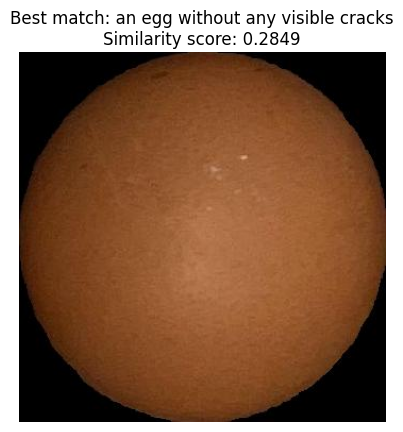

Image: maskegg_4_10.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.264404296875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2481689453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.267578125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.25927734375
Description: an egg that has a hole, Similarity score: 0.26416015625
Description: an egg with many edge cracks on its skin, Similarity score: 0.275146484375
Description: an egg with a broken shell, Similarity score: 0.24267578125
Description: an egg that is damaged with cracks, Similarity score: 0.263671875
Description: an egg that is completely intact with no cracks, Similarity score: 0.23974609375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2496337890625
Description: an egg without any visible cracks, Similarity score: 0.284912109375
Descrip

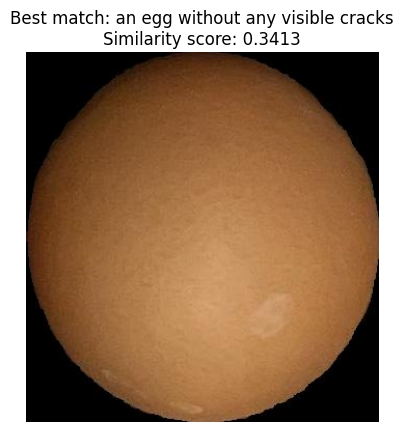

Image: maskegg_4_11.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.326171875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.314208984375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.323974609375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.315673828125
Description: an egg that has a hole, Similarity score: 0.3173828125
Description: an egg with many edge cracks on its skin, Similarity score: 0.336669921875
Description: an egg with a broken shell, Similarity score: 0.30322265625
Description: an egg that is damaged with cracks, Similarity score: 0.326416015625
Description: an egg that is completely intact with no cracks, Similarity score: 0.297607421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.304443359375
Description: an egg without any visible cracks, Similarity score: 0.34130859375
Descri

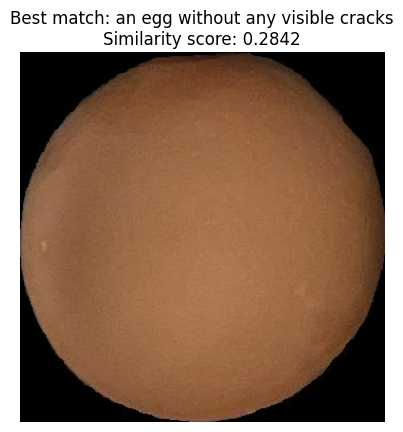

Image: maskegg_4_12.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.269775390625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.25048828125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2685546875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.26611328125
Description: an egg that has a hole, Similarity score: 0.269287109375
Description: an egg with many edge cracks on its skin, Similarity score: 0.2685546875
Description: an egg with a broken shell, Similarity score: 0.26318359375
Description: an egg that is damaged with cracks, Similarity score: 0.25927734375
Description: an egg that is completely intact with no cracks, Similarity score: 0.2449951171875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.25341796875
Description: an egg without any visible cracks, Similarity score: 0.2841796875
Descripti

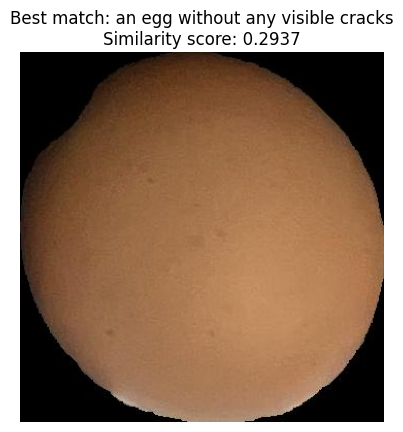

Image: maskegg_4_13.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.270263671875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.259521484375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.271484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.27099609375
Description: an egg that has a hole, Similarity score: 0.265380859375
Description: an egg with many edge cracks on its skin, Similarity score: 0.2822265625
Description: an egg with a broken shell, Similarity score: 0.260009765625
Description: an egg that is damaged with cracks, Similarity score: 0.270751953125
Description: an egg that is completely intact with no cracks, Similarity score: 0.24462890625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.25537109375
Description: an egg without any visible cracks, Similarity score: 0.293701171875
Descrip

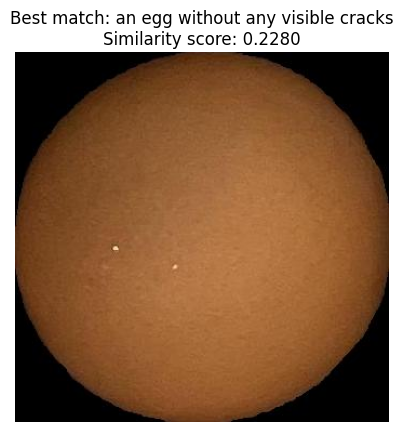

Image: maskegg_4_14.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.209716796875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.191650390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2115478515625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2080078125
Description: an egg that has a hole, Similarity score: 0.213134765625
Description: an egg with many edge cracks on its skin, Similarity score: 0.2198486328125
Description: an egg with a broken shell, Similarity score: 0.1898193359375
Description: an egg that is damaged with cracks, Similarity score: 0.201904296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.176025390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.192138671875
Description: an egg without any visible cracks, Similarity score: 0.22802734375

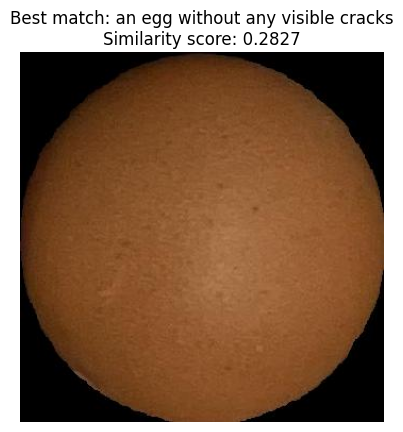

Image: maskegg_4_15.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.26318359375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.24609375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.26513671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2578125
Description: an egg that has a hole, Similarity score: 0.262939453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.274658203125
Description: an egg with a broken shell, Similarity score: 0.2451171875
Description: an egg that is damaged with cracks, Similarity score: 0.262939453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.235595703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2457275390625
Description: an egg without any visible cracks, Similarity score: 0.28271484375
Description:

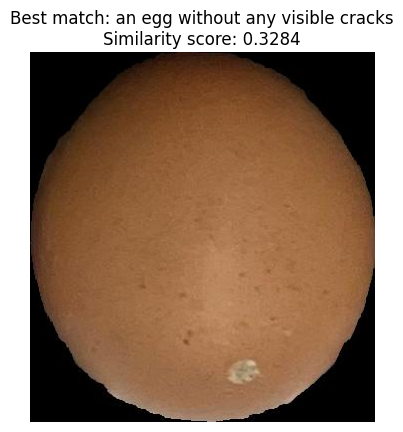

Image: maskegg_4_16.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.30517578125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.29638671875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.305908203125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.307861328125
Description: an egg that has a hole, Similarity score: 0.309814453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.32568359375
Description: an egg with a broken shell, Similarity score: 0.302734375
Description: an egg that is damaged with cracks, Similarity score: 0.3154296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.283203125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.291748046875
Description: an egg without any visible cracks, Similarity score: 0.328369140625
Descriptio

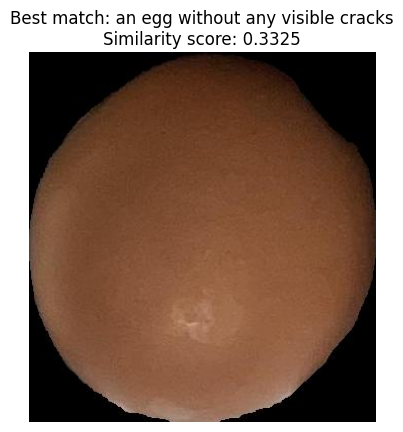

Image: maskegg_4_17.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.31103515625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.30029296875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.309814453125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.304443359375
Description: an egg that has a hole, Similarity score: 0.311279296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.32373046875
Description: an egg with a broken shell, Similarity score: 0.299072265625
Description: an egg that is damaged with cracks, Similarity score: 0.31201171875
Description: an egg that is completely intact with no cracks, Similarity score: 0.288330078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.296142578125
Description: an egg without any visible cracks, Similarity score: 0.33251953125
Desc

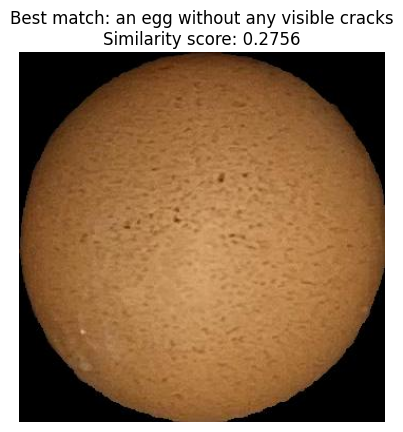

Image: maskegg_4_18.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.24755859375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.231689453125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.253662109375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.24951171875
Description: an egg that has a hole, Similarity score: 0.2470703125
Description: an egg with many edge cracks on its skin, Similarity score: 0.26611328125
Description: an egg with a broken shell, Similarity score: 0.2318115234375
Description: an egg that is damaged with cracks, Similarity score: 0.260986328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2188720703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2318115234375
Description: an egg without any visible cracks, Similarity score: 0.275634765625
D

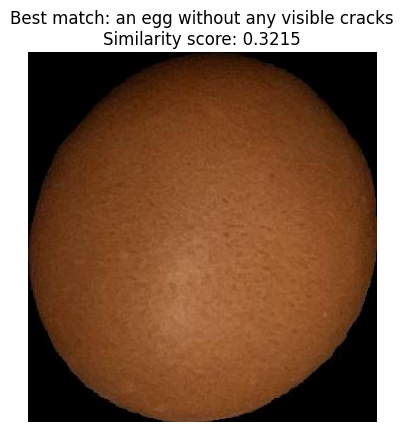

Image: maskegg_4_19.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.303955078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28857421875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.307861328125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.294677734375
Description: an egg that has a hole, Similarity score: 0.302734375
Description: an egg with many edge cracks on its skin, Similarity score: 0.31884765625
Description: an egg with a broken shell, Similarity score: 0.28466796875
Description: an egg that is damaged with cracks, Similarity score: 0.306640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.272705078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.281494140625
Description: an egg without any visible cracks, Similarity score: 0.321533203125
Descript

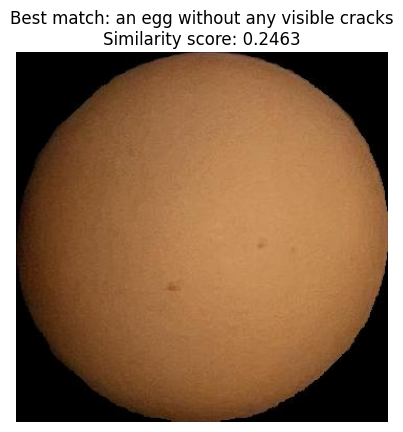

Image: maskegg_4_2.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2274169921875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.206787109375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2259521484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2205810546875
Description: an egg that has a hole, Similarity score: 0.221435546875
Description: an egg with many edge cracks on its skin, Similarity score: 0.2366943359375
Description: an egg with a broken shell, Similarity score: 0.1995849609375
Description: an egg that is damaged with cracks, Similarity score: 0.2159423828125
Description: an egg that is completely intact with no cracks, Similarity score: 0.19140625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2071533203125
Description: an egg without any visible cracks, Similarity score: 0.2463378906

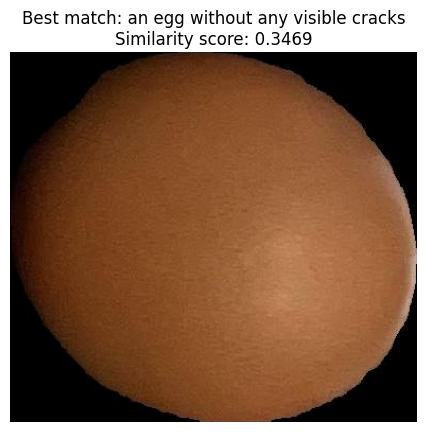

Image: maskegg_4_21.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.330078125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.317626953125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.32861328125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.32177734375
Description: an egg that has a hole, Similarity score: 0.325439453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.33984375
Description: an egg with a broken shell, Similarity score: 0.31298828125
Description: an egg that is damaged with cracks, Similarity score: 0.321533203125
Description: an egg that is completely intact with no cracks, Similarity score: 0.297607421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.310546875
Description: an egg without any visible cracks, Similarity score: 0.346923828125
Description:

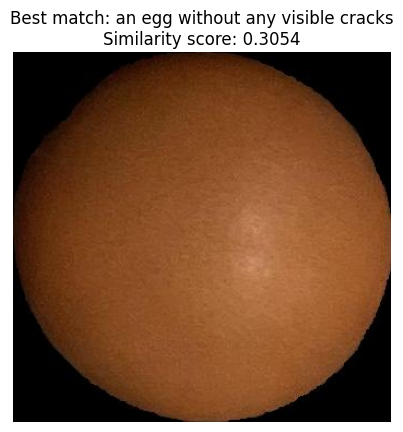

Image: maskegg_4_23.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.290771484375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.274658203125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2822265625
Description: an egg that has a hole, Similarity score: 0.2861328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.29833984375
Description: an egg with a broken shell, Similarity score: 0.27001953125
Description: an egg that is damaged with cracks, Similarity score: 0.279296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.26220703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.272705078125
Description: an egg without any visible cracks, Similarity score: 0.305419921875
Description: a

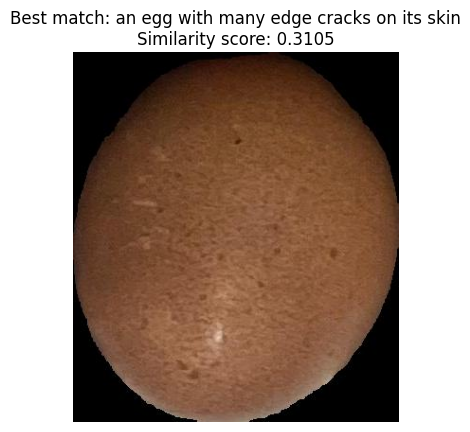

Image: maskegg_4_26.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.286376953125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2744140625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.28955078125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.285400390625
Description: an egg that has a hole, Similarity score: 0.2861328125
Description: an egg with many edge cracks on its skin, Similarity score: 0.310546875
Description: an egg with a broken shell, Similarity score: 0.273681640625
Description: an egg that is damaged with cracks, Similarity score: 0.296630859375
Description: an egg that is completely intact with no cracks, Similarity score: 0.258544921875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.273681640625
Description: an egg without any visible cracks, Similarity score: 0.30859375
Description

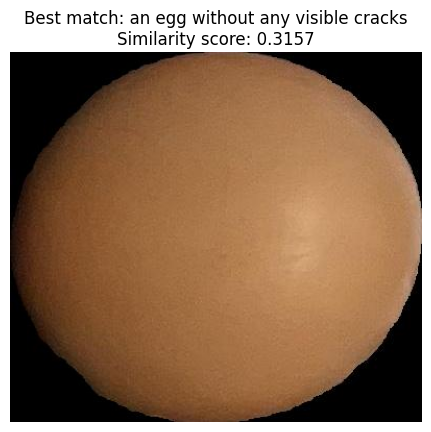

Image: maskegg_4_3.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.299072265625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.28759765625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.29736328125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.295166015625
Description: an egg that has a hole, Similarity score: 0.28564453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.30517578125
Description: an egg with a broken shell, Similarity score: 0.281005859375
Description: an egg that is damaged with cracks, Similarity score: 0.29248046875
Description: an egg that is completely intact with no cracks, Similarity score: 0.275390625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.284912109375
Description: an egg without any visible cracks, Similarity score: 0.315673828125
Descript

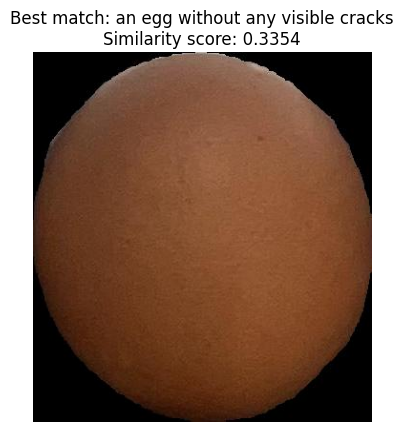

Image: maskegg_4_4.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.32373046875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.310546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.320068359375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.3134765625
Description: an egg that has a hole, Similarity score: 0.31689453125
Description: an egg with many edge cracks on its skin, Similarity score: 0.326904296875
Description: an egg with a broken shell, Similarity score: 0.304443359375
Description: an egg that is damaged with cracks, Similarity score: 0.318115234375
Description: an egg that is completely intact with no cracks, Similarity score: 0.295166015625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.304443359375
Description: an egg without any visible cracks, Similarity score: 0.33544921875
Descript

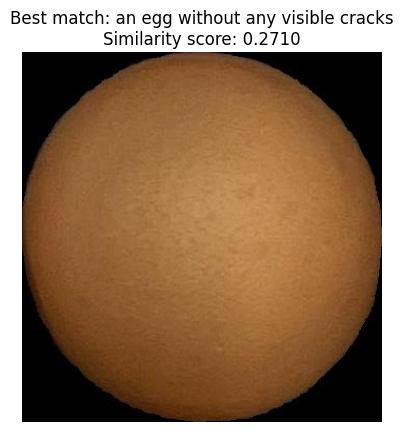

Image: maskegg_4_5.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.24365234375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.22216796875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.2496337890625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.2432861328125
Description: an egg that has a hole, Similarity score: 0.2452392578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.26611328125
Description: an egg with a broken shell, Similarity score: 0.2269287109375
Description: an egg that is damaged with cracks, Similarity score: 0.254150390625
Description: an egg that is completely intact with no cracks, Similarity score: 0.2156982421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2252197265625
Description: an egg without any visible cracks, Similarity score: 0.2709960937

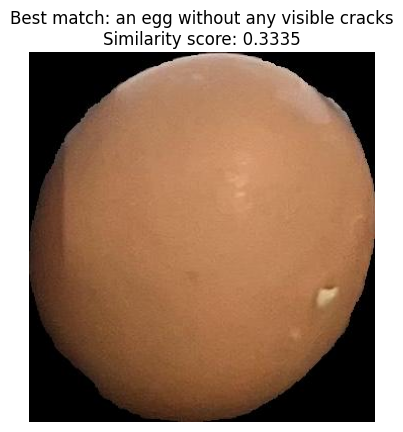

Image: maskegg_4_6.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.315673828125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.30615234375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.313232421875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.31494140625
Description: an egg that has a hole, Similarity score: 0.319091796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.329345703125
Description: an egg with a broken shell, Similarity score: 0.314453125
Description: an egg that is damaged with cracks, Similarity score: 0.3212890625
Description: an egg that is completely intact with no cracks, Similarity score: 0.295166015625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.309326171875
Description: an egg without any visible cracks, Similarity score: 0.33349609375
Descript

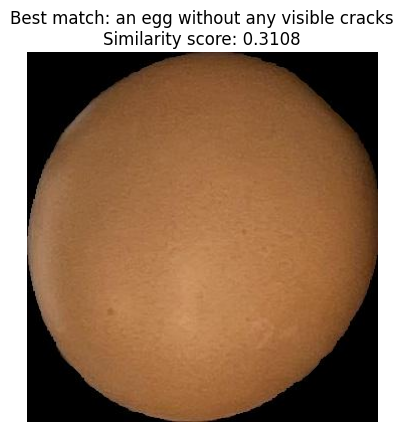

Image: maskegg_4_7.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.296142578125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.279052734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.295654296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.288330078125
Description: an egg that has a hole, Similarity score: 0.287841796875
Description: an egg with many edge cracks on its skin, Similarity score: 0.303955078125
Description: an egg with a broken shell, Similarity score: 0.273193359375
Description: an egg that is damaged with cracks, Similarity score: 0.292724609375
Description: an egg that is completely intact with no cracks, Similarity score: 0.25830078125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.270751953125
Description: an egg without any visible cracks, Similarity score: 0.310791015625
D

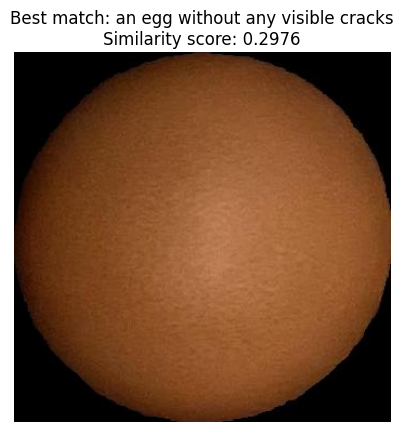

Image: maskegg_4_8.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.28076171875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.260986328125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.281005859375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.27197265625
Description: an egg that has a hole, Similarity score: 0.278076171875
Description: an egg with many edge cracks on its skin, Similarity score: 0.294189453125
Description: an egg with a broken shell, Similarity score: 0.258544921875
Description: an egg that is damaged with cracks, Similarity score: 0.280029296875
Description: an egg that is completely intact with no cracks, Similarity score: 0.2490234375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.25830078125
Description: an egg without any visible cracks, Similarity score: 0.297607421875
Descr

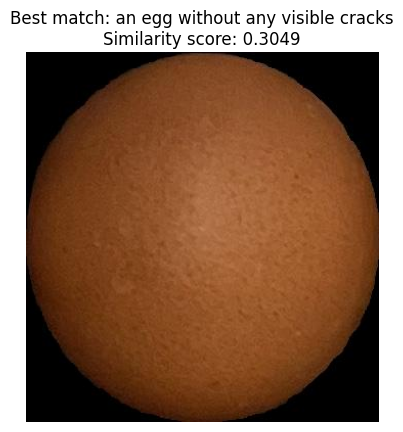

Image: maskegg_5_0.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.2861328125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.26953125
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.286376953125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.27392578125
Description: an egg that has a hole, Similarity score: 0.283935546875
Description: an egg with many edge cracks on its skin, Similarity score: 0.298583984375
Description: an egg with a broken shell, Similarity score: 0.263427734375
Description: an egg that is damaged with cracks, Similarity score: 0.2861328125
Description: an egg that is completely intact with no cracks, Similarity score: 0.261474609375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2666015625
Description: an egg without any visible cracks, Similarity score: 0.304931640625
Description

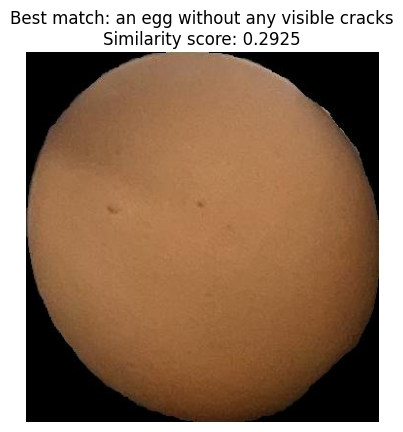

Image: maskegg_5_1.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.273681640625
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.26025390625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.271484375
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.267578125
Description: an egg that has a hole, Similarity score: 0.267578125
Description: an egg with many edge cracks on its skin, Similarity score: 0.284912109375
Description: an egg with a broken shell, Similarity score: 0.2496337890625
Description: an egg that is damaged with cracks, Similarity score: 0.270751953125
Description: an egg that is completely intact with no cracks, Similarity score: 0.23779296875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2509765625
Description: an egg without any visible cracks, Similarity score: 0.29248046875
Description: 

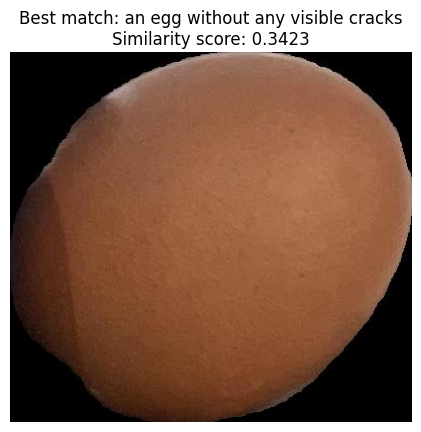

Image: maskegg_5_2.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.333984375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.322021484375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.3291015625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.322509765625
Description: an egg that has a hole, Similarity score: 0.326904296875
Description: an egg with many edge cracks on its skin, Similarity score: 0.336669921875
Description: an egg with a broken shell, Similarity score: 0.31640625
Description: an egg that is damaged with cracks, Similarity score: 0.320556640625
Description: an egg that is completely intact with no cracks, Similarity score: 0.306884765625
Description: an egg with a perfect, uncracked shell, Similarity score: 0.31201171875
Description: an egg without any visible cracks, Similarity score: 0.34228515625
Description

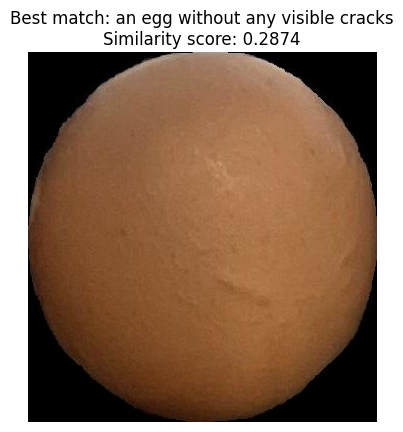

Image: maskegg_5_3.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.276611328125
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.265625
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.27197265625
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.268798828125
Description: an egg that has a hole, Similarity score: 0.26123046875
Description: an egg with many edge cracks on its skin, Similarity score: 0.277099609375
Description: an egg with a broken shell, Similarity score: 0.259033203125
Description: an egg that is damaged with cracks, Similarity score: 0.268310546875
Description: an egg that is completely intact with no cracks, Similarity score: 0.250732421875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.25732421875
Description: an egg without any visible cracks, Similarity score: 0.287353515625
Descripti

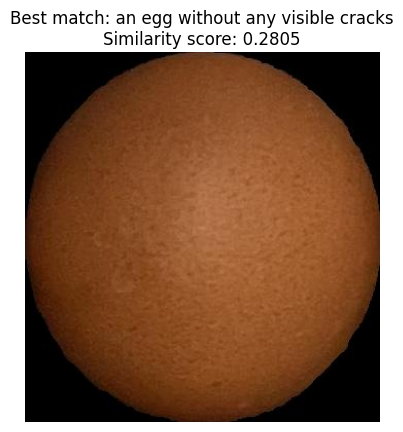

Image: maskegg_8880_1zzz.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.261474609375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2440185546875
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.264404296875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.254638671875
Description: an egg that has a hole, Similarity score: 0.258056640625
Description: an egg with many edge cracks on its skin, Similarity score: 0.276123046875
Description: an egg with a broken shell, Similarity score: 0.2391357421875
Description: an egg that is damaged with cracks, Similarity score: 0.262939453125
Description: an egg that is completely intact with no cracks, Similarity score: 0.2298583984375
Description: an egg with a perfect, uncracked shell, Similarity score: 0.2410888671875
Description: an egg without any visible cracks, Similarity score: 0.280

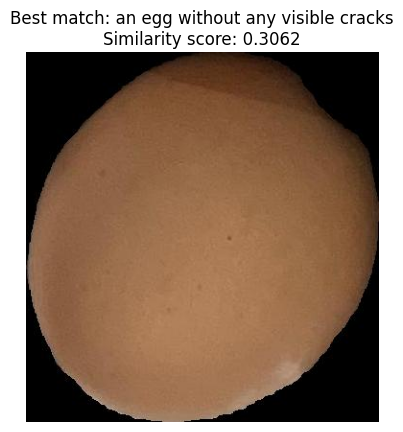

Image: maskegg_9991_12.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.286865234375
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.27734375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.285888671875
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.285888671875
Description: an egg that has a hole, Similarity score: 0.282958984375
Description: an egg with many edge cracks on its skin, Similarity score: 0.290771484375
Description: an egg with a broken shell, Similarity score: 0.27685546875
Description: an egg that is damaged with cracks, Similarity score: 0.2802734375
Description: an egg that is completely intact with no cracks, Similarity score: 0.26513671875
Description: an egg with a perfect, uncracked shell, Similarity score: 0.27294921875
Description: an egg without any visible cracks, Similarity score: 0.30615234375
Descri

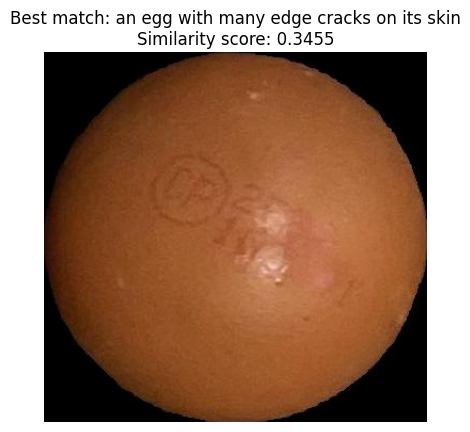

Image: maskegg_0_1.jpg
Description: an egg that has a visible crack like a thin line, Similarity score: 0.310546875
Description: an egg with a clearly cracked shell that looks like a thin line, Similarity score: 0.2958984375
Description: an egg that is visibly cracked with a thin line, Similarity score: 0.31298828125
Description: an egg with an obvious thin line crack in its shell, Similarity score: 0.304931640625
Description: an egg that has a hole, Similarity score: 0.306640625
Description: an egg with many edge cracks on its skin, Similarity score: 0.345458984375
Description: an egg with a broken shell, Similarity score: 0.303955078125
Description: an egg that is damaged with cracks, Similarity score: 0.335205078125
Description: an egg that is completely intact with no cracks, Similarity score: 0.282470703125
Description: an egg with a perfect, uncracked shell, Similarity score: 0.295654296875
Description: an egg without any visible cracks, Similarity score: 0.32861328125
Descriptio

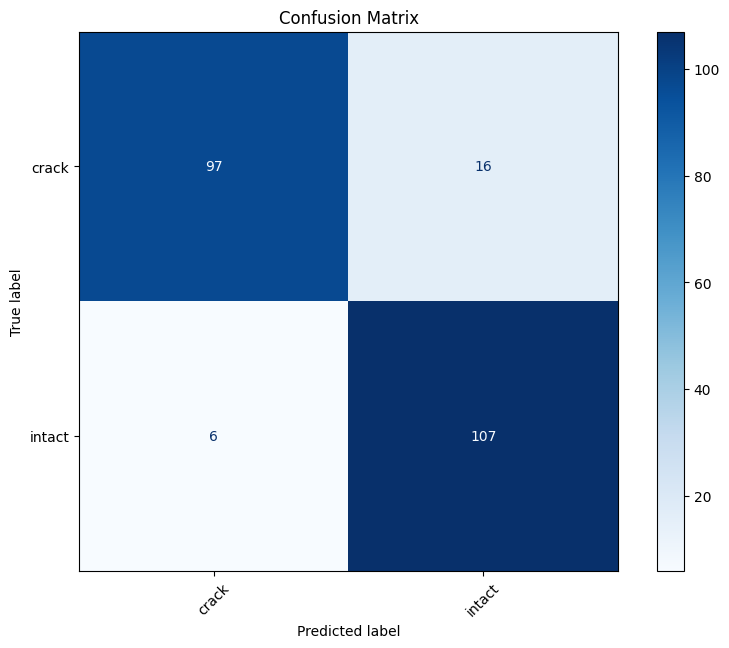


Classification Report:

              precision    recall  f1-score   support

       crack       0.94      0.86      0.90       113
      intact       0.87      0.95      0.91       113

    accuracy                           0.90       226
   macro avg       0.91      0.90      0.90       226
weighted avg       0.91      0.90      0.90       226


Accuracy: 0.9027
Precision: 0.9058
Recall: 0.9027
F1 Score: 0.9025


In [ ]:
import torch
import clip
from PIL import Image
import os
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score, precision_score, recall_score, f1_score

# Check if CUDA is available and use it, otherwise use CPU
device = "cuda" if torch.cuda.is_available() else "cpu"

# Load the CLIP model
clip_model, preprocess = clip.load("ViT-B/16", device=device)

# Define more descriptive text descriptions with balanced variations
text_descriptions_crack = [
    "an egg that has a visible crack like a thin line",
    "an egg with a clearly cracked shell that looks like a thin line",
    "an egg that is visibly cracked with a thin line",
    "an egg with an obvious thin line crack in its shell",
    "an egg that has a hole",
    "an egg with many edge cracks on its skin",
    "an egg with a broken shell",
    "an egg that is damaged with cracks"
]

text_descriptions_intact = [
    "an egg that is completely intact with no cracks",
    "an egg with a perfect, uncracked shell",
    "an egg without any visible cracks",
    "an egg that is fully intact with no cracks",
    "an egg with a smooth and undamaged shell",
    "an egg that is in perfect condition",
    "an egg without any damage",
    "an egg with a flawless shell"
]

text_descriptions = text_descriptions_crack + text_descriptions_intact

# Encode text descriptions
text_inputs = clip.tokenize(text_descriptions).to(device)

# Function to load and preprocess a single image
def preprocess_image(image_path):
    image = preprocess(Image.open(image_path)).unsqueeze(0).to(device)
    return image

# Define test directories
test_dirs = {
    "crack": "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/crack/",
    "intact": "/content/drive/My Drive/Journal_IJCAS/Egg/dataset/test255/intact/"
}

# Lists to store true labels and predicted labels
true_labels = []
predicted_labels = []

# Iterate through all images in both directories
for label, directory in test_dirs.items():
    for filename in os.listdir(directory):
        if filename.endswith((".png", ".jpg", ".jpeg")):
            image_path = os.path.join(directory, filename)

            # Load and preprocess the test image
            test_image = preprocess_image(image_path)

            # Encode the image and text descriptions
            with torch.no_grad():
                image_features = clip_model.encode_image(test_image)
                text_features = clip_model.encode_text(text_inputs)

            # Compute the similarity between the image and text embeddings
            image_features /= image_features.norm(dim=-1, keepdim=True)
            text_features /= text_features.norm(dim=-1, keepdim=True)
            similarity = (image_features @ text_features.T).cpu().numpy()

            # Determine the text description with the highest similarity score
            best_match_idx = similarity.argmax()
            best_match_text = text_descriptions[best_match_idx]
            similarity_score = similarity[0][best_match_idx]

            # Append true and predicted labels
            true_labels.append(label)
            predicted_labels.append("crack" if best_match_text in text_descriptions_crack else "intact")

            # Display the image and the best match description
            image = Image.open(image_path)
            plt.imshow(image)
            plt.title(f"Best match: {best_match_text}\nSimilarity score: {similarity_score:.4f}")
            plt.axis('off')
            plt.show()

            # Print the similarity scores for all descriptions
            print(f"Image: {filename}")
            for i, description in enumerate(text_descriptions):
                print(f"Description: {description}, Similarity score: {similarity[0][i]}")
            print("\n")  # Add a new line for readability between image results

# Convert labels to numpy arrays
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Compute confusion matrix
cm = confusion_matrix(true_labels, predicted_labels, labels=["crack", "intact"])
cm_display = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["crack", "intact"])

# Plot confusion matrix
fig, ax = plt.subplots(figsize=(10, 7))
cm_display.plot(ax=ax, cmap="Blues", xticks_rotation=45)
plt.title("Confusion Matrix")
plt.show()

# Print classification report
print("\nClassification Report:\n")
print(classification_report(true_labels, predicted_labels, target_names=["crack", "intact"], zero_division=0))

# Calculate and print additional metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, average='weighted', zero_division=0)
recall = recall_score(true_labels, predicted_labels, average='weighted')
f1 = f1_score(true_labels, predicted_labels, average='weighted')

print(f"\nAccuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
